In [1]:
import os 
import sys

# general data analysis
import numpy as np
import pandas as pd
import scrublet as scr
import igraph as ig
from matplotlib.pyplot import rc_context
import matplotlib.pyplot as plt

# single cell
import scanpy as sc
import anndata as ad

In [4]:
# path
os.listdir('.') # current directory

['python_tutorials.ipynb',
 'Untitled.ipynb',
 'Python_tutorial1.ipynb',
 'scanpy_invivo.ipynb',
 '.ipynb_checkpoints',
 'numpy_pandas.ipynb']

In [5]:
# mv means move

# pwd : current working directory
print(os.getcwd())

/rds/user/bb725/hpc-work/Python_tutorial


In [6]:
# absolute / relative path to data
os.listdir('/home/bb725/rds/hpc-work/data/')

['tom_pos.h5ad']

# introducing data path , abs path and relative path

## abs path 

full directory + file name

The benefit is clear and you can access the file from anywhere

In [7]:
# full data path :
data_path = "/rds/user/bb725/hpc-work/data/tom_pos.h5ad" #make the path as a string because it is a file path
# read in data

# check file exists
if os.path.exists(data_path):
    adata = sc.read_h5ad(data_path)
    
else:
    print("File not found:", data_path)
    


In [8]:
print(adata)

AnnData object with n_obs × n_vars = 49390 × 4814
    obs: 'n_genes', 'n_counts', 'mt_count', 'mt_frac', 'doublet_scores', 'predicted_doublets', 'xist_logn', 'Ygene_logn', 'xist_bin', 'Ygene_bin', 'sex_adata', 'biosample_id', 'cellid', 'RBG', 'SLXid', 'index', '10xsample_description', 'sex_mixed', 'sex_meta', 'mouse_id', 'sortedcells', 'expected_cells_10x', 'cellranger_cellsfound', 'chemistry', 'tom', 'expdate', 'batch', 'timepoint_tx_days', 'start_age', 'sample_id', 'countfile', 'S_score', 'G2M_score', 'phase', 'leiden', 'SLX', 'plate_sorted', 'plate_rearranged', 'well_sorted', 'well_rearranged', 'set_index', 'CI_index', 'mouse_platelabel', 'sort_method', 'sample.name', 'population', 'sex', 'countfolder', 'batch_plate_sorted', 'data_type', 'sex_combined', 'longname', 'anno_man', 'leiden_DM', 'HSCscore', 'nn_HSCscore', 'isroot', 'dpt_pseudotime', 'leiden_orig', 'logk', 'net_prolif', 'log10SR', 'log_density_at_E3', 'log_density_at_E7', 'log_density_at_E12', 'log_density_at_E12_clip', 'l

## relative path

In [9]:
# set data directory
data_dir = "/rds/user/bb725/hpc-work/data"

# check current directory
print("Current working directory:", os.getcwd())

# change the working directory
os.chdir(data_dir)

Current working directory: /rds/user/bb725/hpc-work/Python_tutorial


In [10]:
print("Current working directory:", os.getcwd())

Current working directory: /rds/user/bb725/hpc-work/data


1. Importing the data

In [11]:
# relative path, you can access the file by just its name
adata = sc.read_h5ad('tom_pos.h5ad')
adata
#Following the tutorial, now we can move on to Quality Control

#New definition of raw data
#adata = clean_data.raw.to_adata()

# Check if raw data exists in your current adata object
if adata.raw is not None:
    raw_adata = adata.raw.to_adata()
    # Now you can use raw_adata for your analysis
    print("Successfully extracted raw data. New dimensions:", raw_adata.shape)
else:
    print("Warning: No raw data found in the AnnData object.")
    # The main data (adata.X) might already contain raw counts
    if np.issubdtype(adata.X.dtype, np.integer):
        print("Note: adata.X appears to contain integer values, suggesting it might already be raw count data.")
adata = raw_adata

Successfully extracted raw data. New dimensions: (49390, 22035)


2. Quality Control

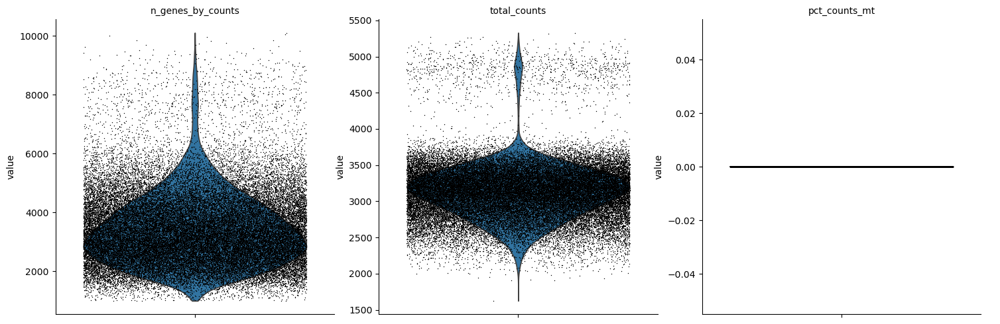

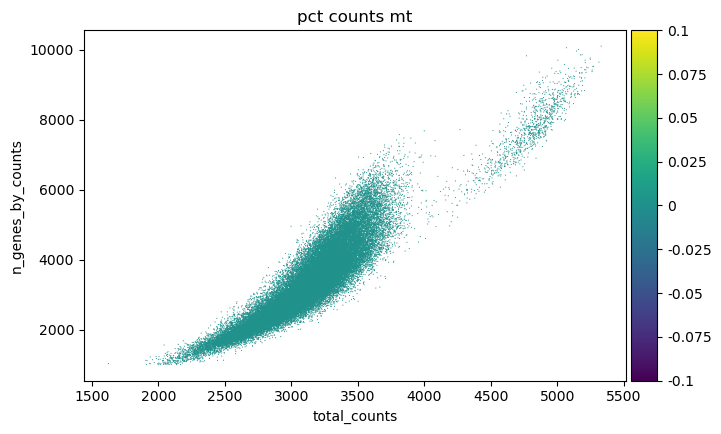

In [12]:
#Functions we are using:
#sc.pp.calculate_gc_metrics()

#Will want to separate for mitochondrial (mt), ribosomal (ribo) and hemoglobin (hb) genes

#mt genes, here we have mouse, so "Mt-" (if were human, we would use "MT-")
adata.var["mt"] = adata.var_names.str.startswith("Mt-")
#ribo genes
adata.var["ribo"] = adata.var_names.str.startswith(("Rpl", "Rps"))
#hb genes
adata.var["hb"] = adata.var_names.str.startswith("Hb[^(P)]")

#sc.pp.calculate_gc_metrics() for each of the above
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt", "ribo", "hb"], inplace=True, log1p=True)

#Now inspect the data using violin plots
sc.pl.violin(
    adata,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
)

#Now inspect using scatterplots
sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt")

In [13]:
#Now based on QC results, we can filter cells
# Ex. filter less than 100 genes and genes that are detected in less than 3 cells
sc.pp.filter_cells(adata, min_genes=100)
sc.pp.filter_genes(adata, min_cells=3)

3. Doublet detection

In [14]:
#Next need to run a doublet detection algorithm
#Identifying doublets is important because they can lead to misclassification / distortion of cell populations in downstream analyses.
#Scanpy uses scrublet for doublet detection
#Scrublet predicts doublets using nearest neighbor approach classifier of observed transcriptomes and simulated doublets
sc.external.pp.scrublet(adata, batch_key="batch")

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/sklearn/utils/deprecation.py:95: FutureWarning: Function scrublet is deprecated; Import from sc.pp instead
  warnings.warn(msg, category=FutureWarning)
/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/preprocessing/_scrublet/__init__.py:272: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  scrubbed_obs = pd.concat([scrub["obs"] for scrub in scrubbed])
/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/preprocessing/_scrublet/__init__.py:272: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude em

4. Normalization

In [15]:
#Next data must be normalized - common approach is count depth scaling with subsequent log plus one (log1p) transformation - this normalizes dtaa to a "size factor"
#Here we are applying median count depth normalization with log1p transformation (AKA log1PF)
adata.layers["counts"] = adata.X.copy()
sc.pp.normalize_total (adata)
sc.pp.log1p(adata)

5. Feature selection

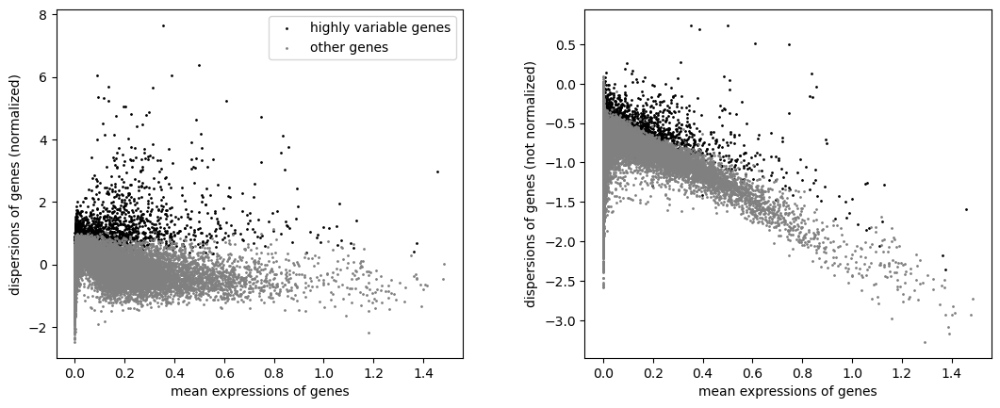

In [16]:
#Next reduce dimensionality of the dataset and only inlcude most informative genes - also known as feature selection.
#Scanpy funcition pp.highly._variable_genes annotates highly variable genes by reproducing implementation of Seurat, Cell Ranger, and Seurat v3 depending on chosen "flavor"
sc.pp.highly_variable_genes (adata, n_top_genes=2000, batch_key="batch")

#Scatter plot
sc.pl.highly_variable_genes(adata)

6. Dimensionality reduction

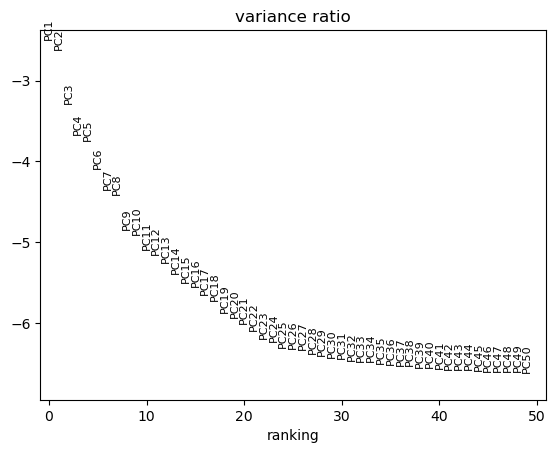

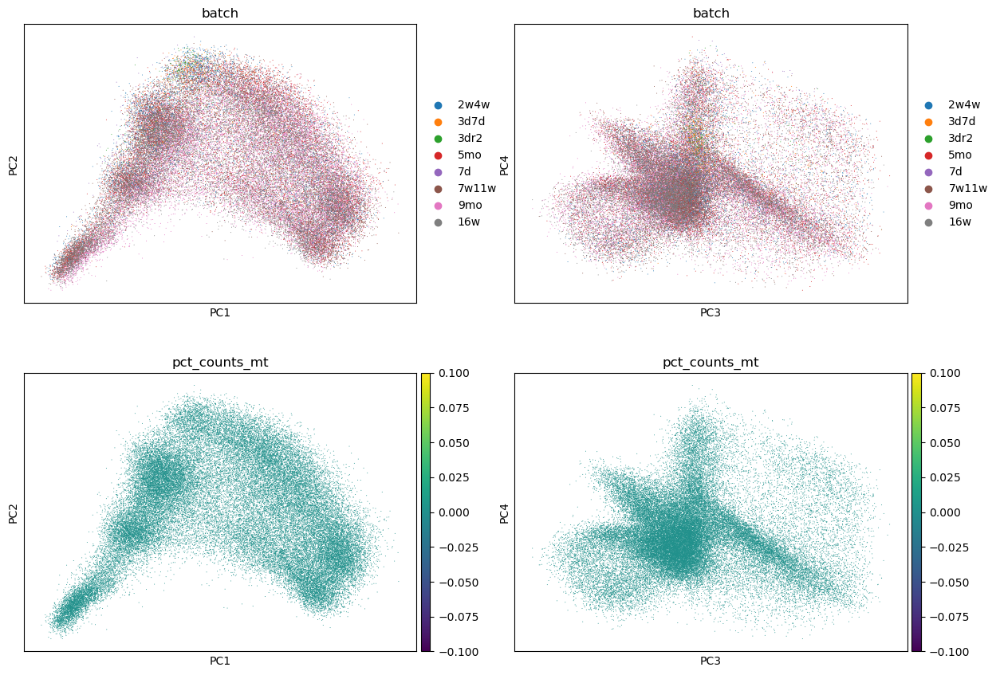

In [17]:
#Dimensionality reduction using PCA which reveals main axes of variation and denoises the data
sc.tl.pca(adata)

#Inspect contributions of single PCs to total variance in data - gives info how many PCs we should consider to compute neighbourhood relations of cells
sc.pl.pca_variance_ratio(adata, n_pcs=50, log=True)

#Can also plot principal component to see if there are any undesired features (Batch, QC metrics) driving significant variation in dataset
sc.pl.pca(
    adata,
    color=["batch", "batch", "pct_counts_mt", "pct_counts_mt"],
    dimensions=[(0, 1), (2, 3), (0, 1), (2, 3)],
    ncols=2,
    size=2,
)

7. Nearest neighbour graph construction and visualization

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


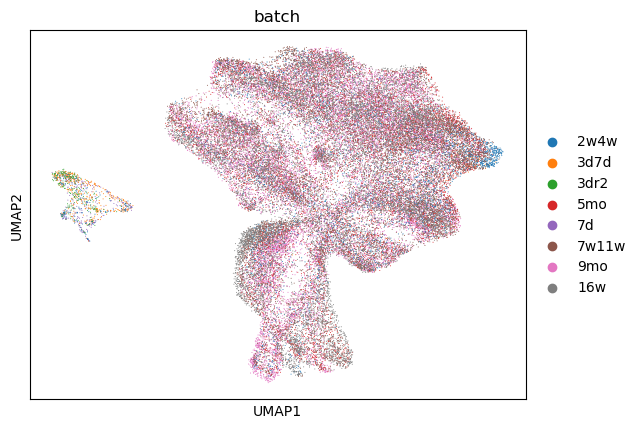

In [18]:
#Compute the neighbourhood graph of cells using PCA representation of the data matrix
sc.pp.neighbors(adata)

#This graph can be embedded in two dimensions for visualisation using UMAP
sc.tl.umap(adata)

#Visualiza UMAP according to the batch
sc.pl.umap(
    adata,
    color="batch",
    size=2, #here we set size of the points
)

8. Clusterring

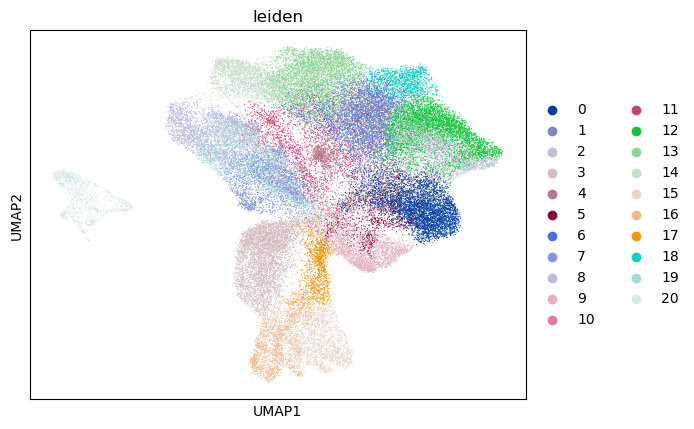

In [19]:
#Graph clustering method, here Leiden (community detection based on optimizing modularity). Leiden clusterring directly clusters neighborhood graph of cells which we already computed in previous section
#Using igraph implementation and fixed number of iterations can be significantly faster especially for larger datasets
sc.tl.leiden(adata, flavor="igraph", n_iterations=2)
sc.pl.umap(adata, color=["leiden"])

9. Re-assess quality control and cell filtering

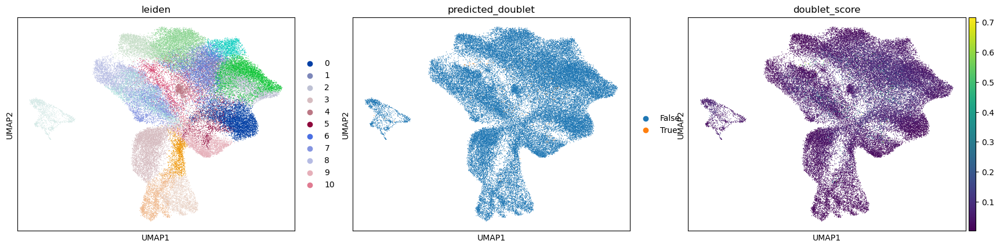

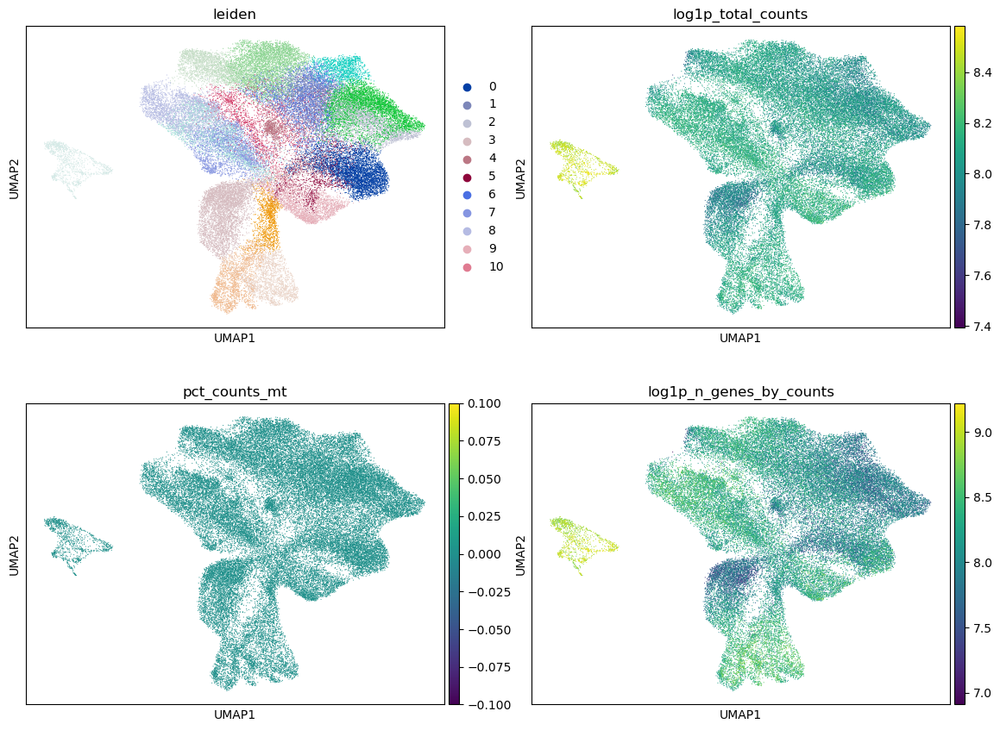

In [20]:
#Re-assess filtering strategy by visualizing different QC metrics using UMAP
sc.pl.umap(
    adata,
    color=["leiden", "predicted_doublet", "doublet_score"],
    #increase horizontal space between panels
    wspace=0.1,
    size=3,
)

sc.pl.umap(
    adata,
    color=["leiden", "log1p_total_counts", "pct_counts_mt", "log1p_n_genes_by_counts"],
    wspace=0.1,
    ncols=2,
)

10. Manual cell type annotation

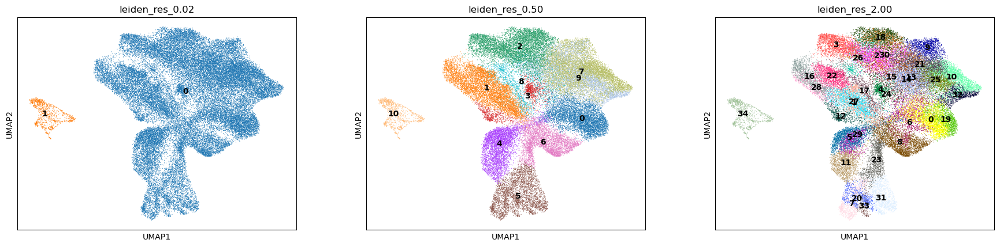

In [21]:
#Cell type annotation is laborous
#Now we have filtered cells of decent quality and can procede with their annotation as cell types which is known by using genes tat are exclusiveley expressed by given cell type (marker genes)
#Use Leiden clustering algorithm which extracts cell communities form nearest neighbours graph
for res in [0.02, 0.5, 2.0]:
    sc.tl.leiden(adata, key_added=f"leiden_res_{res:4.2f}", resolution=res, flavor="igraph")

#Number of clusters that we define is arbitrary and so is the resolution parameter. Number of clusters is bound to stable and biologically-meaningful groups typically done by experts in corresponding field or using exper-proved prior knowledge in form of marker genes
sc.pl.umap(
    adata,
    color=["leiden_res_0.02", "leiden_res_0.50", "leiden_res_2.00"],
    legend_loc="on data",
)


11. Marker gene set

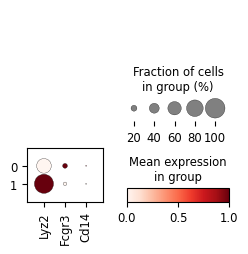

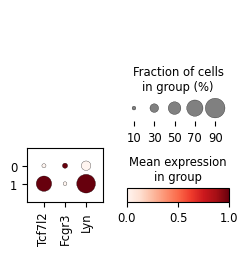

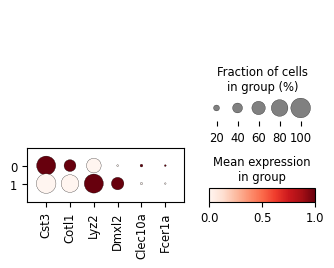

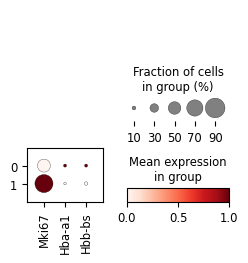

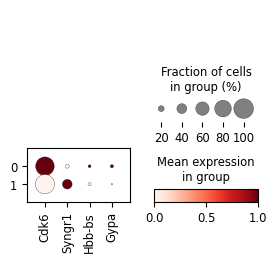

...

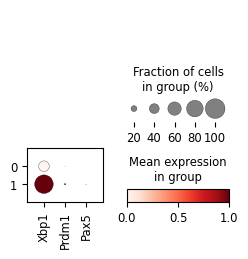

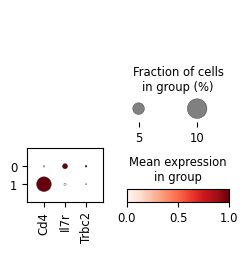

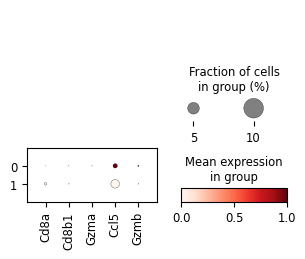

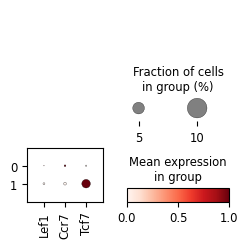

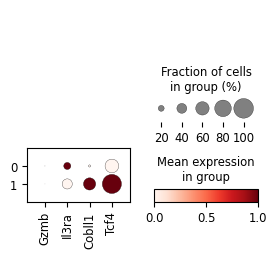

In [22]:
#Need to define a set of marker genes for main cell types that we expect to see in the dataset. Here taken from Single Cell Best Practices annotation chapter https://www.sc-best-practices.org/cellular_structure/annotation.html

marker_genes_mouse = {
    # Monocytes
    "CD14+ Mono": ["Lyz2", "Fcgr3", "Cd14"],
    "CD16+ Mono": ["Tcf7l2", "Fcgr3", "Lyn"],

    # Conventional dendritic cells (cDC2)
    # Note: Fcer1a and Clec10a are conserved
    "cDC2": ["Cst3", "Cotl1", "Lyz2", "Dmxl2", "Clec10a", "Fcer1a"],

    # Erythroid lineage
    "Erythroblast": ["Mki67", "Hba-a1", "Hbb-bs"],
    "Proerythroblast": ["Cdk6", "Syngr1", "Hbb-bs", "Gypa"],

    # NK cells
    # NOTE: GNLY does NOT exist in mouse
    "NK": ["Nkg7", "Cd247", "Fcer1g", "Tyrobp", "Klrg1", "Fcgr3"],

    # Innate lymphoid cells (ILC)
    # GNLY removed, Syne1 kept
    "ILC": ["Id2", "Plcg2", "Syne1"],

    # B cells
    "Naive B": ["Ms4a1", "Il4r", "Ighd", "Ighm"],
    "B cells": [
        "Ms4a1",
        "Itgb1",
        "Prdm1",
        "Irf4",
        "Pax5",
        "Bcl11a",
        "Blk",
        "Ighd",
        "Ighm",
    ],

    # Plasma lineage
    "Plasma cells": ["Mzb1", "Hsp90b1", "Prdm1", "Igkc", "Jchain"],
    "Plasmablast": ["Xbp1", "Prdm1", "Pax5"],

    # T cells
    "CD4+ T": ["Cd4", "Il7r", "Trbc2"],
    "CD8+ T": ["Cd8a", "Cd8b1", "Gzmk", "Gzma", "Ccl5", "Gzmb", "Gzmh"],

    # Naive T cells
    "T naive": ["Lef1", "Ccr7", "Tcf7"],

    # Plasmacytoid DCs
    "pDC": ["Gzmb", "Il3ra", "Cobll1", "Tcf4"],
}

#Now filter marker genes to only include those present in our dataset
filtered_markers = {}

for celltype, markers in marker_genes_mouse.items():
    for gene in markers:

        # Check if gene is in adata.var_names
        if gene not in adata.var_names:
            print(f"Warning: Gene {gene} for cell type {celltype} not found in adata.var_names")

    # filter existing genes
    found_genes = [gene for gene in markers if gene in adata.var_names]

    # save to dictionary
    filtered_markers[celltype] = found_genes

    # Plot marker gene expression dotplot
    sc.pl.dotplot(adata, found_genes, groupby="leiden_res_0.02", standard_scale="var")

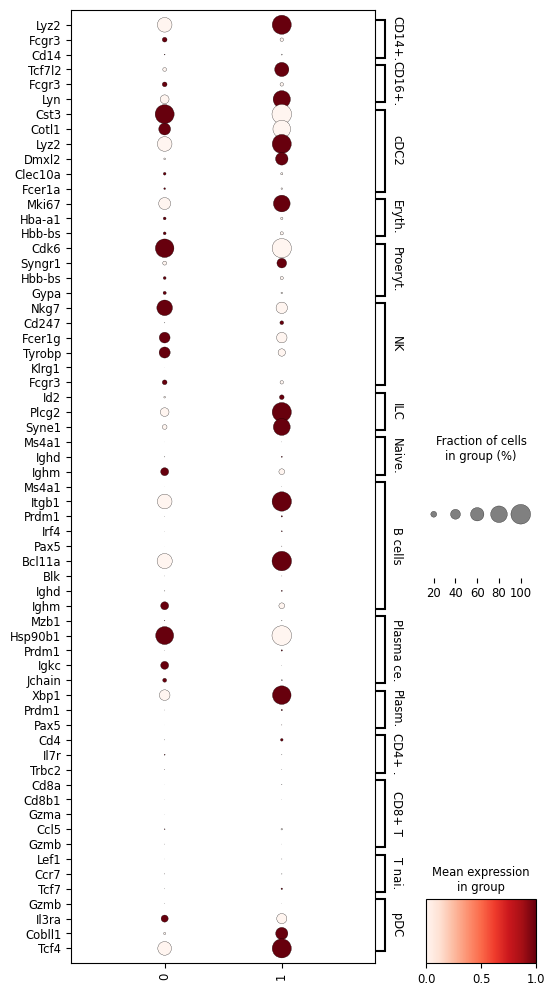

In [23]:

# --- Filter marker genes to only those present ---
filtered_markers = {}

for celltype, markers in marker_genes_mouse.items():
    found_genes = []
    for gene in markers:
        if gene in adata.var_names:
            found_genes.append(gene)
        else:
            print(f"Warning: Gene {gene} for cell type {celltype} not found in adata.var_names")

    # keep only cell types that still have at least 1 gene
    if len(found_genes) > 0:
        filtered_markers[celltype] = found_genes

# --- ONE dotplot for everything (one long panel) ---
sc.pl.dotplot(
    adata,
    filtered_markers,              # <- dictionary gives grouped sections
    groupby="leiden_res_0.02",
    standard_scale="var",
    swap_axes=True,                # <- makes it a long vertical panel (often what people mean)
    figsize=(6, 12)                # <- adjust height if needed
)


In [24]:
adata.var_names #checking gene names in out dataset
adata.obs_names #checking cell names in our dataset

Index(['9mo_SIGAE3_AAACCCAAGACCTCAT-1-10x',
       '9mo_SIGAE3_AAACCCAGTCTCGGGT-1-10x',
       '9mo_SIGAE3_AAACGAAAGACATGCG-1-10x',
       '9mo_SIGAE3_AAACGAAAGAGGTCAC-1-10x',
       '9mo_SIGAE3_AAACGAACAATAGAGT-1-10x',
       '9mo_SIGAE3_AAACGAAGTAACAGGC-1-10x',
       '9mo_SIGAE3_AAACGAAGTCATCCGG-1-10x',
       '9mo_SIGAE3_AAACGAATCTACGGTA-1-10x',
       '9mo_SIGAE3_AAACGCTAGCGTTCAT-1-10x',
       '9mo_SIGAE3_AAACGCTTCCGTGCGA-1-10x',
       ...
       '1275-SS2', '1276-SS2', '1277-SS2', '1279-SS2', '1280-SS2', '1281-SS2',
       '1282-SS2', '1283-SS2', '1285-SS2', '1286-SS2'],
      dtype='object', length=49390)

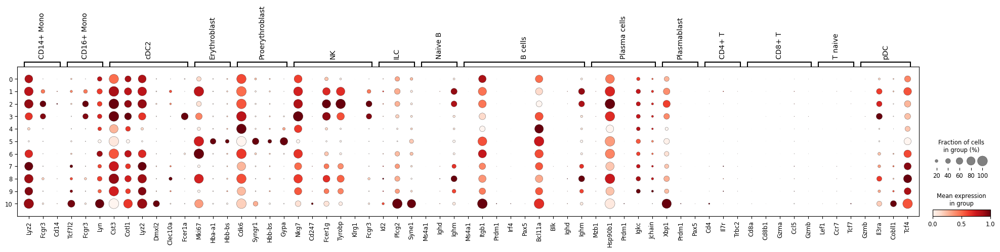

In [25]:
#Label coarsest clustering with broad lineages
adata.obs["cell_type_lvl1"] = adata.obs["leiden_res_0.02"].map(
    {
        "0": "Lymphocytes",
        "1": "Monocytes",
        "2": "Erythroid",
        "3": "B Cells",
    }
)

sc.pl.dotplot(adata, filtered_markers, groupby="leiden_res_0.50", standard_scale="var")

12. Differentially-expressed Genes as Markers

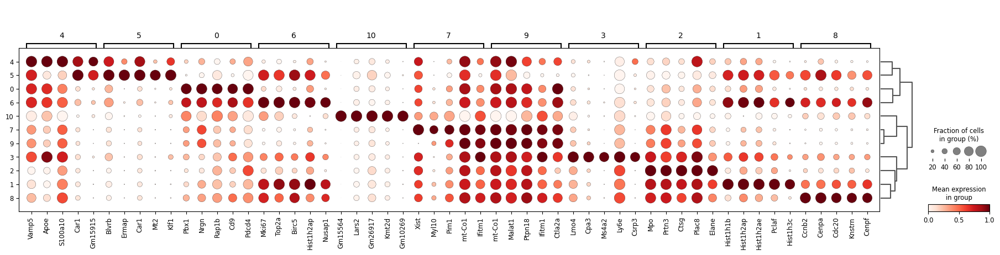

In [26]:
#Can also calculate marker genes per cluster and then look up if we can link those marker genes to any known biology such as cell types/states. This is usually done using simple statistical tests such as Wilcoxon and t-test for each cluster vs the rest
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(adata, groupby="leiden_res_0.50", method="wilcoxon")

#Visualise top 5 DEGs on a dotplot
sc.pl.rank_genes_groups_dotplot(adata, groupby="leiden_res_0.50", standard_scale="var", n_genes=5)

In [27]:
#Can use the genes from last graph to figure out cell types we are looking for. Here are clusters separated based on expression profiles
#To create own plots, DEgs can be extracted in a conevnient format using scanpy.get.rank_genes_groups_df()
sc.get.rank_genes_groups_df(adata, group="7").head(5)

,names,scores,logfoldchanges,pvals,pvals_adj
0,Xist,85.148773,1.328577,0.0,0.0
1,Myl10,84.874283,3.153163,0.0,0.0
2,Pim1,77.215324,1.528980,0.0,0.0
3,mt-Co1,77.103233,0.248816,0.0,0.0
4,Ifitm1,74.665688,1.204093,0.0,0.0


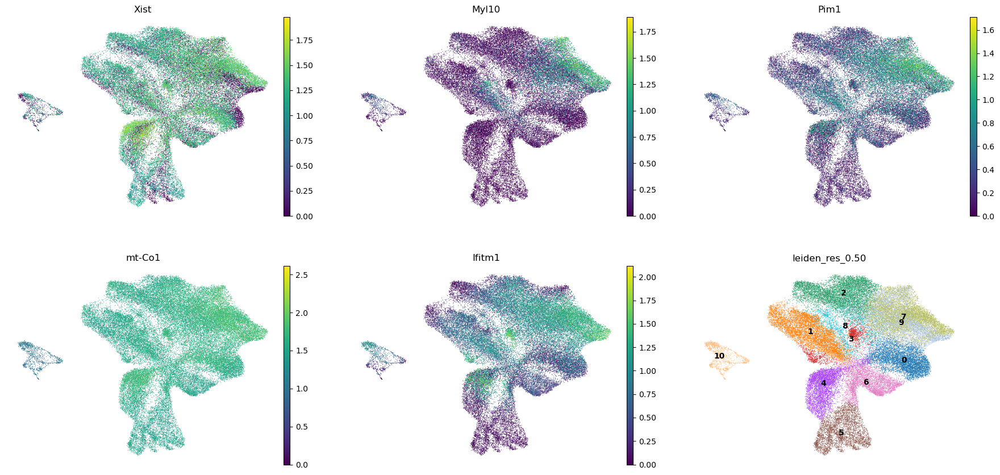

In [28]:
#Create UMAPS based on gene expression data
dc_cluster_genes = sc.get.rank_genes_groups_df(adata, group="7").head(5)["names"]
sc.pl.umap(
    adata,
    color=[*dc_cluster_genes, "leiden_res_0.50"],
    legend_loc="on data",
    frameon=False,
    ncols=3,
)

## Plotting - Core plotting functions

1. Scatter plots and embeddings (UMAP, t-SNE)

In [29]:
#With scanpy scatter plots for tSNE, UMPA and several other embeddings are available using sc.pl.tsne, sc.pl.umap fucntions
#Those functions access the data in adata.obsm
sc.set_figure_params(dpi=100, color_map="viridis_r")
sc.settings.verbosity = 0
sc.logging.print_header()

#inspectc dataset contents
adata

AnnData object with n_obs × n_vars = 49390 × 20456
    obs: 'n_genes', 'n_counts', 'mt_count', 'mt_frac', 'doublet_scores', 'predicted_doublets', 'xist_logn', 'Ygene_logn', 'xist_bin', 'Ygene_bin', 'sex_adata', 'biosample_id', 'cellid', 'RBG', 'SLXid', 'index', '10xsample_description', 'sex_mixed', 'sex_meta', 'mouse_id', 'sortedcells', 'expected_cells_10x', 'cellranger_cellsfound', 'chemistry', 'tom', 'expdate', 'batch', 'timepoint_tx_days', 'start_age', 'sample_id', 'countfile', 'S_score', 'G2M_score', 'phase', 'leiden', 'SLX', 'plate_sorted', 'plate_rearranged', 'well_sorted', 'well_rearranged', 'set_index', 'CI_index', 'mouse_platelabel', 'sort_method', 'sample.name', 'population', 'sex', 'countfolder', 'batch_plate_sorted', 'data_type', 'sex_combined', 'longname', 'anno_man', 'leiden_DM', 'HSCscore', 'nn_HSCscore', 'isroot', 'dpt_pseudotime', 'leiden_orig', 'logk', 'net_prolif', 'log10SR', 'log_density_at_E3', 'log_density_at_E7', 'log_density_at_E12', 'log_density_at_E12_clip', '

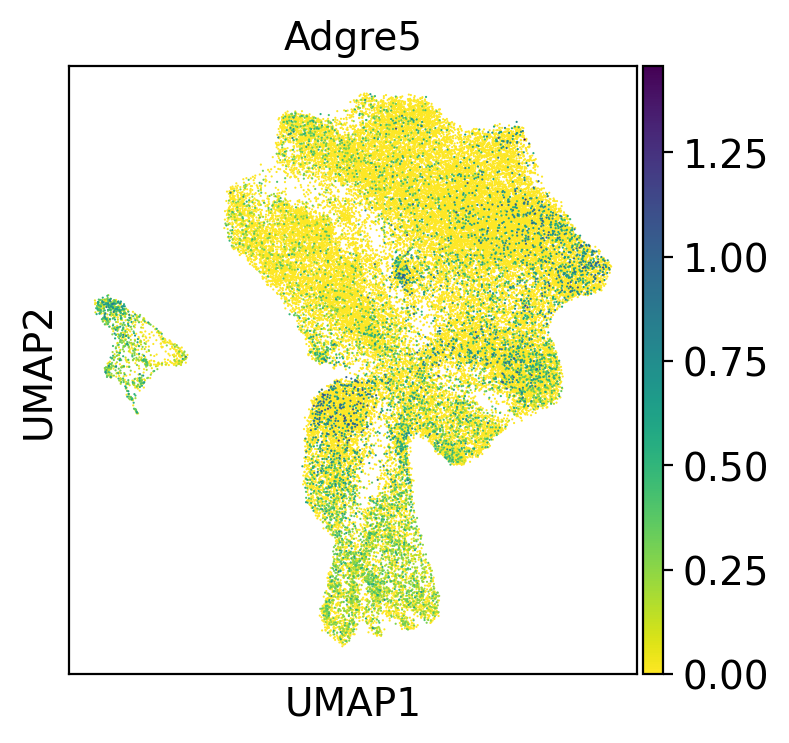

In [30]:
#Visualization of gene expression and other variables
# rc_context is used for the figure size, in this case 4x4
with rc_context({"figure.figsize": (4, 4)}):
    sc.pl.umap(adata, color="Adgre5")

bulk_labels
9mo      16495
16w      11323
7w11w     9628
5mo       6947
2w4w      3970
3d7d       520
7d         304
3dr2       203
Name: count, dtype: int64


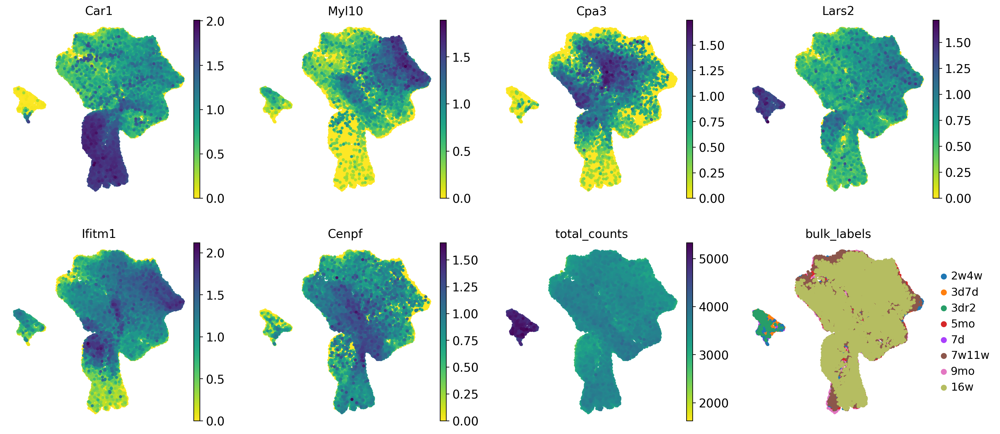

In [31]:
#Now will plot 6 genes
adata.obs["bulk_labels"] = adata.obs["batch"].astype("category")
print(adata.obs["bulk_labels"].value_counts())

genes = ["Car1", "Myl10", "Cpa3", "Lars2", "Ifitm1", "Cenpf"]
meta  = ["total_counts", "bulk_labels"]

color_vars = [g for g in genes if g in adata.var_names] + meta

sc.pl.umap(
    adata,
    color=color_vars,
    s=50,
    frameon=False,
    ncols=4,
)


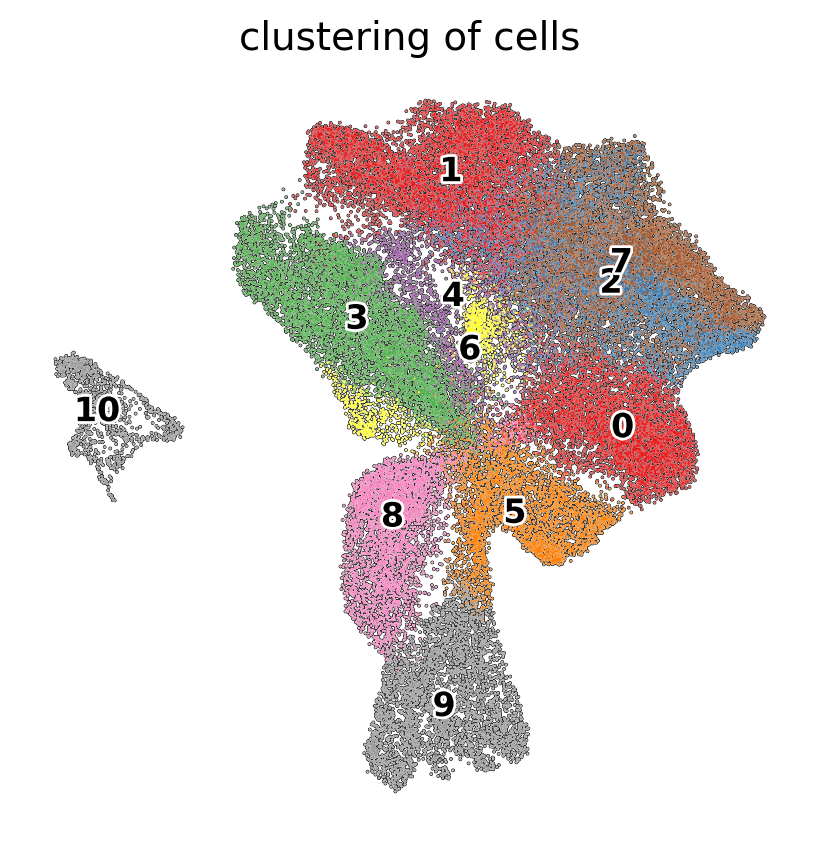

In [32]:
#further look into clustering
# compute clusters using the leiden method and store the results with the name `clusters`
sc.tl.leiden(
    adata,
    key_added="clusters",
    resolution=0.5,
    n_iterations=2,
    flavor="igraph",
    directed=False,
)

with rc_context({"figure.figsize": (5, 5)}):
    sc.pl.umap(
        adata,
        color="clusters",
        add_outline=True,
        legend_loc="on data",
        legend_fontsize=12,
        legend_fontoutline=2,
        frameon=False,
        title="clustering of cells",
        palette="Set1",
    )

2. Identification of clusters based on known marker genes

In [33]:
#Frequently, clusters need to be labelled using well known marker genes. Using scatter plots we can see the expression of a gene and perhaps associate it with a cluster. Here, we will show other visual ways to associate marker genes to clusters using dotplots, violin plots, heatmaps and something that we call ‘tracksplot’. 
# All of these visualizations summarize the same information, expression split by cluster, and the selection of the best results is left to the investigator do decide.

#First, we set up a dictionary with the marker genes, as this will allow scanpy to automatically label the groups of genes:
marker_genes_ = {
    # B cells
    "B-cell": ["Cd74", "H2-Aa", "H2-Ab1", "Cd37", "Cd22", "Blnk", "Bank1"],

    # T cells
    "T-cell": ["Trac", "Trbc1", "Ltb", "Il7r", "Cd247", "Malat1"],

    # NK cells
    "NK": ["Ncr1", "Klrk1", "Klrb1c", "Gzmb", "Prf1", "Ccl5", "Tyrobp"],

    # Monocytes / macrophages
    "Monocytes/Macrophage": ["Lyz2", "S100a8", "S100a9", "Lgals3", "Ctss", "Csf1r", "Tyrobp"],

    # Dendritic cells
    "Dendritic": ["Itgax", "H2-Ab1", "H2-Aa", "Flt3", "Clec10a", "Xcr1"],

    # Plasma cells
    "Plasma": ["Jchain", "Mzb1", "Xbp1", "Sdc1", "Derl3", "Igkc"],

    # “Other” (often progenitors / cycling / stromal depending on tissue)
    "Cycling": ["Mki67", "Top2a", "Cenpf", "Tubb5"],
}



Dotplot

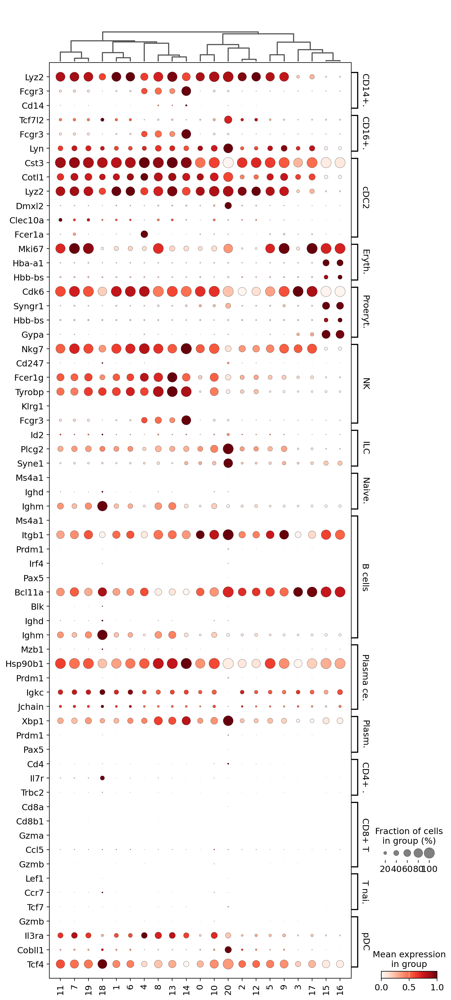

In [34]:
#Dotplot
#Quick way to check expression per cluster is through a dotplot. Colour represents mean exporession within each category and dot size indictaes the fraction og cells expressing a gene
#Add dendogram to bring together similar clusters. The hierarchical clustering is computed automatically using a correlation of PCA components between clusters
#sc.pl.dotplot(adata, marker_genes_mouse, "clusters", dendrogram=True)

sc.pl.dotplot(
    adata,
    filtered_markers,
    groupby="leiden",   # or "clusters"
    dendrogram=True,
    standard_scale="var",
    swap_axes=True
)




cell_type_lvl1
Lymphocytes    48305
Monocytes       1085
Name: count, dtype: int64


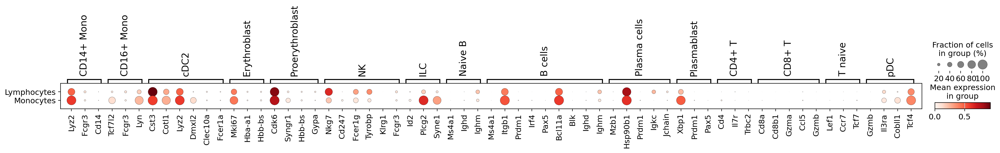

In [42]:
#From last plot choose which clusters represent which cell types - use that info to manually annotate cells
# create a dictionary to map cluster to annotation label

# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
#adata.obs["cell type"] = adata.obs["clusters"].map(cluster2annotation).astype("category")

#This dotplot particularly is bad because no pattern for manual asigning is seen but code should work with other datasets
# Map clusters to cell types
print(adata.obs["cell_type_lvl1"].value_counts())

marker_genes_filt = {
    k: [g for g in v if g in adata.var_names]
    for k, v in marker_genes_mouse.items()
}
marker_genes_filt = {k: v for k, v in marker_genes_filt.items() if v}

sc.tl.dendrogram(adata, groupby="cell_type_lvl1")

sc.pl.dotplot(
    adata,
    marker_genes_filt,
    groupby="cell_type_lvl1",
    dendrogram=True
)



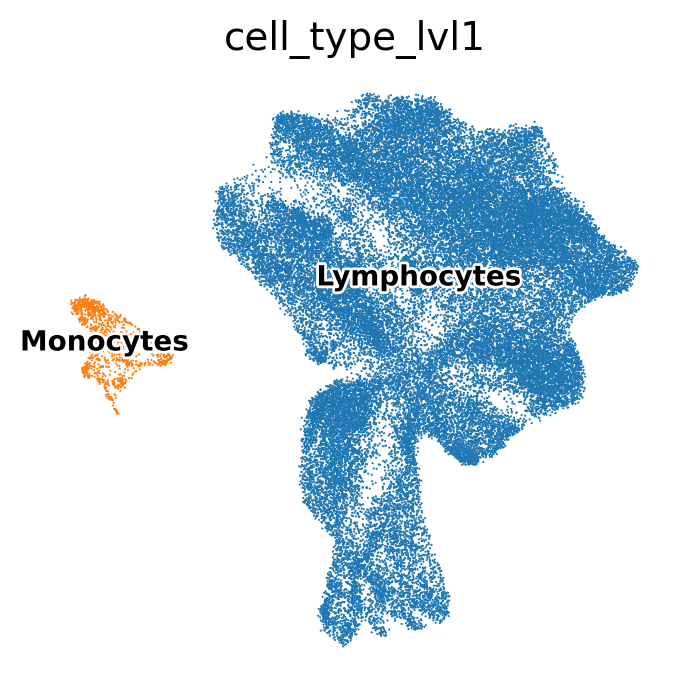

In [43]:
#UMAP plot
sc.pl.umap(
    adata,
    color="cell_type_lvl1",
    legend_loc="on data",
    frameon=False,
    legend_fontsize=10,
    legend_fontoutline=2,
)

Violin plot

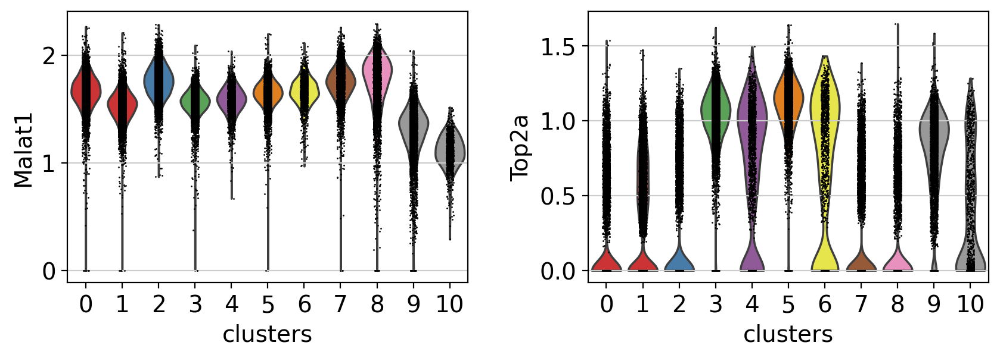

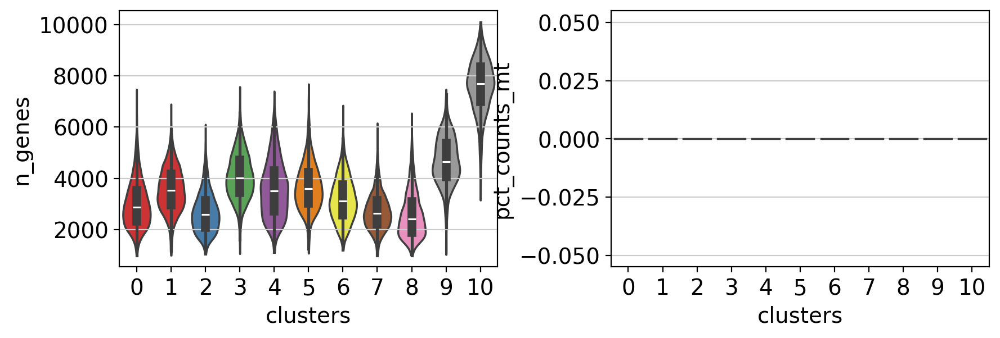

In [44]:
#Violin plot ot explore a specific marker gene acorss clusters - compared to dotplot gives an idea of distribution of gene experession values across cells
with rc_context({"figure.figsize": (4.5, 3)}):
    sc.pl.violin(adata, ["Malat1", "Top2a"], groupby="clusters")

#Violin plots can also be used to plot numerical value stored in .obs - here violin plots used to compare number of genes and precentage ot mt genes between different clusters
with rc_context({"figure.figsize": (4.5, 3)}):
    sc.pl.violin(
        adata,
        ["n_genes", "pct_counts_mt"],
        groupby="clusters",
        stripplot=False,  # remove the internal dots
        inner="box",  # adds a boxplot inside violins
    )

Stacked-violin plot

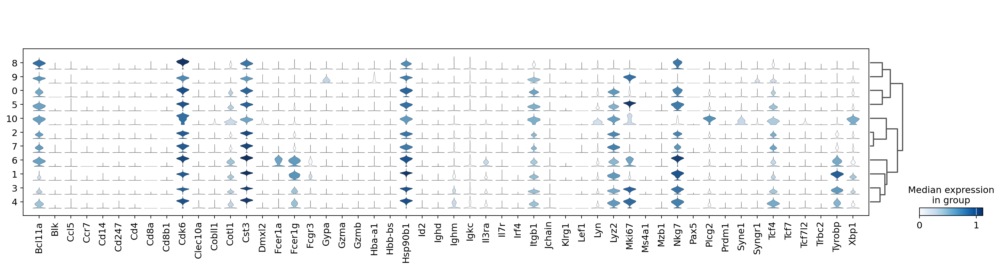

In [45]:
#Simultanoeusly look at violin plots for all marker genes we use sc.pl.stacked_violin
# 1) Create marker_list from the dictionary
marker_list = sorted(set(
    g for genes in marker_genes_mouse.values() for g in genes
))

# 2) Filter to genes present in the dataset
marker_list = [g for g in marker_list if g in adata.var_names]

ax = sc.pl.stacked_violin(
    adata,
    marker_list,
    groupby="clusters",
    dendrogram=True
)

Matrixplot

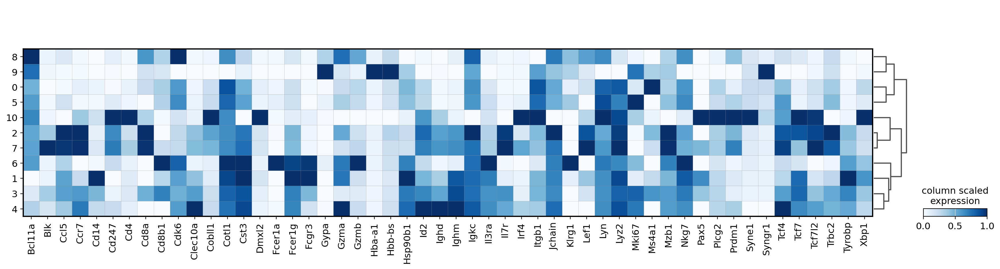

In [46]:
#Simple way to visualise gene expression with a matrixplot. It's a heatmap of the mean expression values per gene grouped by categories. This type plot shows same info as color in dotplots
#Here sclae expression of genes form 0 to 1 being max mean expression and 0 the min
sc.pl.matrixplot(
    adata,
    marker_list,
    "clusters",
    dendrogram=True,
    cmap="Blues",
    standard_scale="var",
    colorbar_title="column scaled\nexpression",
)

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/functools.py:912: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


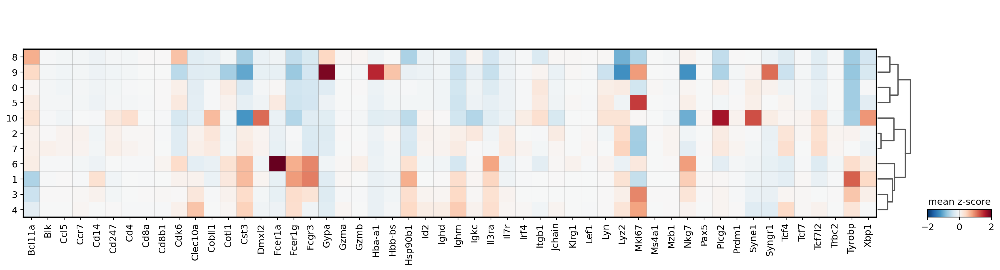

In [47]:
#Another useful option is to normalise gene expression using sc.pp.scale. We store this info under scale layer. Afterwards we adjust the plot mina nd max and use diverging colour map
# scale and store results in layer
adata.layers["scaled"] = sc.pp.scale(adata, copy=True).X

sc.pl.matrixplot(
    adata,
    marker_list,
    "clusters",
    dendrogram=True,
    colorbar_title="mean z-score",
    layer="scaled",
    vmin=-2,
    vmax=2,
    cmap="RdBu_r",
)

2. Combining plots and suplots

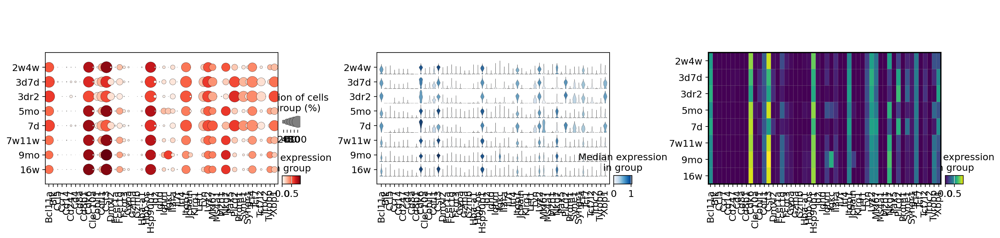

In [48]:
#An axis can be passed to a plot to combine multiple outputs into a single figure
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 4), gridspec_kw={"wspace": 0.3})

ax1_dict = sc.pl.dotplot(adata, marker_list, groupby="bulk_labels", ax=ax1, show=False)
ax2_dict = sc.pl.stacked_violin(adata, marker_list, groupby="bulk_labels", ax=ax2, show=False)
ax3_dict = sc.pl.matrixplot(adata, marker_list, groupby="bulk_labels", ax=ax3, show=False, cmap="viridis")


3. Heatmaps

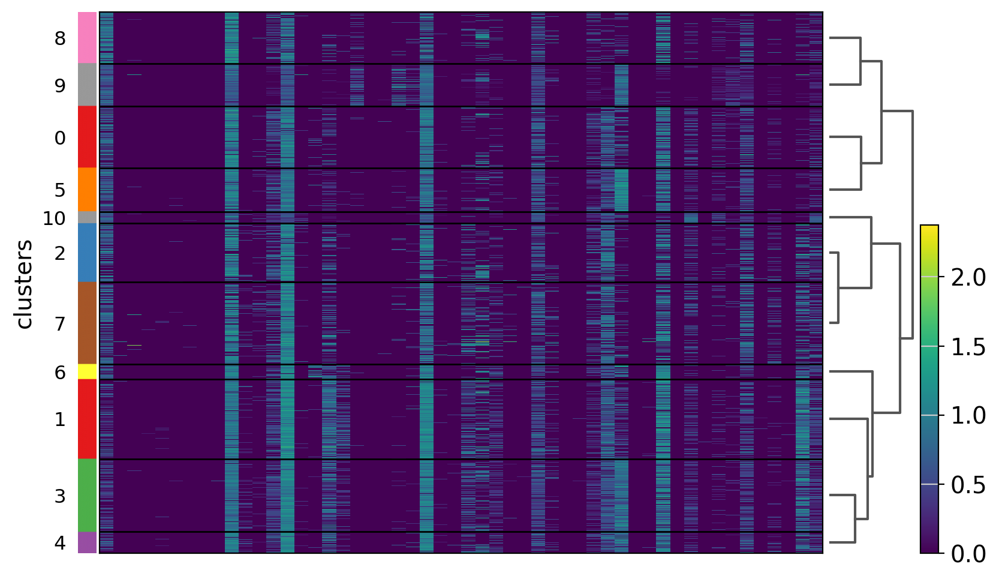

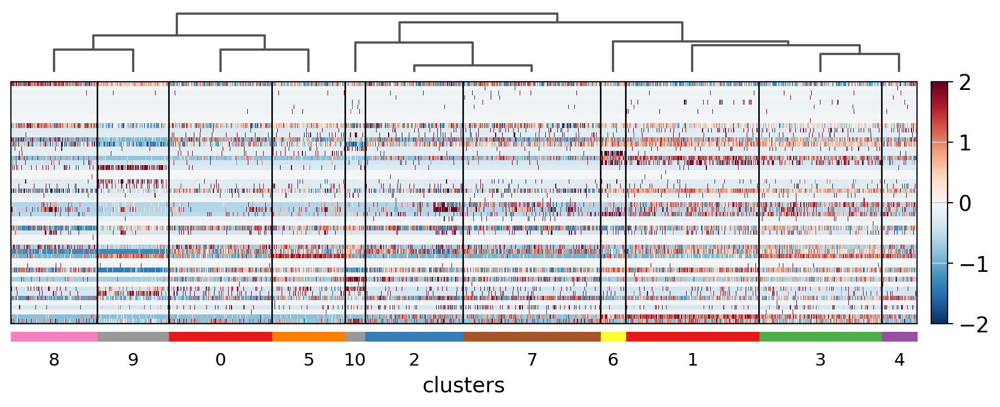

In [49]:
#Heatmaps do not collapse cells as in previous plots - instead each cell shown in a row / column - groupby info can be added and is shown using same color code as other embeddings
ax = sc.pl.heatmap(adata, marker_list, groupby="clusters", cmap="viridis", dendrogram=True)

#The heatmap can also be plotted on scaled data - next figure, similar to previous matrixplot min and max are adjusted and divergent color map is used
ax = sc.pl.heatmap(
    adata,
    marker_list,
    groupby="clusters",
    layer="scaled",
    vmin=-2,
    vmax=2,
    cmap="RdBu_r",
    dendrogram=True,
    swap_axes=True,
    figsize=(11, 4),
)

4. Tracksplot

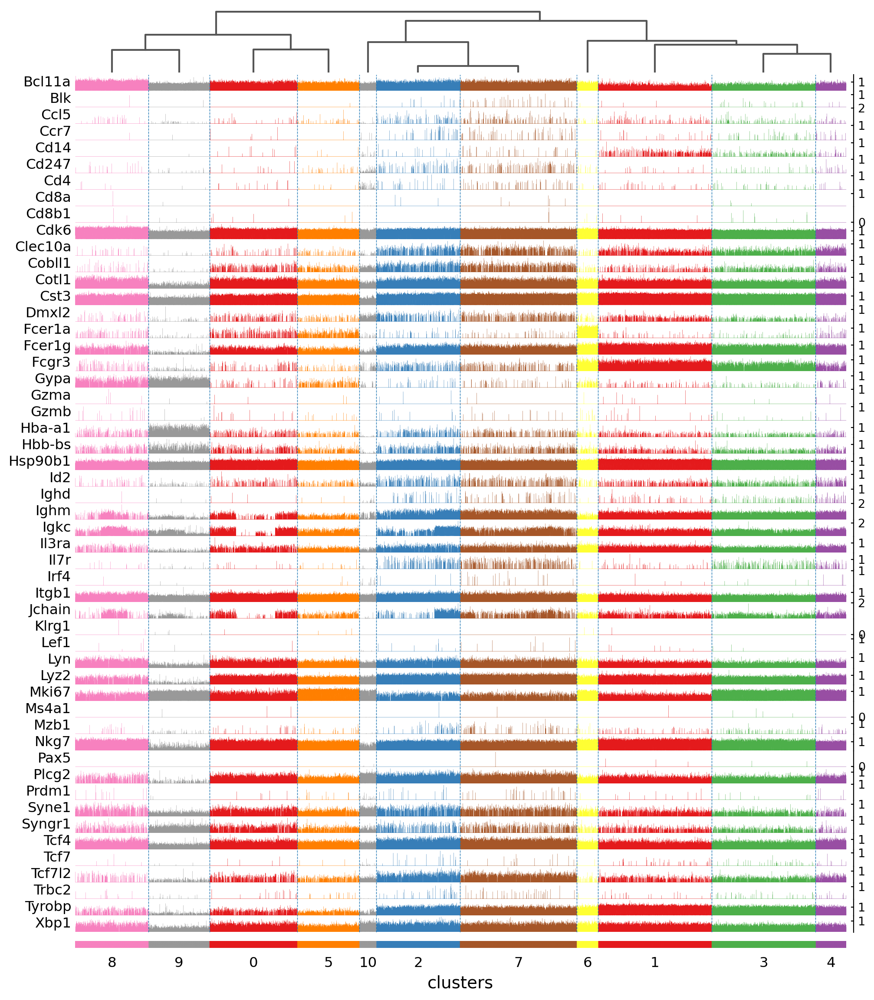

In [50]:
#Track plot shows same info as heatmap but instead of a colour scale, gene expression is represented by height
ax = sc.pl.tracksplot(adata, marker_list, groupby="clusters", dendrogram=True)

5. Visualization of marker genes

In [51]:
#Instead of characterizing clusters by knwon gene markers as previously, we can identify genes that are DEGs in clusters or groups
#To identify DEGs we run sc.tl.rank_genes_groups function which computes DEGs for each group vs the rest using statistical tests such as Wilcoxon rank-sum test
#We will use original cell labels from 10x to identify markers genes for those clel types
sc.tl.rank_genes_groups(adata, groupby="clusters", method="wilcoxon")

Visualize markers using dotplot

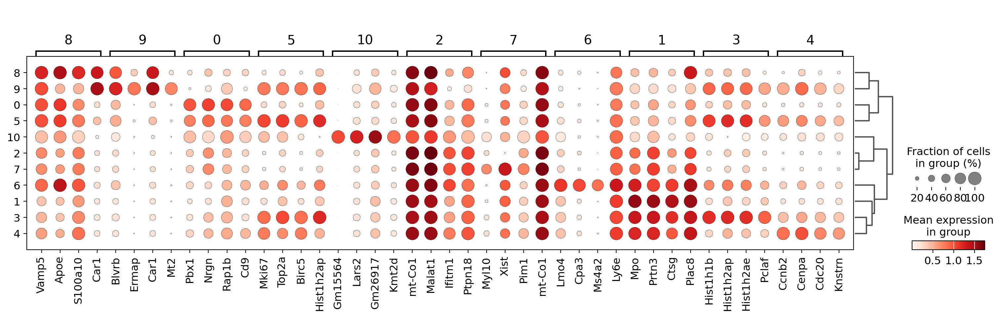

In [52]:

#Dotplot visualization is useful to get an overview of the genes that show differential expression
#To make resulting image more compact we use n_genes=4 to show top 4 DEGs
sc.pl.rank_genes_groups_dotplot(adata, n_genes=4)

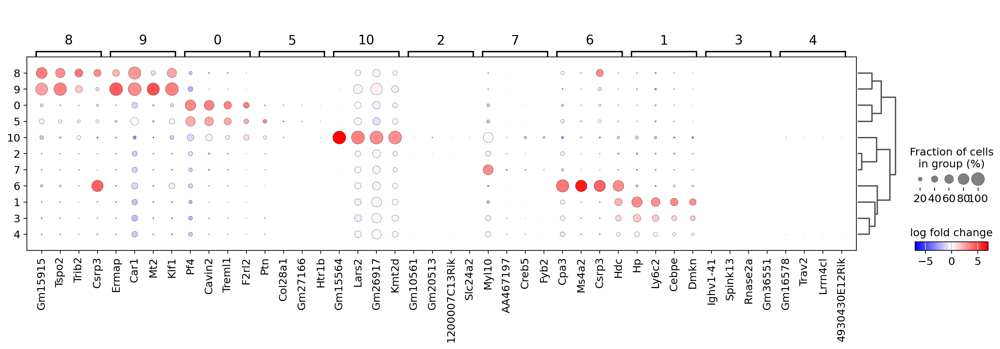

In [53]:
#In order to get better representation we can plot log fold changes instead of gene expression
#Also want to focus on genes that have log fold change =>3 between cell type expression and rest of cells

#In this case we set values_to_plots='logfoldchanges' and min_logfoldchange=3
#Because log fold change is divergent scale we also adjust the min and max to be ploted and use a divergent colour map.
sc.pl.rank_genes_groups_dotplot(
    adata,
    n_genes=4,
    values_to_plot="logfoldchanges",
    min_logfoldchange=3,
    vmax=7,
    vmin=-7,
    cmap="bwr",
)

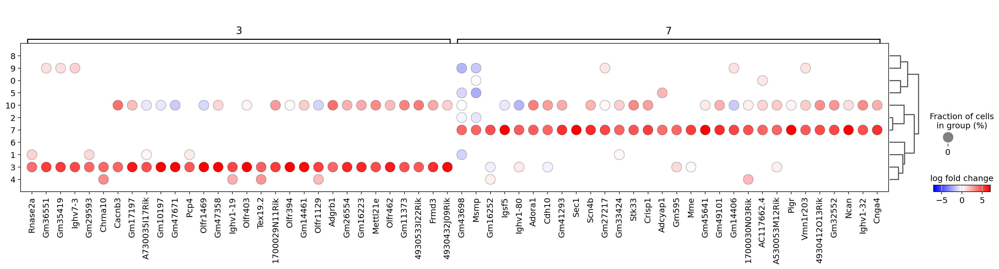

In [54]:
#Focusing on particular groups
#Next we want to focus on specific groups and do a dotplot. We set n_genes=30 as in this case it will show all the genes that have a min_log_foldchange=4 up to 30
sc.pl.rank_genes_groups_dotplot(
    adata,
    n_genes=30,
    values_to_plot="logfoldchanges",
    min_logfoldchange=4,
    vmax=7,
    vmin=-7,
    cmap="bwr",
    groups=["3", "7"],
    dot_max=0.0000000001,
)

Visualize marker genes using matrixplot

True
['counts', 'scaled']


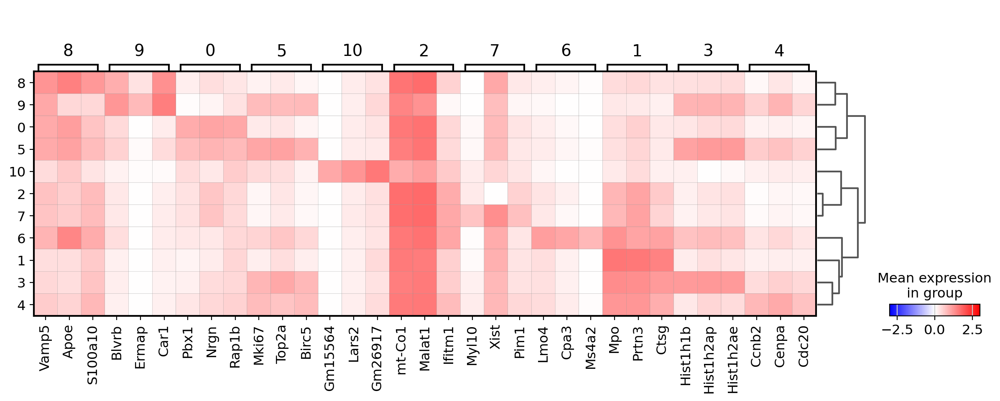

In [55]:
#In the following plot we use previously computed "scaled" values (stored in scaled) and use a divergent colour map
#Check that rank_genes_groups results are present
adata.layers["scaled"] = adata.X.copy()
print("rank_genes_groups" in adata.uns)
#Check that layers are present and "sclaed" exists
print(list(adata.layers.keys()))

sc.pl.rank_genes_groups_matrixplot(
    adata,
    n_genes=3,
    layer="scaled",
    vmin=-3, vmax=3,
    cmap="bwr",
)


Visualize marker genes using stacked violin plots

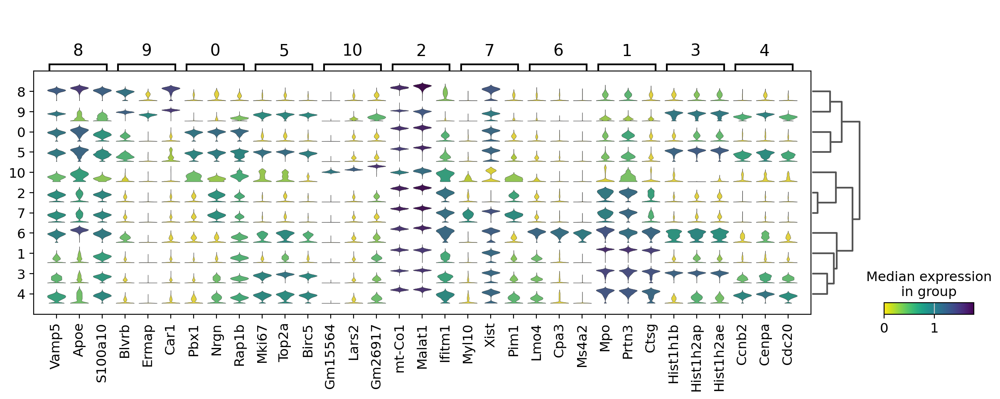

In [56]:
sc.pl.rank_genes_groups_stacked_violin(adata, n_genes=3, cmap="viridis_r")

Visualize gene marker using heatmap

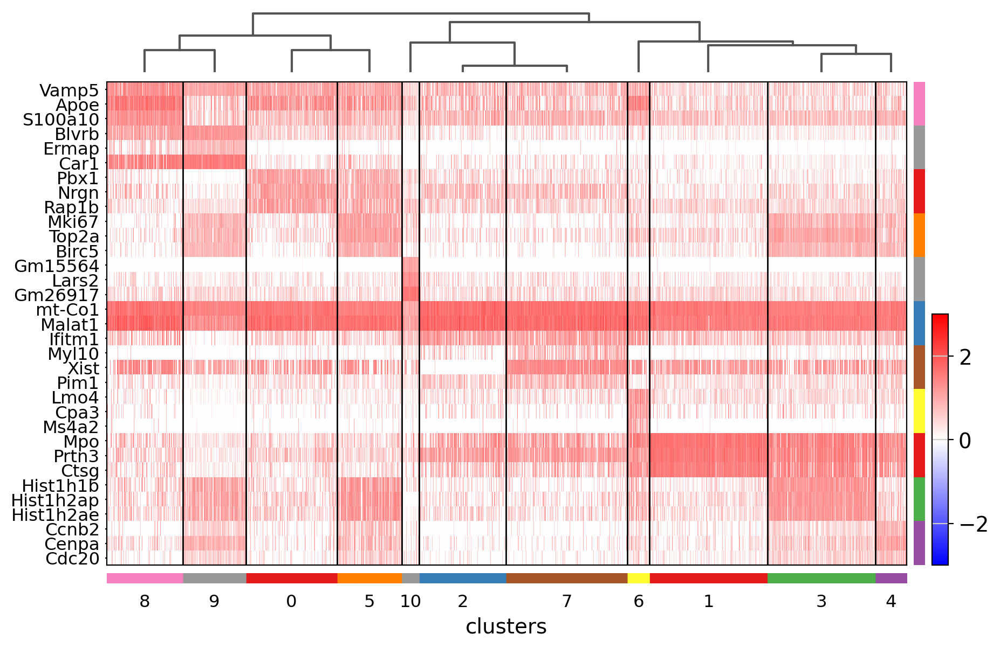

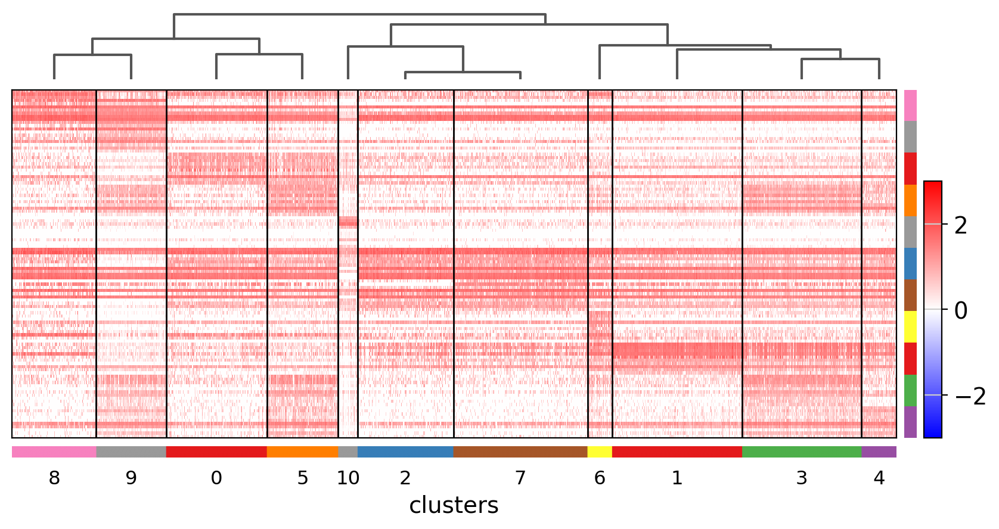

In [57]:
sc.pl.rank_genes_groups_heatmap(
    adata,
    n_genes=3,
    use_raw=False,
    swap_axes=True,
    vmin=-3,
    vmax=3,
    cmap="bwr",
    layer="scaled",
    figsize=(10, 7),
    show=False,
);
#Showing 10 genes per category, turning the gene labels off and swapping the axes. Notice that when the image is swapped, a color code for the categories appear instead of the ‘brackets’.
sc.pl.rank_genes_groups_heatmap(
    adata,
    n_genes=10,
    use_raw=False,
    swap_axes=True,
    show_gene_labels=False,
    vmin=-3,
    vmax=3,
    cmap="bwr",
)

Visualize marker genes using tracksplot

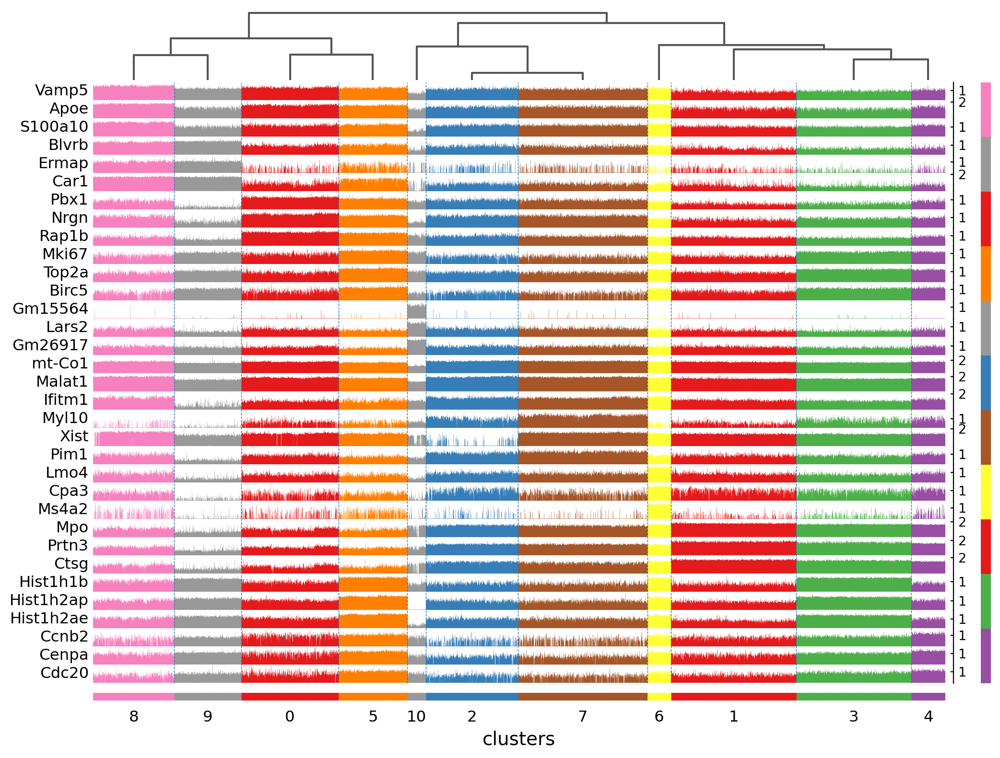

In [58]:
sc.pl.rank_genes_groups_tracksplot(adata, n_genes=3)

6. Comparison of marker genes using split violin plots

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:460: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packa

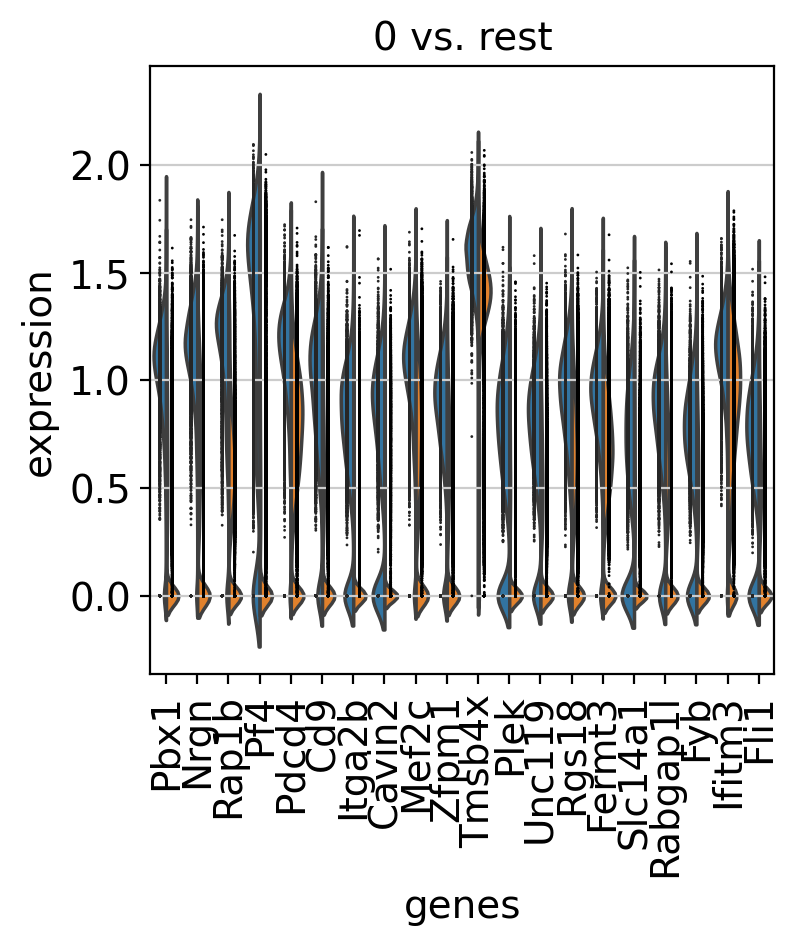

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


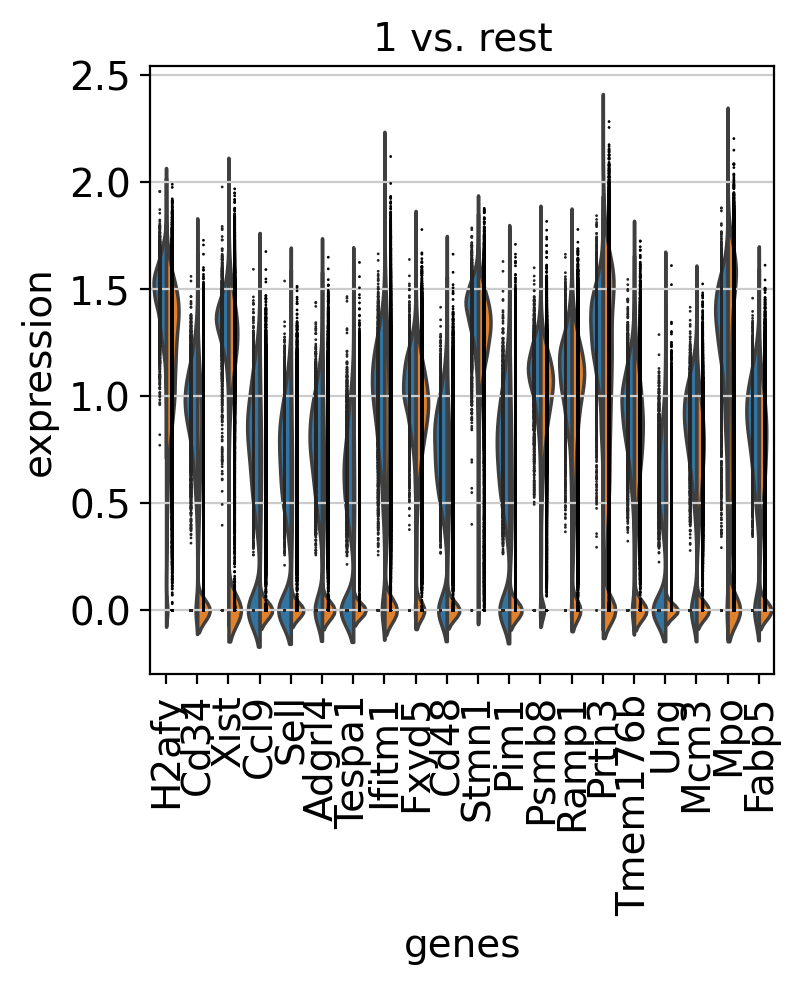

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


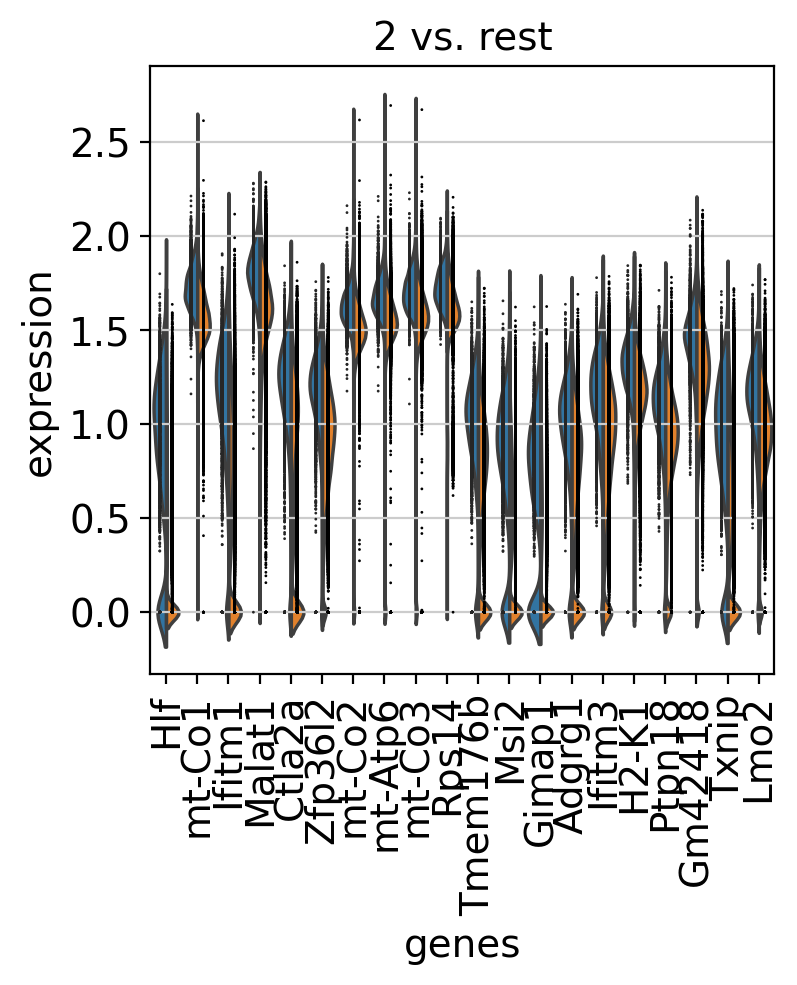

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


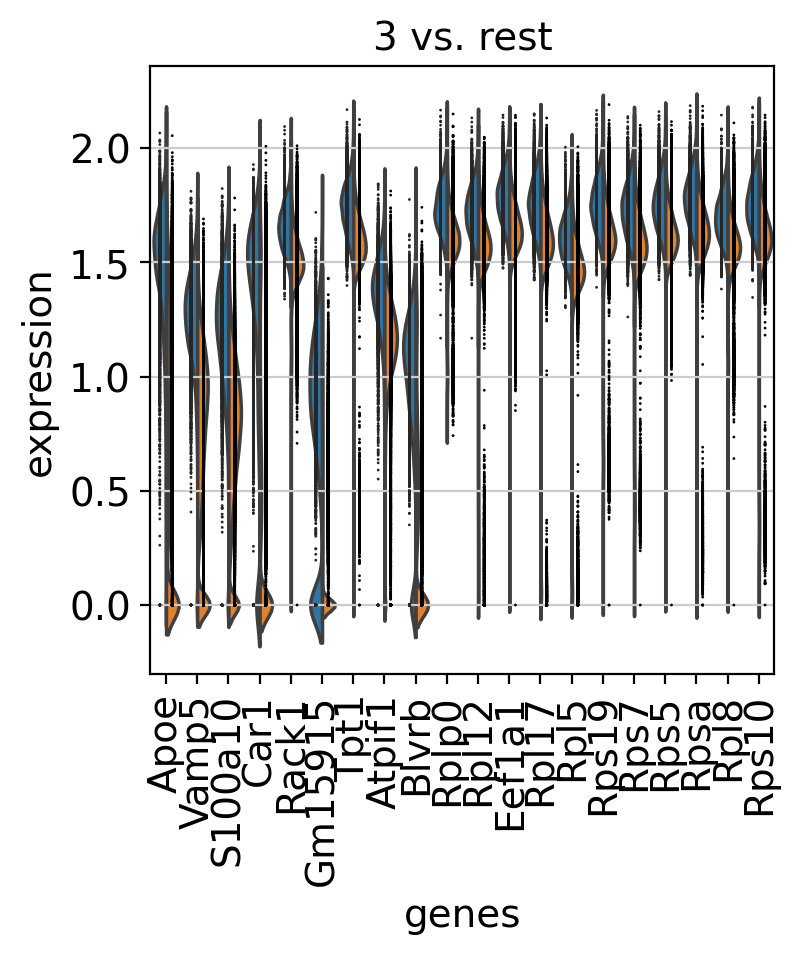

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


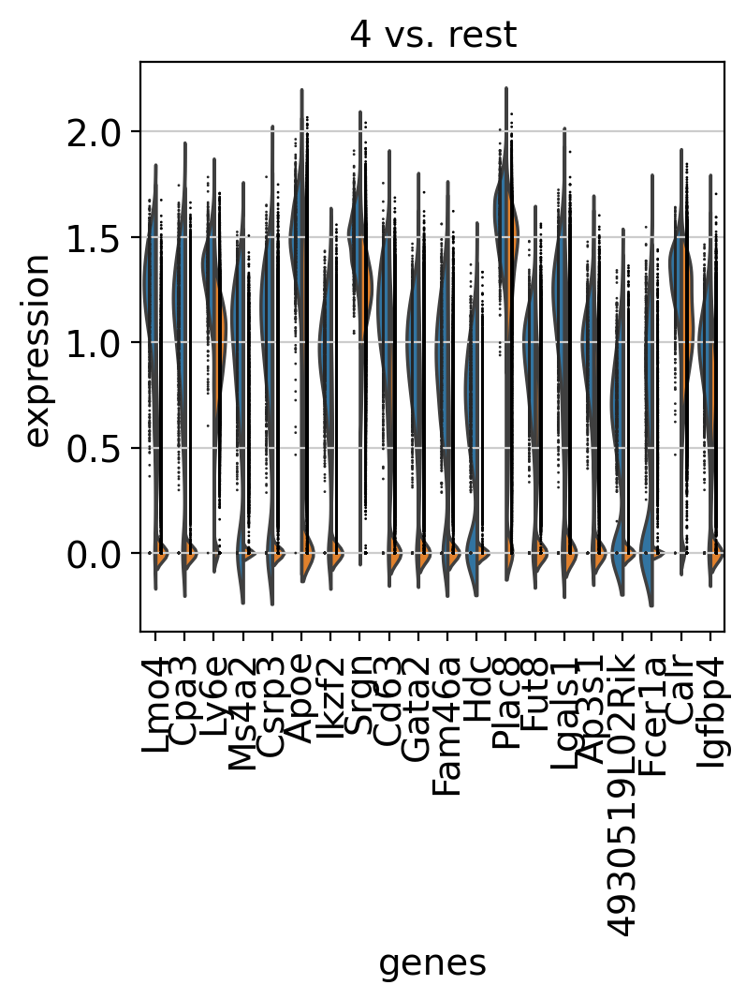

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


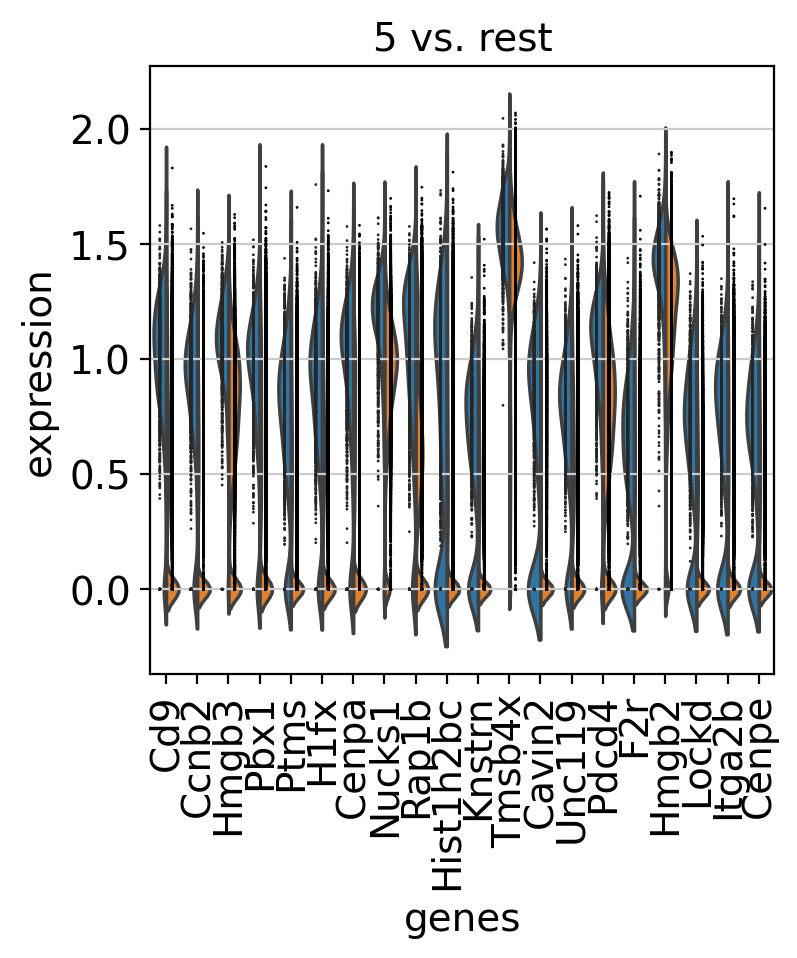

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


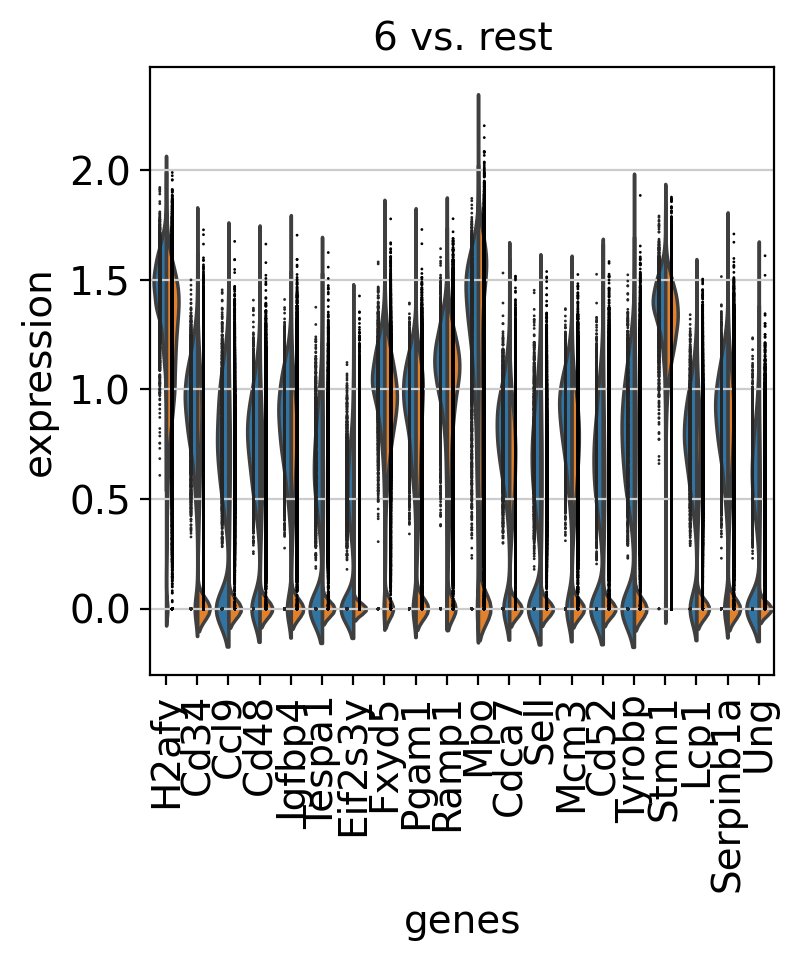

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


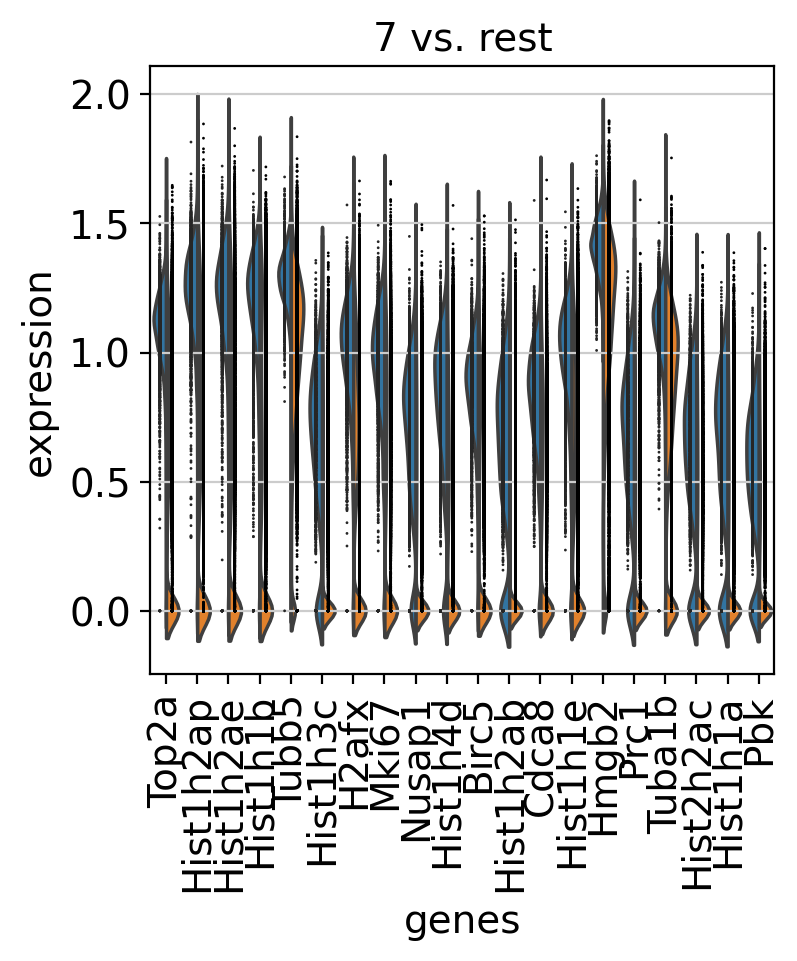

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


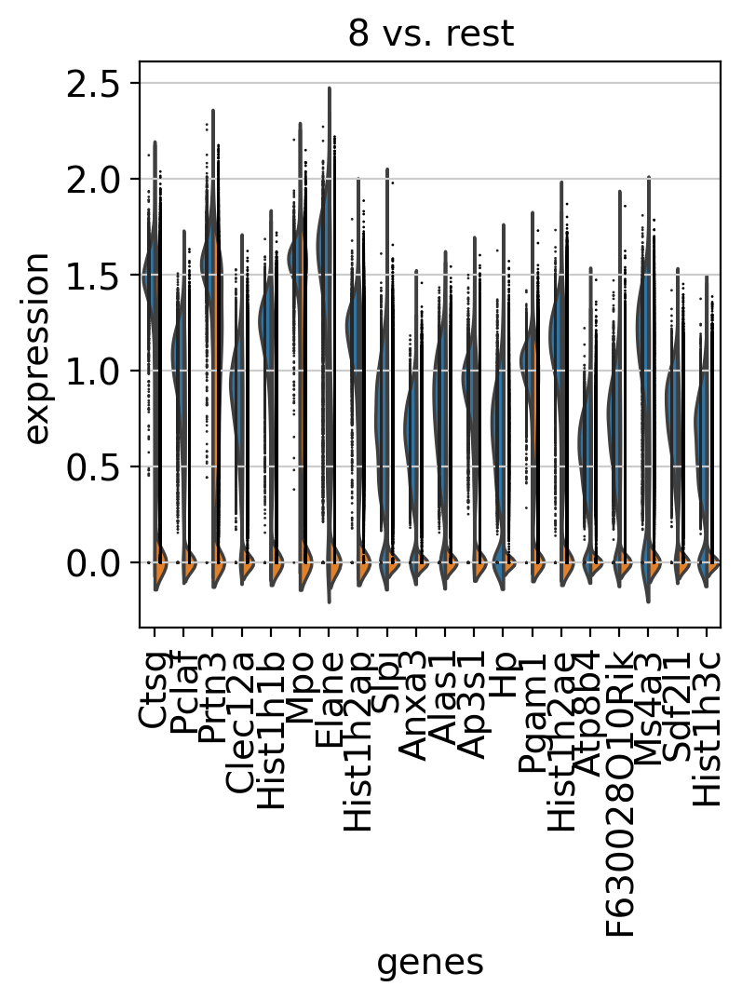

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


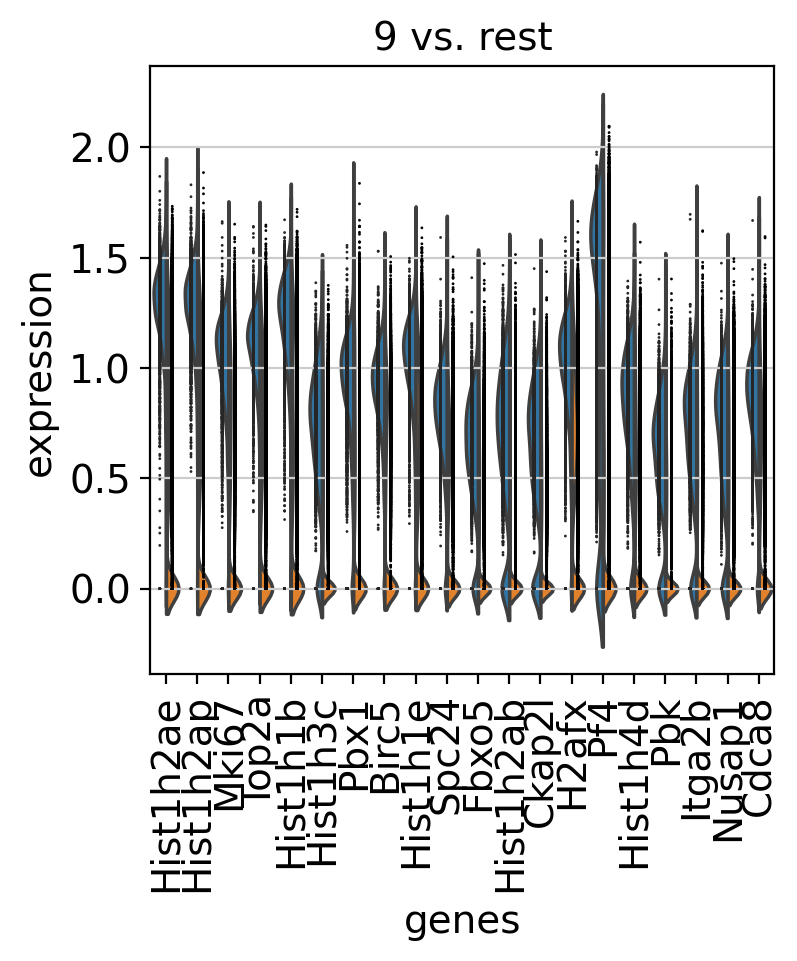

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


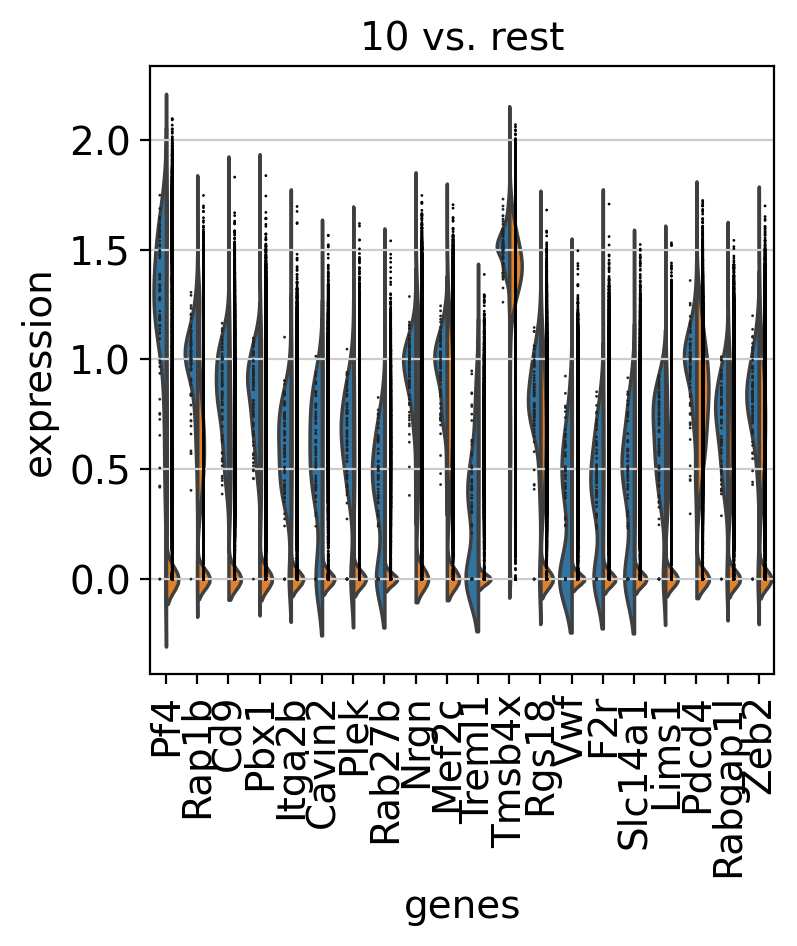

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


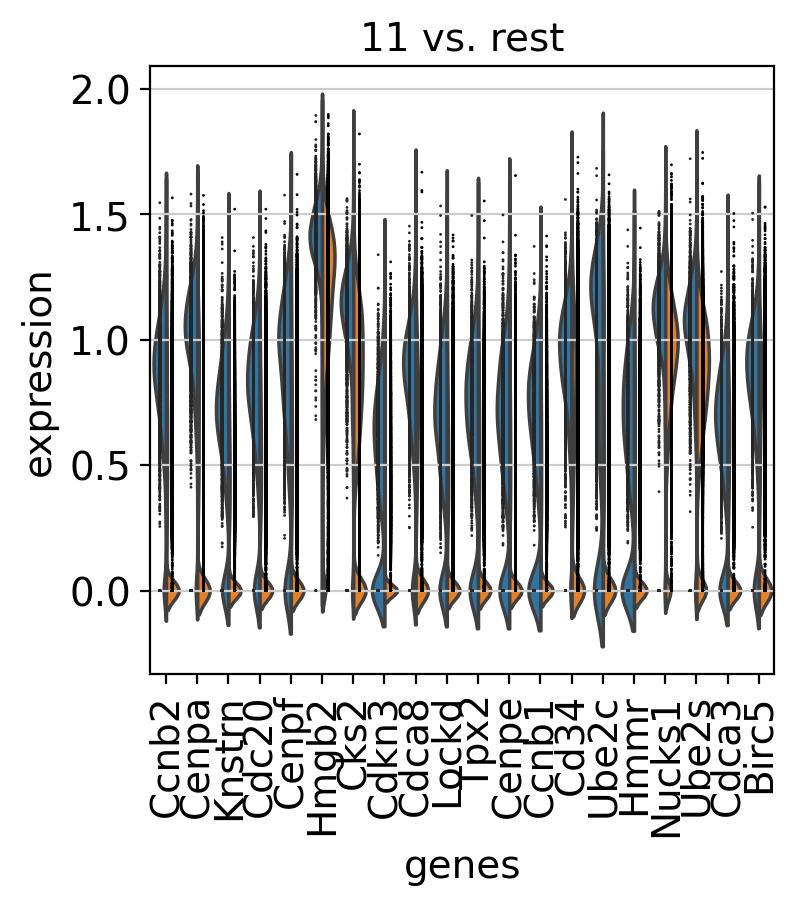

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


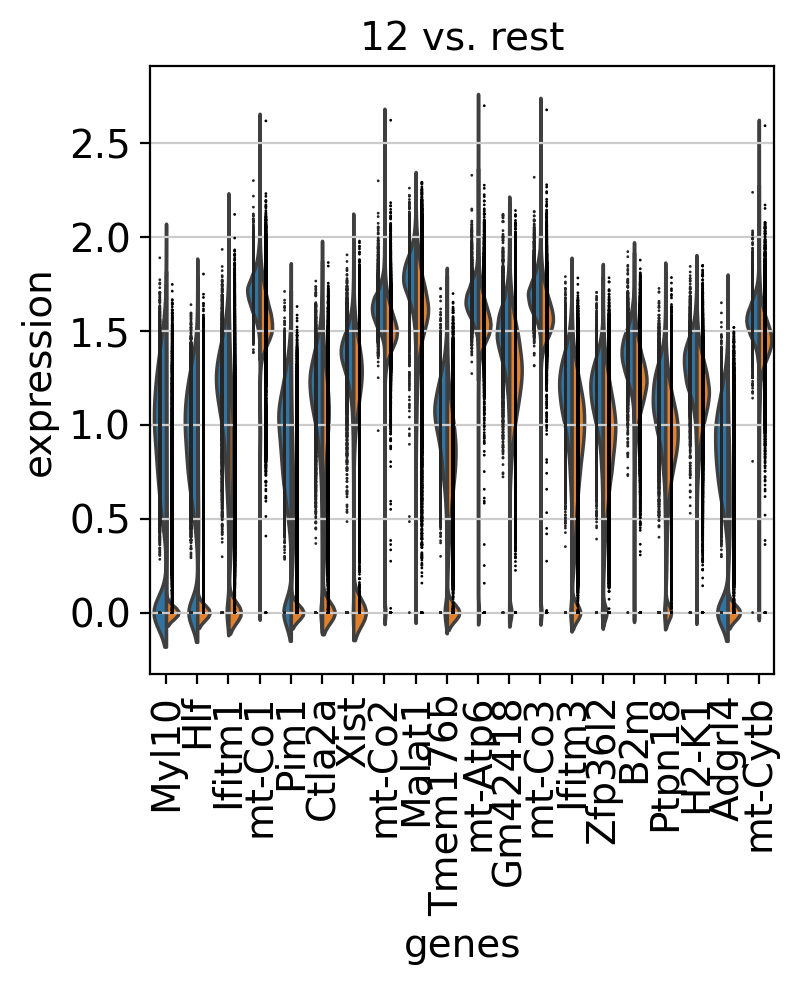

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


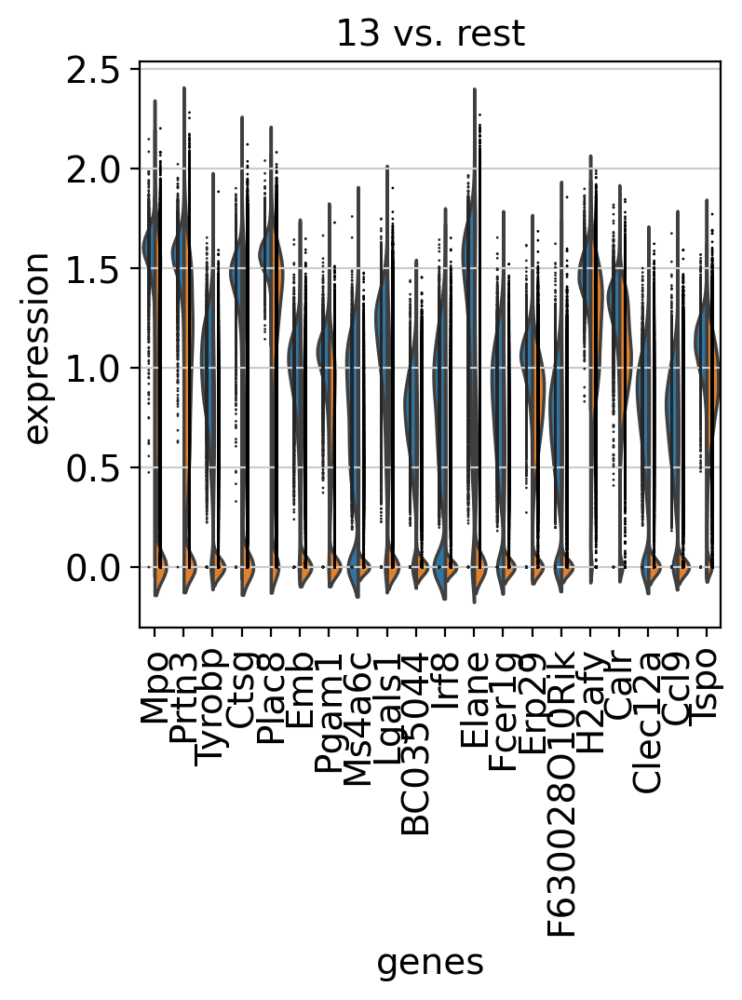

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


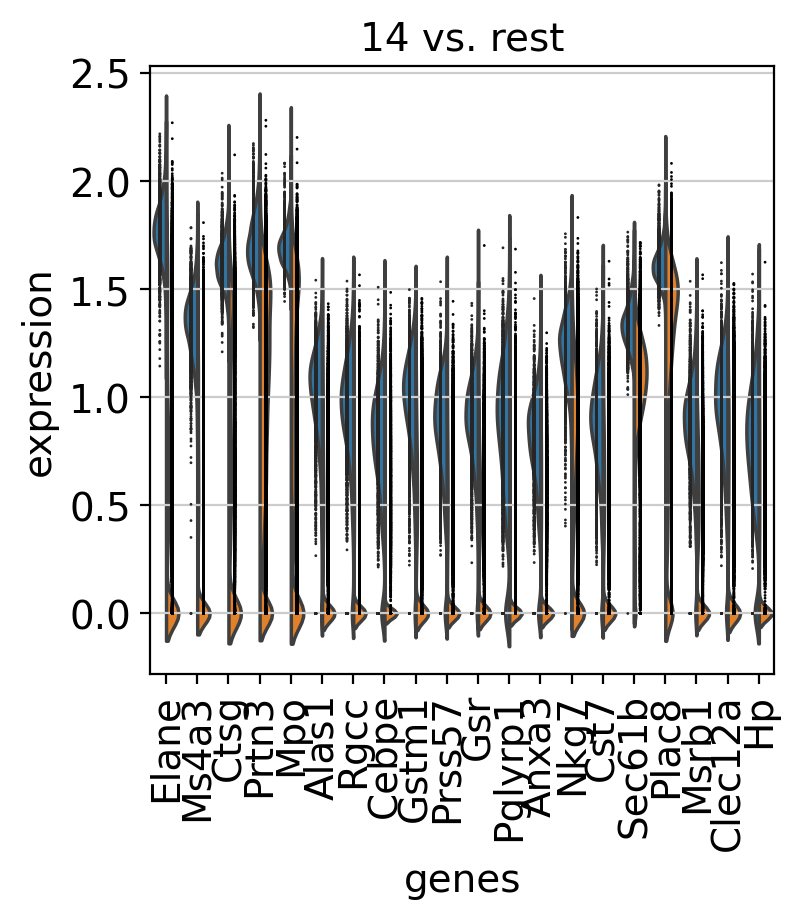

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


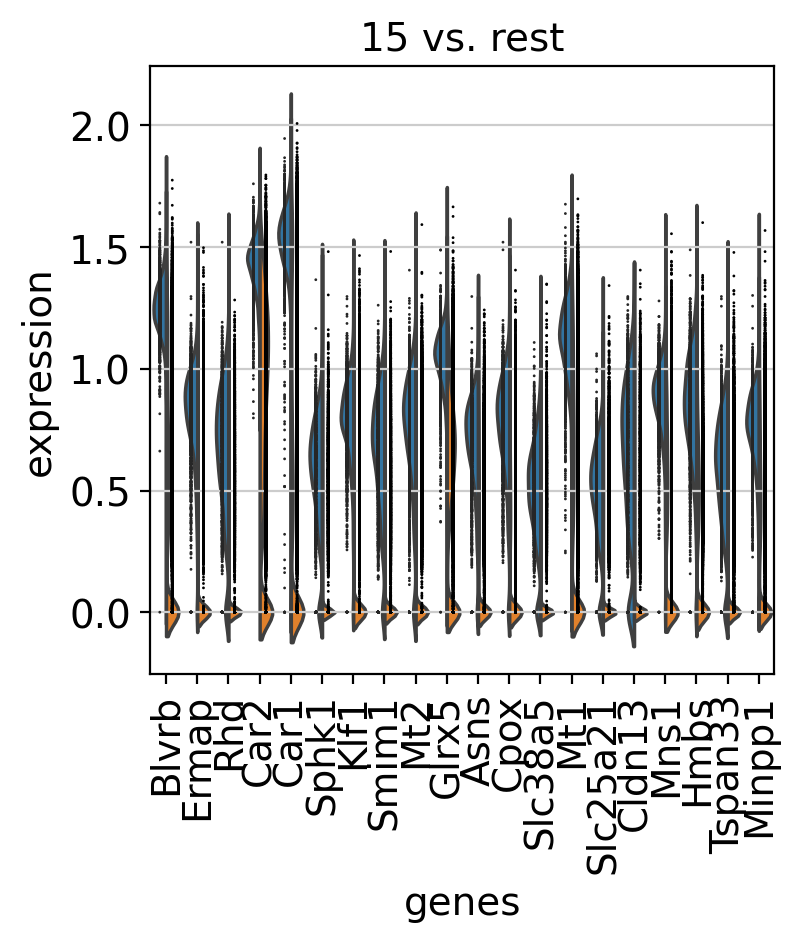

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


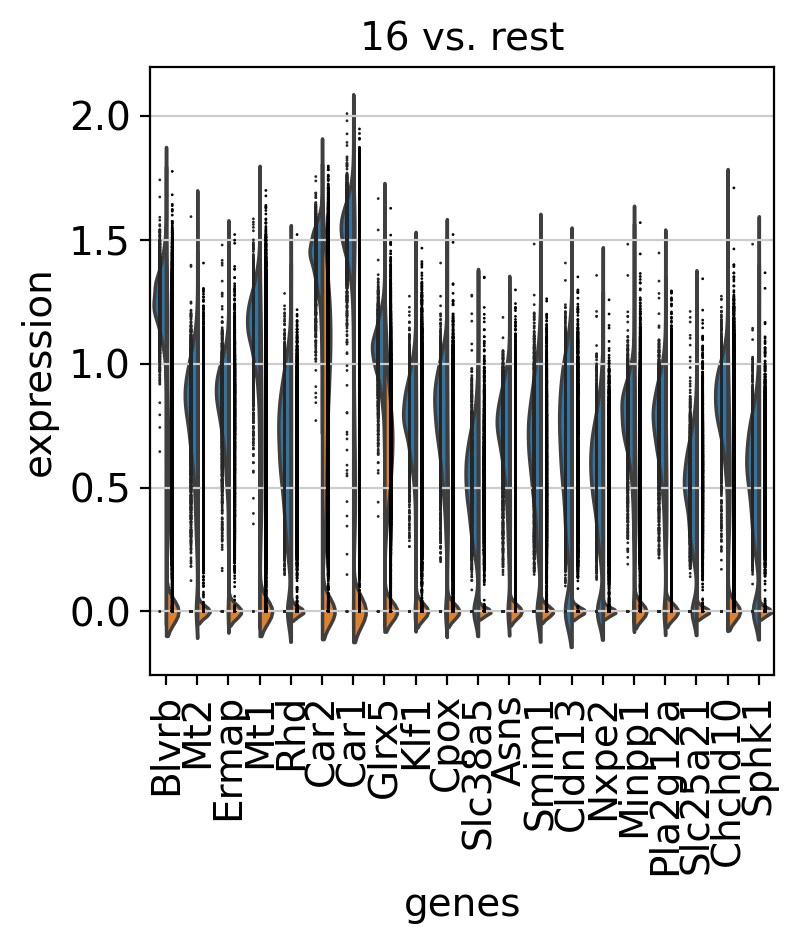

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


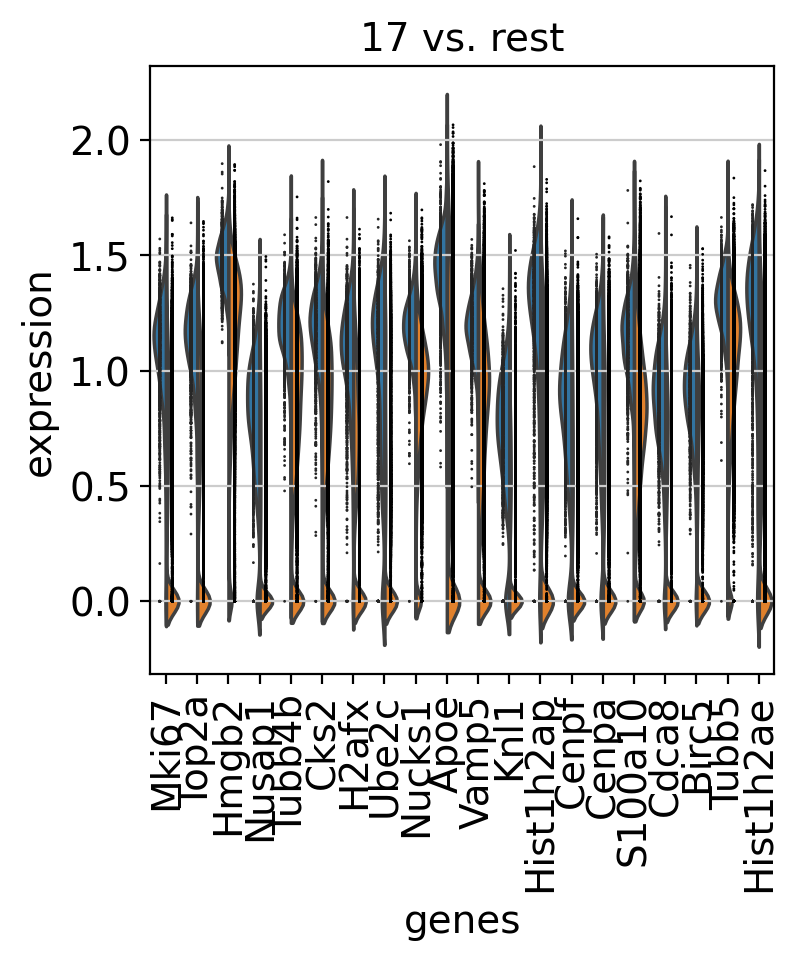

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


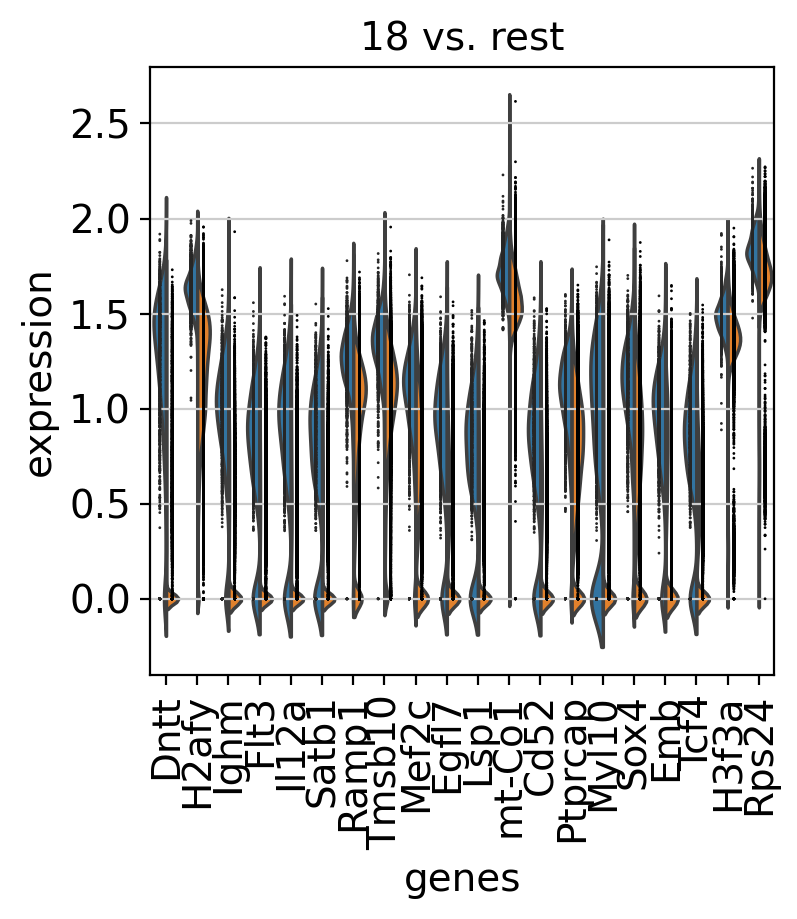

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


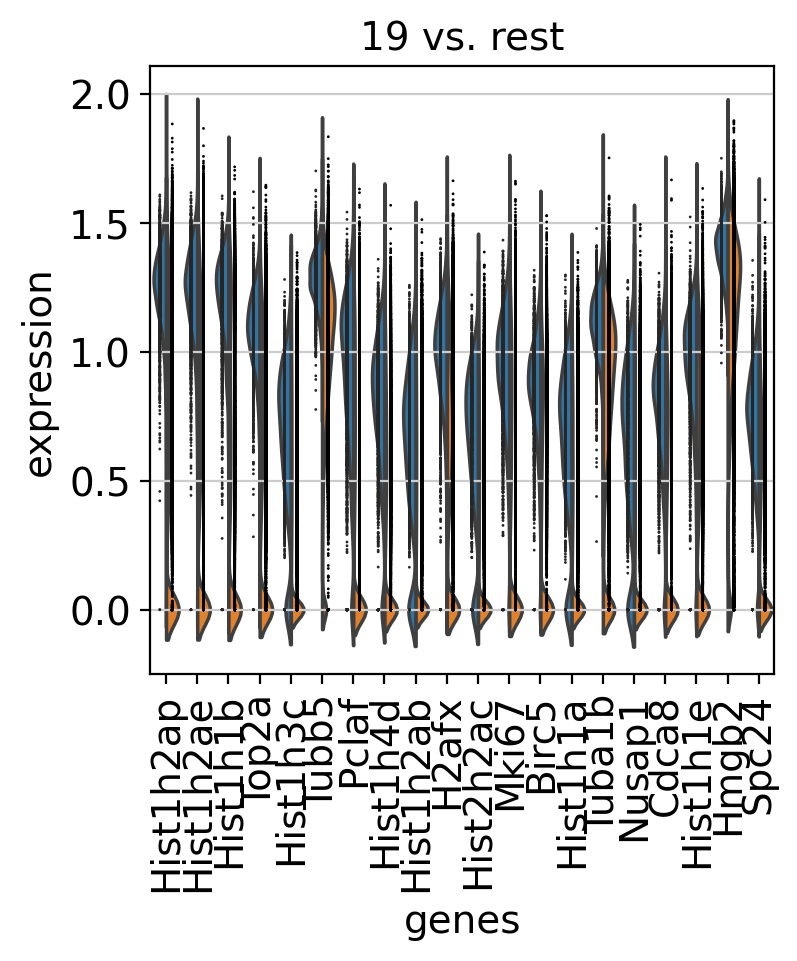

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


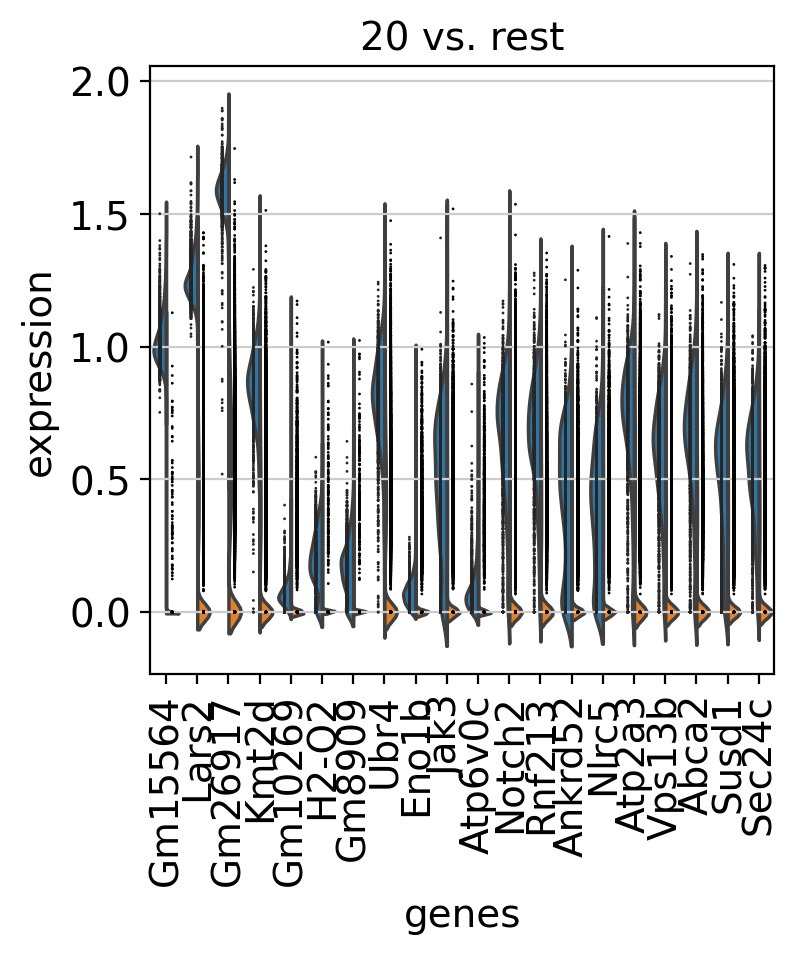

In [59]:
#Compare all marker genes at once

#Specific to this dataset - some Leiden groups have 1 cell so Wilcoxon DE cant compute statistics - so we will drop tiny clusters and run DE
import scanpy as sc

# keep only clusters with >= 2 cells (use >= 5 if you want more stable DE)
min_cells = 2
counts = adata.obs["leiden"].value_counts()
keep = counts[counts >= min_cells].index

adata_de = adata[adata.obs["leiden"].isin(keep)].copy()

sc.tl.rank_genes_groups(adata_de, groupby="leiden", method="wilcoxon", use_raw=False)
sc.pl.rank_genes_groups_violin(adata_de, n_genes=20, jitter=False)


/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:460: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packa

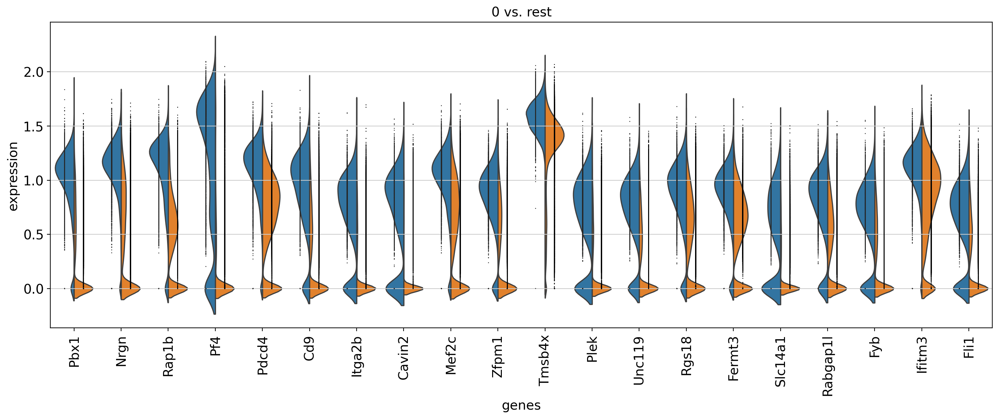

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


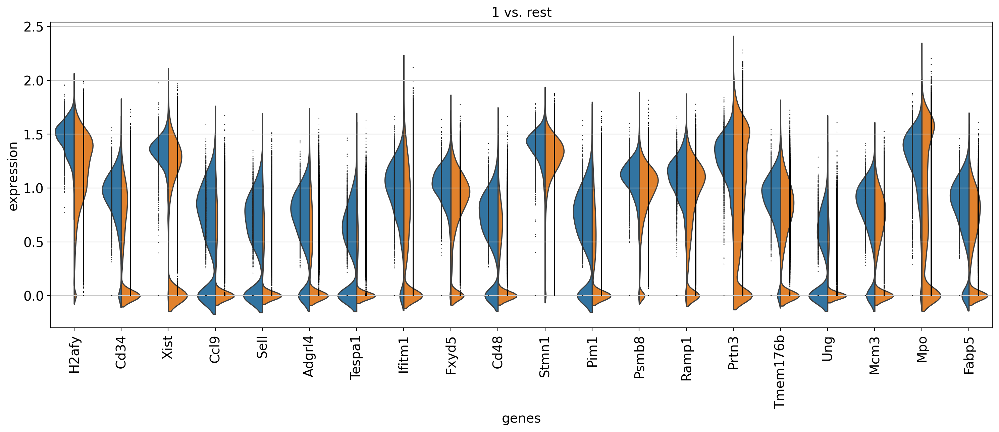

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


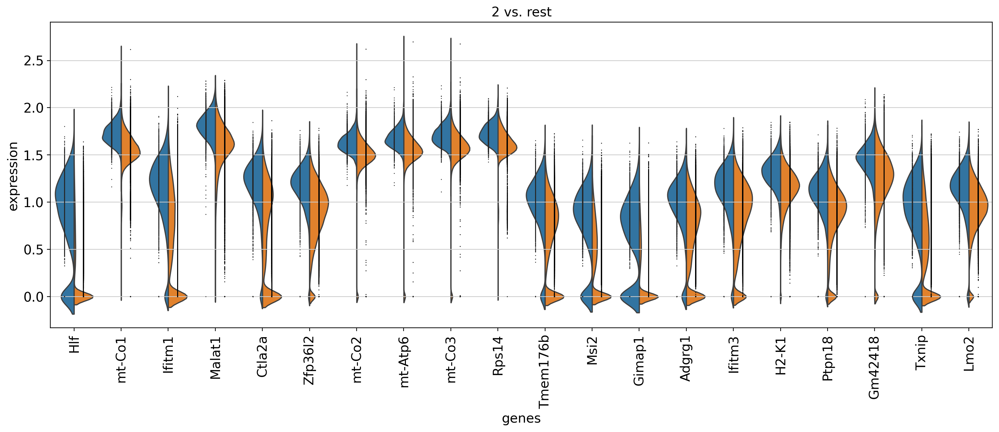

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


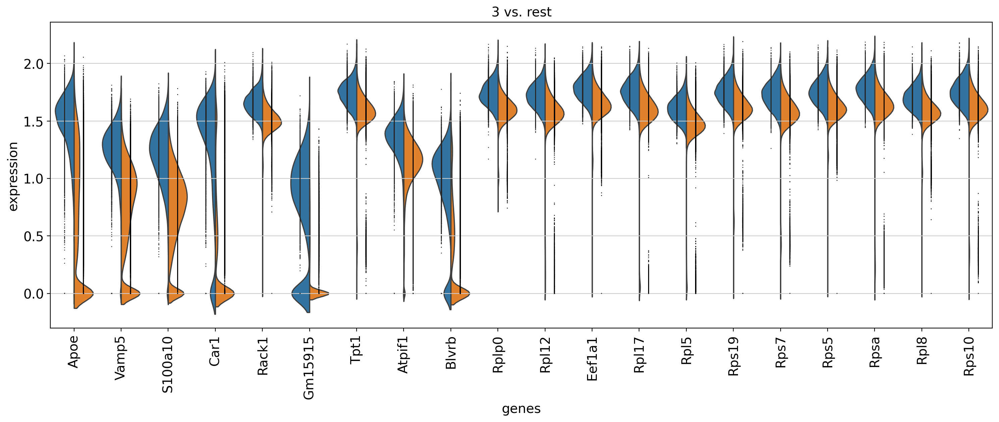

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


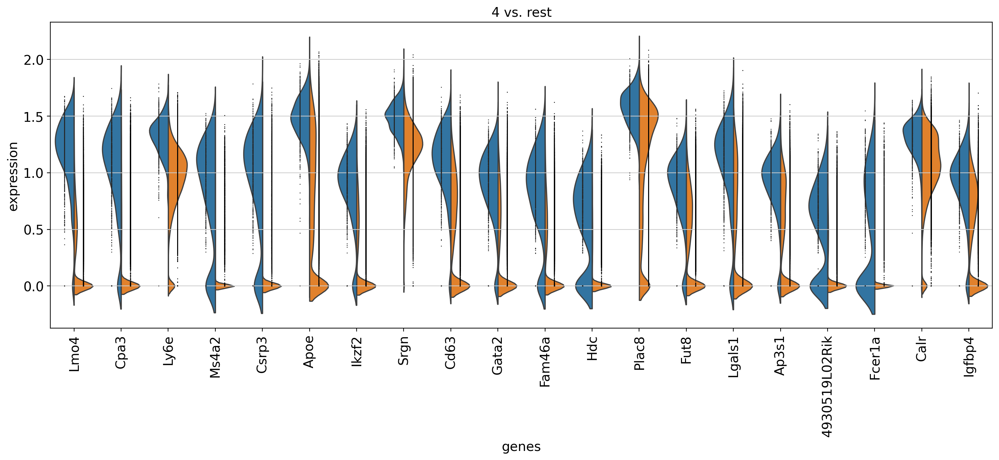

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


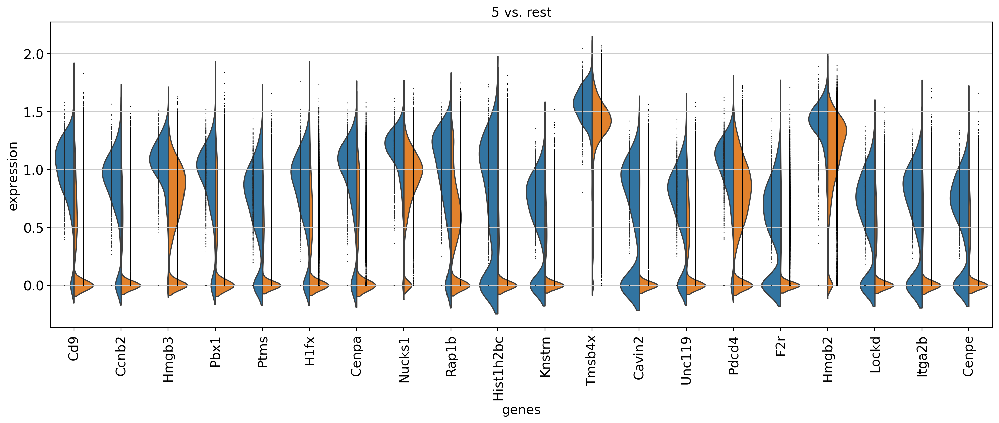

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


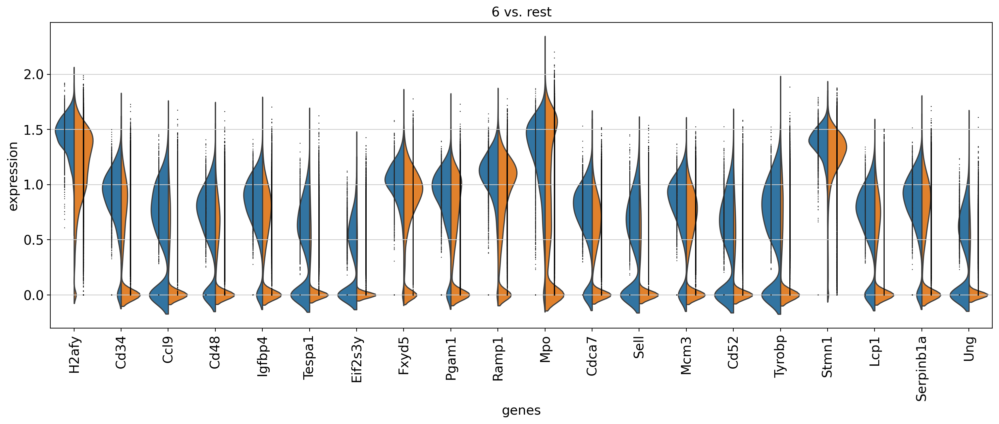

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


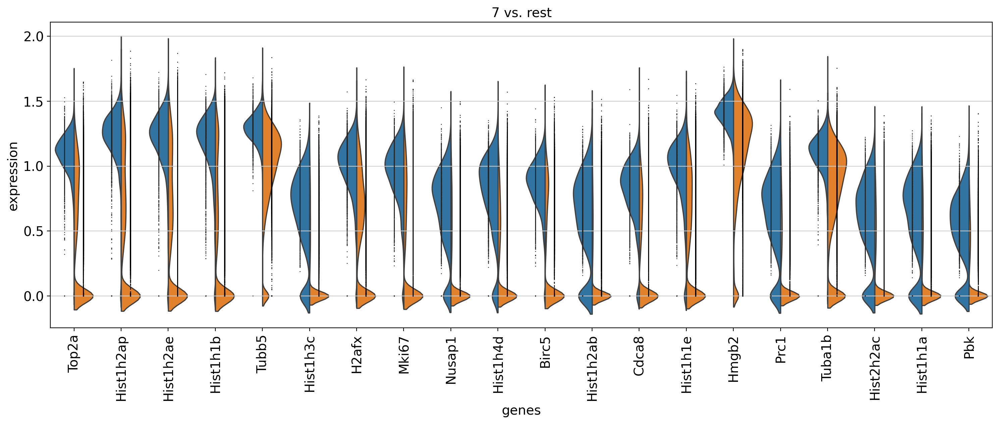

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


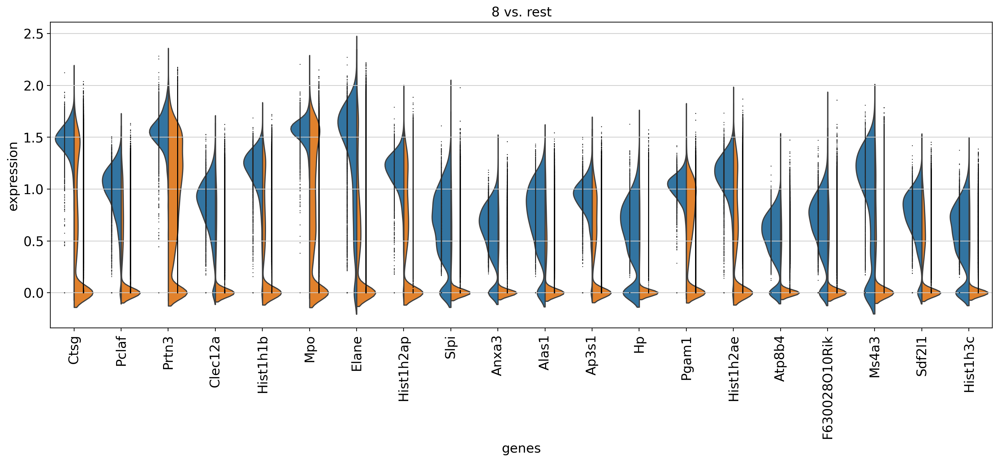

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


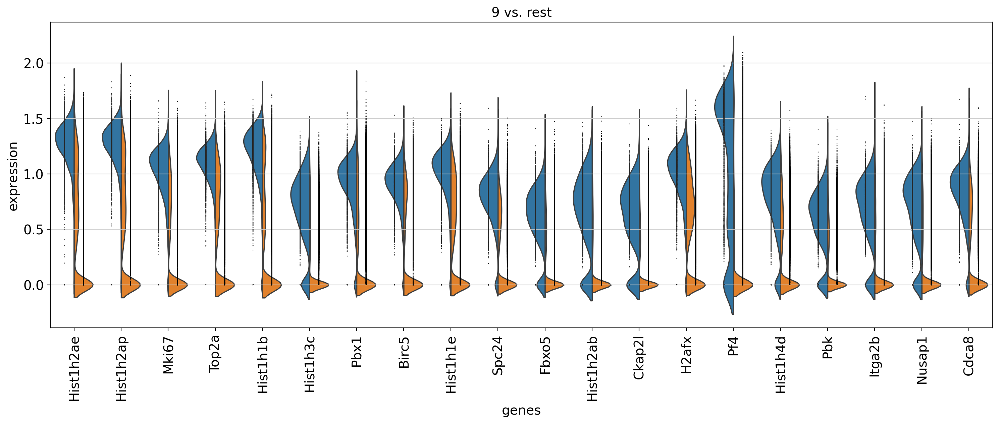

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


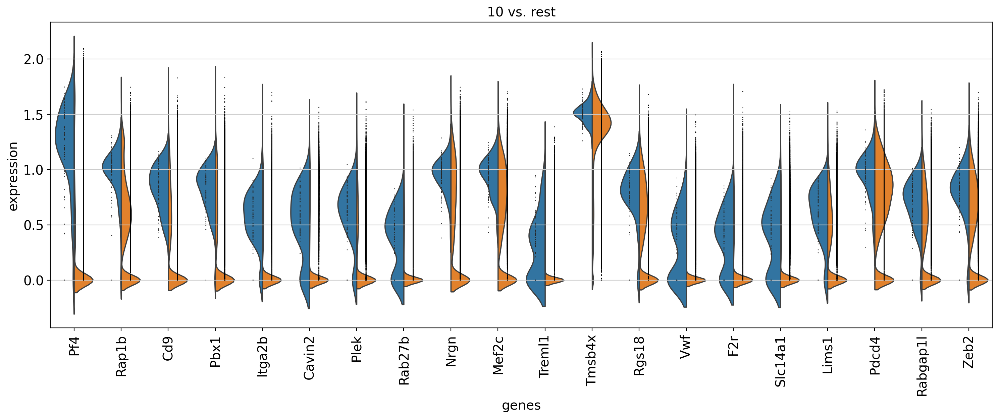

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


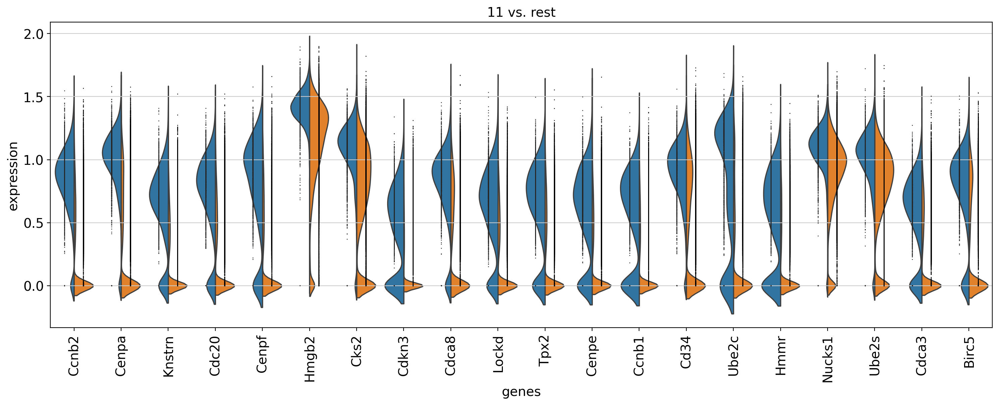

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


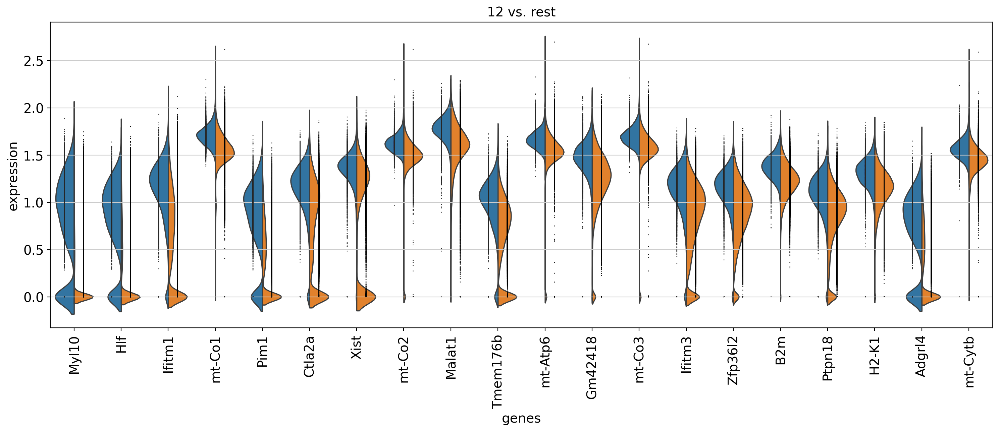

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


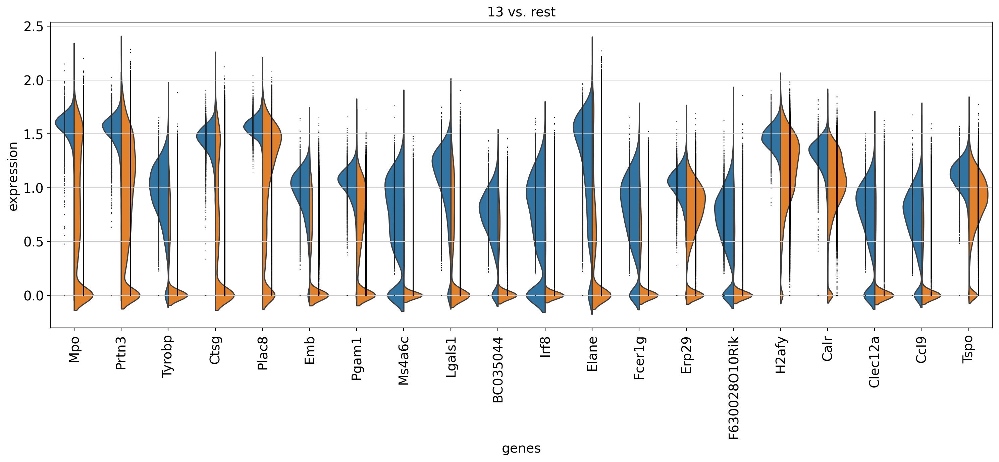

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


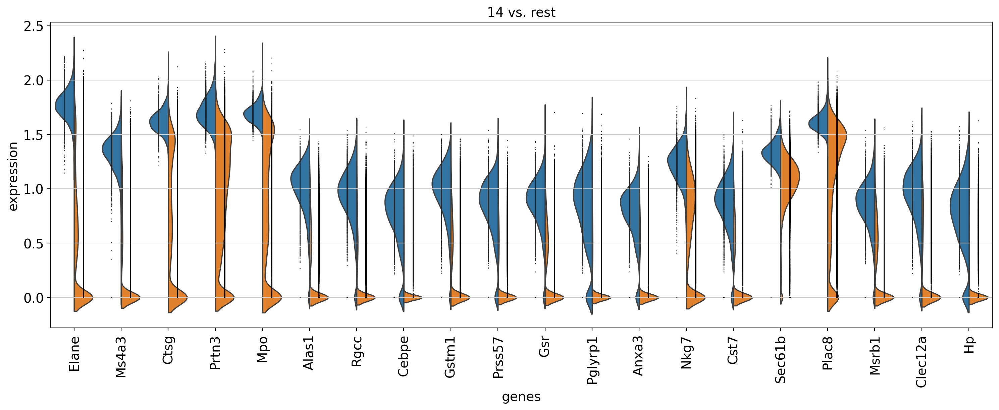

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


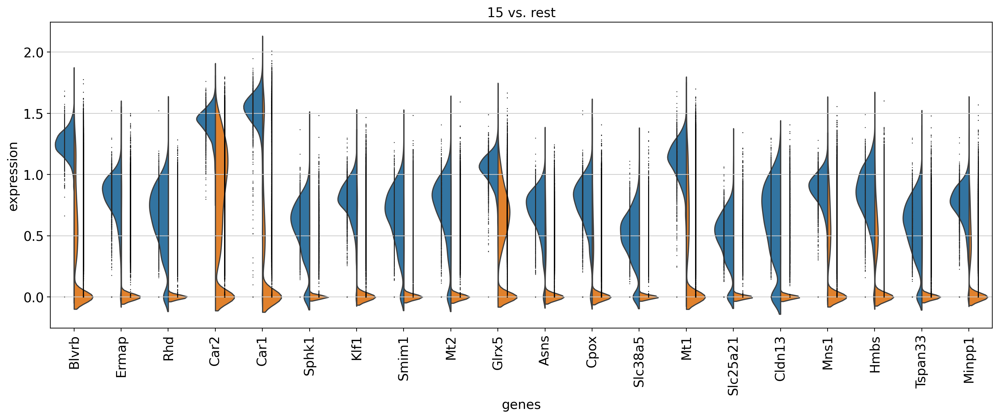

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


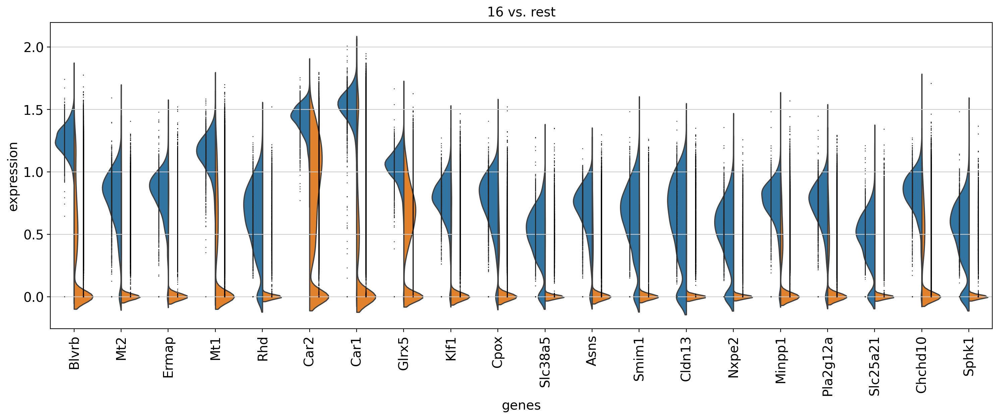

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


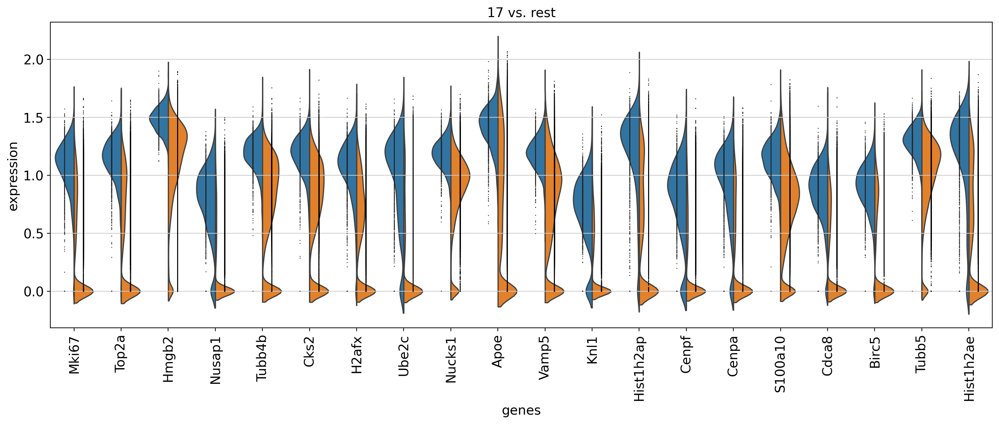

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


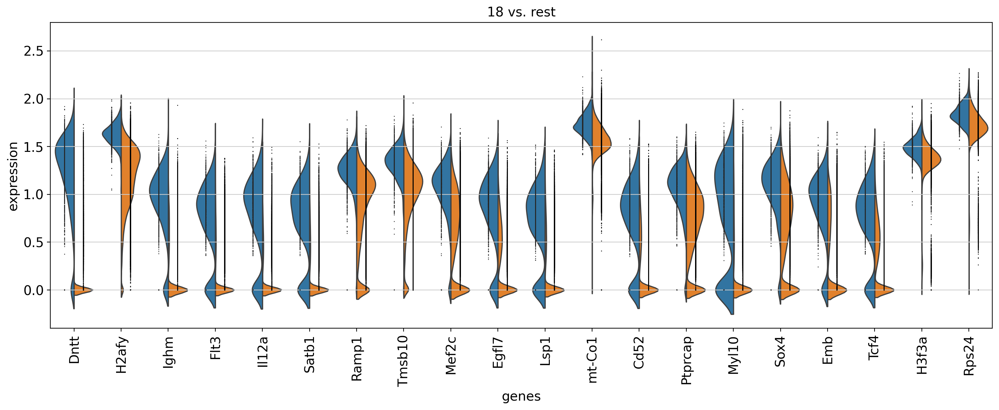

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


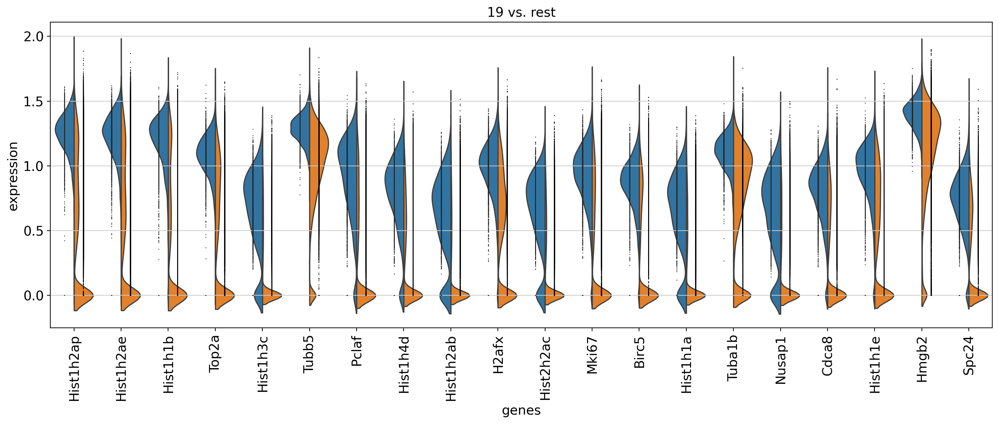

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_tools/__init__.py:1328: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


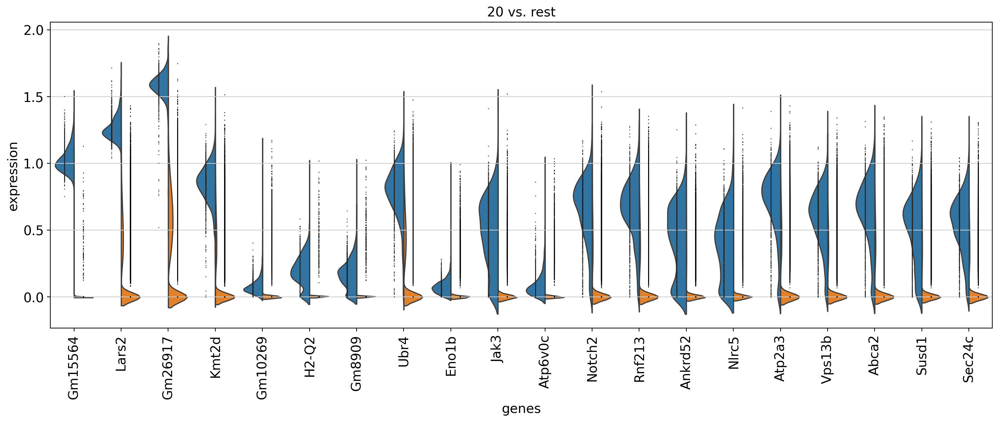

In [60]:
import scanpy as sc
from matplotlib import rc_context

min_cells = 2
counts = adata.obs["leiden"].value_counts()
keep = counts[counts >= min_cells].index
adata_de = adata[adata.obs["leiden"].isin(keep)].copy()

sc.tl.rank_genes_groups(adata_de, groupby="leiden", method="wilcoxon", use_raw=False)

with rc_context({"figure.figsize": (18, 6)}):  # wider figure
    sc.pl.rank_genes_groups_violin(adata_de, n_genes=20, jitter=False)


7. Dendogram options

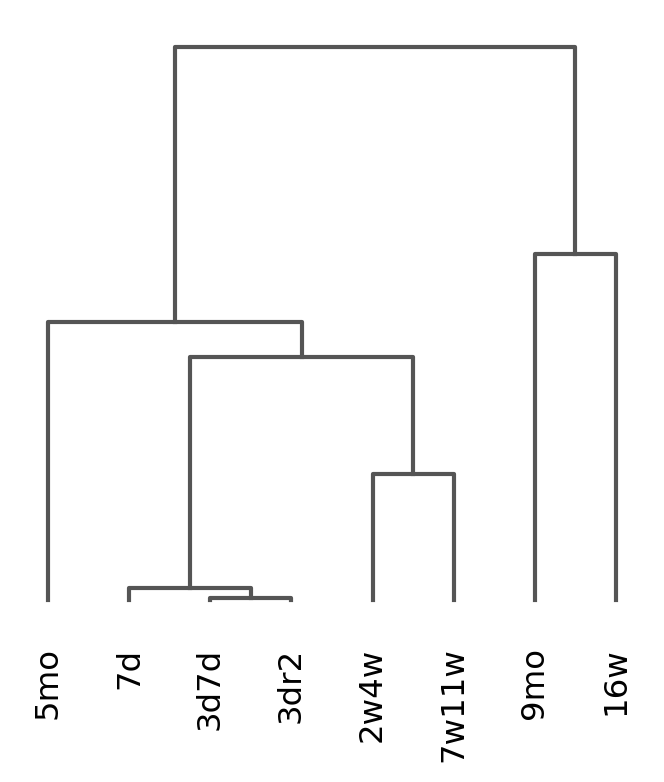

In [61]:
#Most of visualization can arrange categories using a dendogram - however dendograms can also be plotted independently
# compute hierarchical clustering using PCs (several distance metrics and linkage methods are available).

sc.tl.dendrogram(adata, "bulk_labels")
ax = sc.pl.dendrogram(adata, "bulk_labels")


8. Plot correction

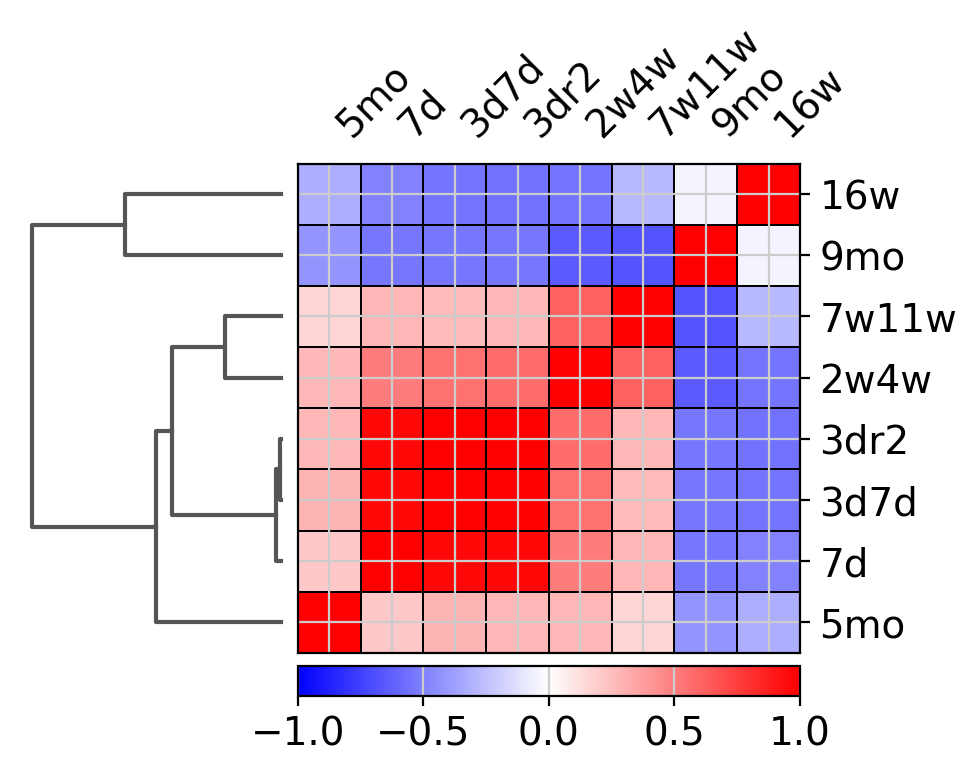

In [62]:
#Together with the dendogram can integrate a heatmap of correlation between categories
ax = sc.pl.correlation_matrix(adata, "bulk_labels", figsize=(5, 3.5))

***

## Customizing plots

1. Figure and Axes objects

In [63]:
#Scanpy plotiting functions can return Figure or the plot object (setting return_fig=True) or Axes (by setting show=False)

#The show parameter regulates the when the ploy is rendered - if we eant to customize Axes after the scanpy plotting function was called we need to set show=False to ensure that the plot will be rendered only after we made all adjustments

#For example, from embedding plots (such as umap) we can obtain either axes (by setting show=False) or whole figure (by setting return_fig=True) that stores axes in figure.axes
#For every plotted category one Axes object will be created and for every continuous category two Axes objects: the UMAP plot and colorbar on the side. However, if we want to obtain the colorbar axes object we need to use return_fig=True rather than show=False.
#When accessing Axes from Figure the returned object is a list and we need to select relevant Axes to modify them. When returning Axes directly we obtain either an individual Axes object or a list of Axes

# Examples of returned objects from the UMAP function

print("Categorical plots:")
axes = sc.pl.umap(adata, color=["bulk_labels"], show=False)
print("Axis from a single category plot:", axes)
plt.close()
axes = sc.pl.umap(adata, color=["bulk_labels", "S_score"], show=False)
print("Axes list from two categorical plots:", axes)
plt.close()
fig = sc.pl.umap(adata, color=["bulk_labels"], return_fig=True)
print("Axes list from a figure with one categorical plot:", fig.axes)
plt.close()

print("\nContinous plots:")
axes = sc.pl.umap(adata, color=["Rp1"], show=False)
print("Axes from one continuous plot:", axes)
plt.close()
fig = sc.pl.umap(adata, color=["Rp1"], return_fig=True)
print("Axes list from a figure of one continous plot:", fig.axes)
plt.close()


Categorical plots:
Axis from a single category plot: Axes(0.18,0.15;0.78x0.76)
Axes list from two categorical plots: [<Axes: title={'center': 'bulk_labels'}, xlabel='UMAP1', ylabel='UMAP2'>, <Axes: title={'center': 'S_score'}, xlabel='UMAP1', ylabel='UMAP2'>]
Axes list from a figure with one categorical plot: [<Axes: title={'center': 'bulk_labels'}, xlabel='UMAP1', ylabel='UMAP2'>]

Continous plots:


Axes from one continuous plot: Axes(0.18,0.15;0.7098x0.76)
Axes list from a figure of one continous plot: [<Axes: title={'center': 'Rp1'}, xlabel='UMAP1', ylabel='UMAP2'>, <Axes: label='<colorbar>'>]


In [64]:
axes = sc.pl.dotplot(adata, ["Cd79a", "Ms4a1"], "bulk_labels", show=False)
print("Axes returned from dotplot object:", axes)
dp = sc.pl.dotplot(adata, ["Cd79a", "Ms4a1"], "bulk_labels", return_fig=True)
print("DotPlot object:", dp)
plt.close()



Axes returned from dotplot object: {'mainplot_ax': <Axes: >, 'size_legend_ax': <Axes: title={'center': 'Fraction of cells\nin group (%)'}>, 'color_legend_ax': <Axes: title={'center': 'Mean expression\nin group'}>}
DotPlot object: <scanpy.plotting._dotplot.DotPlot object at 0x14983a62c3e0>


2. Using matplotlib Axes to customize plot alignment

axes: [<Axes: > <Axes: >]


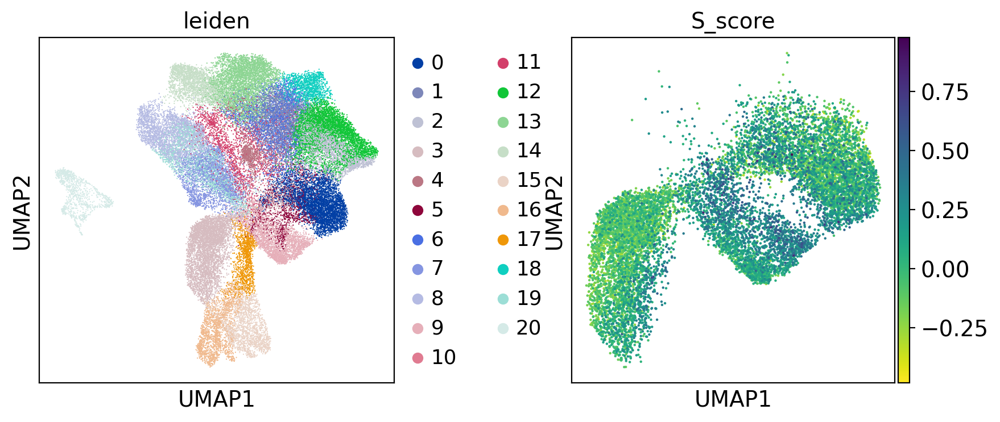

In [65]:
#When combining multiple different plots, can pass pre-defined matplotlib Axes to some plotting functions (ex embedding)
#This can be useful when we want to have custom subplot alignment or want to show side by side two different plot types / two different data subsets

# Define matplotlib Axes
# Number of Axes & plot size
ncols = 2
nrows = 1
figsize = 4
wspace = 0.5
fig, axs = plt.subplots(
    nrows=nrows,
    ncols=ncols,
    figsize=(ncols * figsize + figsize * wspace * (ncols - 1), nrows * figsize),
)
plt.subplots_adjust(wspace=wspace)
# This produces two Axes objects in a single Figure
print("axes:", axs)

# We can use these Axes objects individually to plot on them
# We need to set show=False so that the Figure is not displayed before we
# finished plotting on all Axes and making all plot adjustments
sc.pl.umap(adata, color="leiden", ax=axs[0], show=False)
# Example zoom-in into a subset of louvain clusters
sc.pl.umap(adata[adata.obs.leiden.isin(["0", "3", "9"]), :], color="S_score", ax=axs[1])

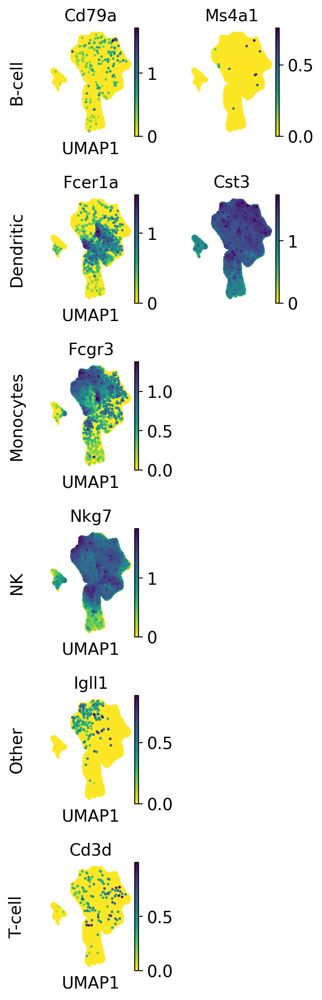

In [66]:
# In this example we want to show UMAPs of different cell type markers,
# with markers of a single cell type in one row
# and with a different number of markers per cell type (row)

# Marker genes
marker_genes = {
    "B-cell": ["Cd79a", "Ms4a1"],
    "Dendritic": ["Fcer1a", "Cst3"],
    "Monocytes": ["Fcgr3"],
    "NK": ["Nkg7"],
    "Other": ["Igll1"],
    # "Plasma": ["Igj"],  # removed – gene not present in dataset
    "T-cell": ["Cd3d"],
}

# Make Axes
nrow = len(marker_genes)
ncol = max([len(vs) for vs in marker_genes.values()])
fig, axs = plt.subplots(nrow, ncol, figsize=(2 * ncol, 2 * nrow))

# Plot expression for every marker on the corresponding Axes object
for row_idx, (cell_type, markers) in enumerate(marker_genes.items()):
    col_idx = 0
    for marker in markers:
        ax = axs[row_idx, col_idx]
        sc.pl.umap(adata, color=marker, ax=ax, show=False, frameon=False, s=20)

        if col_idx == 0:
            ax.axis("on")
            ax.tick_params(
                top="off",
                bottom="off",
                left="off",
                right="off",
                labelleft="on",
                labelbottom="off",
            )
            ax.set_ylabel(cell_type + "\n", rotation=90, fontsize=14)
            ax.set(frame_on=False)

        col_idx += 1

    while col_idx < ncol:
        axs[row_idx, col_idx].remove()
        col_idx += 1

fig.tight_layout()


3. Plot size

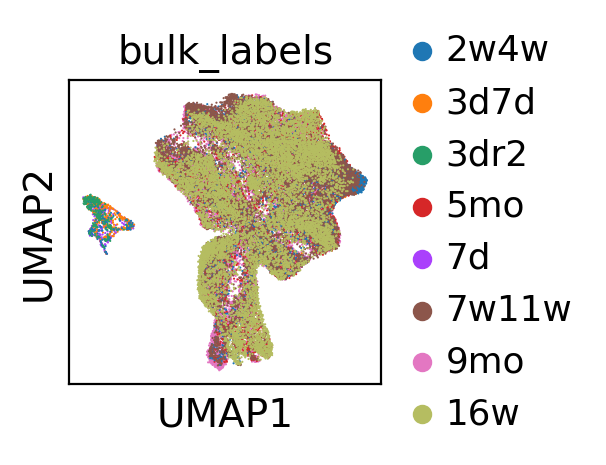

In [67]:
#There are multiple options for adjusting plot size
#We can adjust plot size by setting rcParams[’figure.figsize’] which is will also change settings for future plots. 
#These are either available through scanpys set_figure_params() which wraps Matplotlib’s rcParams or by modifying them directly
from matplotlib import rcParams

# save original figsize
FIGSIZE = rcParams["figure.figsize"]

# set small figure size
rcParams["figure.figsize"] = (2, 2)
sc.pl.umap(adata, color="bulk_labels")

# restore original figsize
rcParams["figure.figsize"] = FIGSIZE


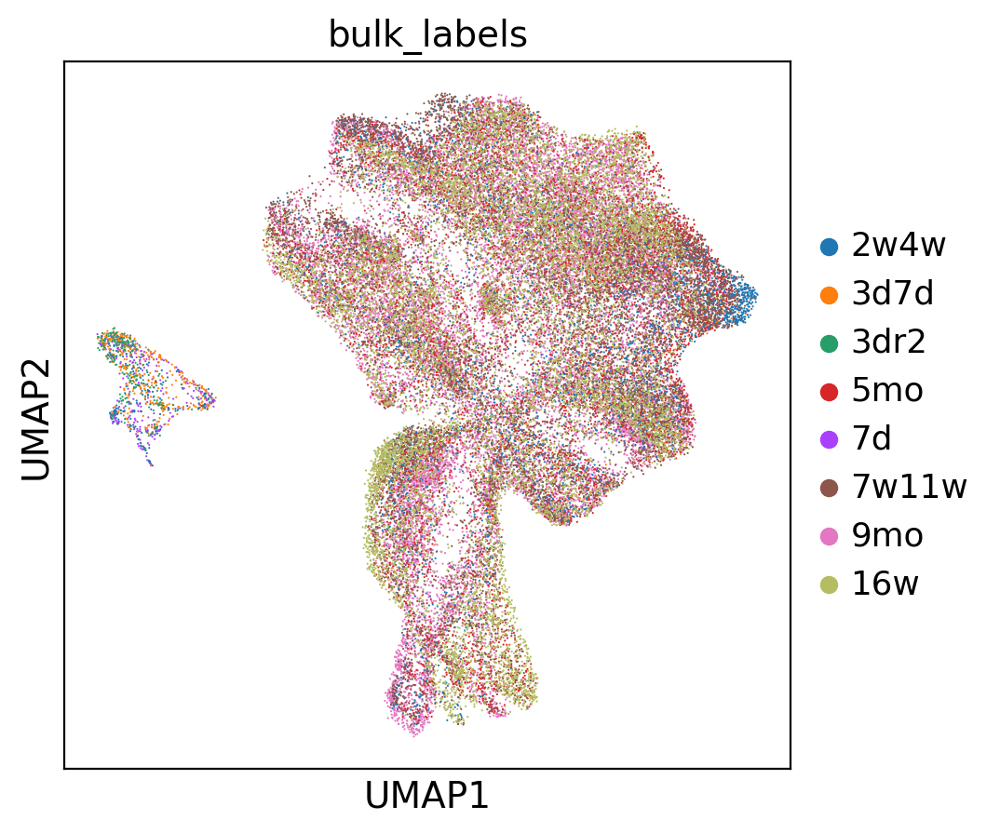

In [68]:
#We can set rcParams for a single plot with a context manager which won’t change the setting for future plots
with plt.rc_context({"figure.figsize": (5, 5)}):
    sc.pl.umap(adata, color="bulk_labels")

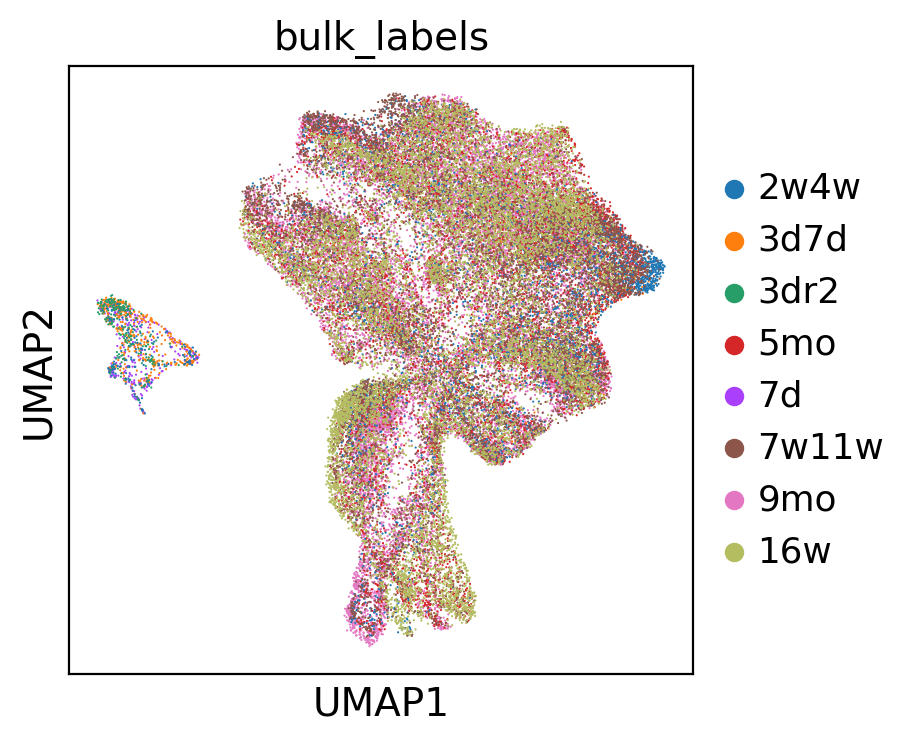

In [69]:
#We can also create an Axes object with a predeffined size and pass it to a scanpyy plotting function
fig, ax = plt.subplots(figsize=(4, 4))
sc.pl.umap(adata, color="bulk_labels", ax=ax)

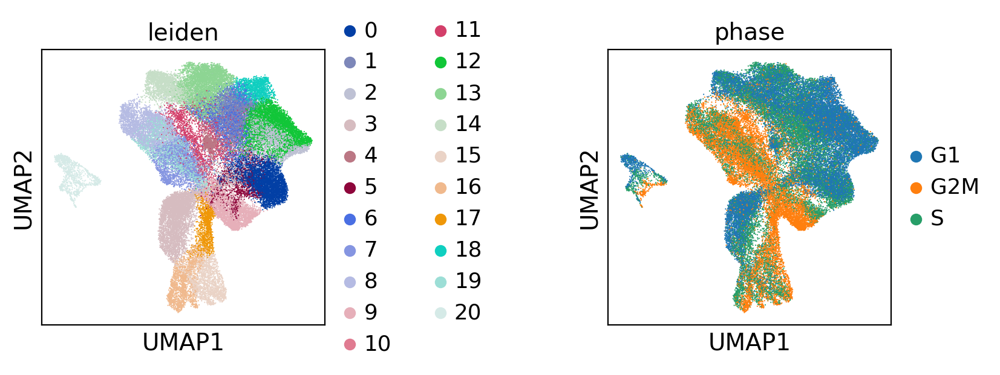

In [70]:
#The figsize is divided between all Axes and spaces between them. Thus, if we have multiple Axes (columns and rows) we must accordingly increase figzise
#However, if we do not pass Axes objects to scanpy embeddings function it will automatically create individual Axes with the size of the current global figsize
ncol = 2
nrow = 1
figsize = 3
wspace = 1
# Adapt figure size based on number of rows and columns and added space between them
# (e.g. wspace between columns)
fig, axs = plt.subplots(nrow, ncol, figsize=(ncol * figsize + (ncol - 1) * wspace * figsize, nrow * figsize))
plt.subplots_adjust(wspace=wspace)
sc.pl.umap(adata, color="leiden", ax=axs[0], show=False)
sc.pl.umap(adata, color="phase", ax=axs[1])

4. Adjust space between subplots

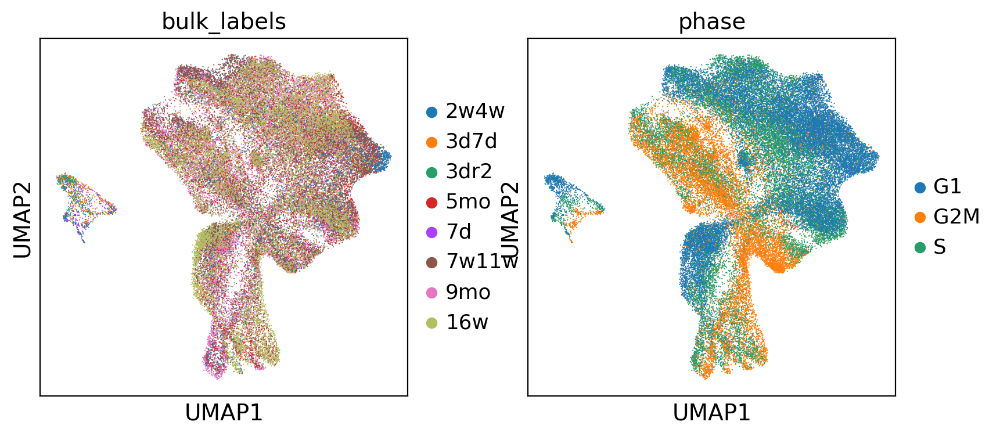

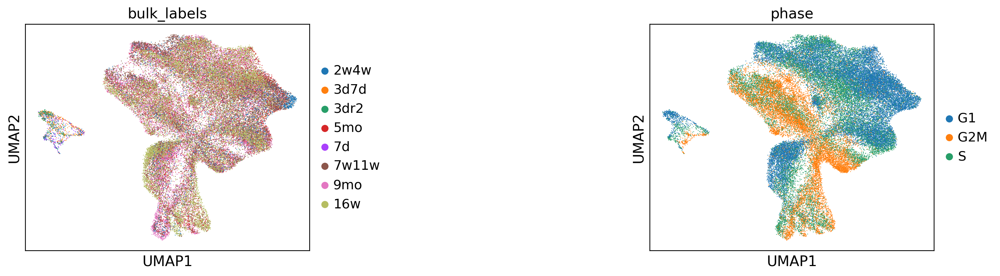

In [71]:
#When plotting multiple plots (ex with embedding) in the same row / column it may happen that the legend overlaps with the neighbouring plot.
#This can be overcomed by setting wspace (width) or hspace (height). These parameters can be likewise used when creating Axes for plotting

# Default, legend is overlapping
sc.pl.umap(adata, color=["bulk_labels", "phase"])

# Increase gap size between plots
sc.pl.umap(adata, color=["bulk_labels", "phase"], wspace=1)

5. Adapt axes appearance

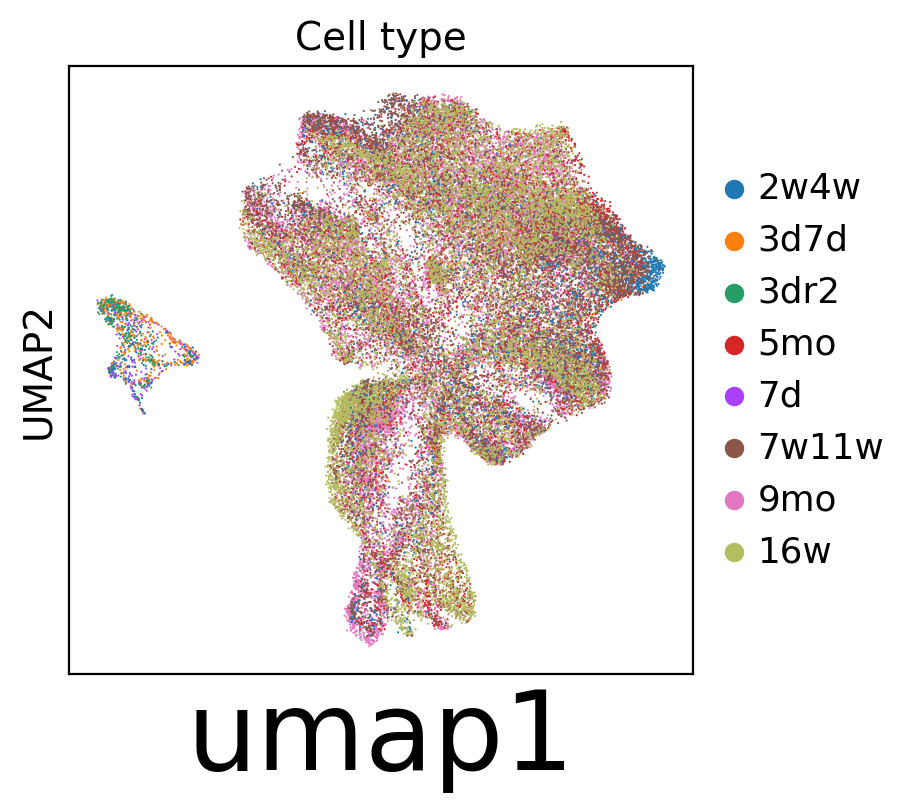

In [72]:
#We can further modify the plot object to change axis text, title size, font type (ex italic), font color ect
#For further details on customizing Axes and Figure objectxs see matplotlib documentation

#Some scanpy plotting functions already have predefined parameters for adjusting plot appearance. 
#For example, embedding enables setting of titles with the title paarmeter and transaparent plotting woith teh frameon parameter

# Set title with the title parameter
# Return Axes to further modify the plot
ax = sc.pl.umap(adata, color="bulk_labels", title="Cell type", show=False)
# Modify xlabel
_ = ax.set_xlabel("umap1", fontsize=40)

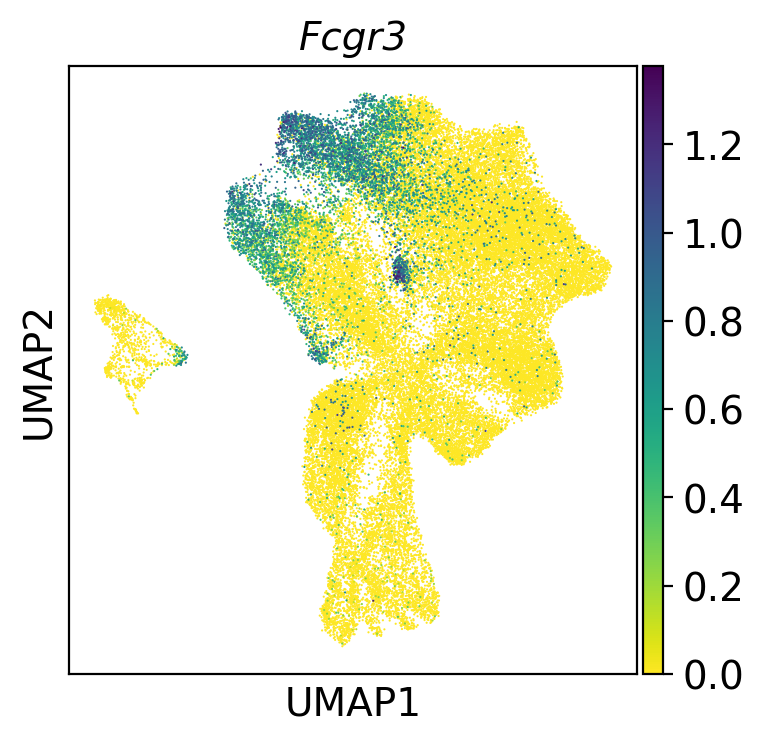

In [73]:
# Make title italic
ax = sc.pl.umap(adata, color="Fcgr3", show=False)
_ = ax.set_title("Fcgr3", style="italic")

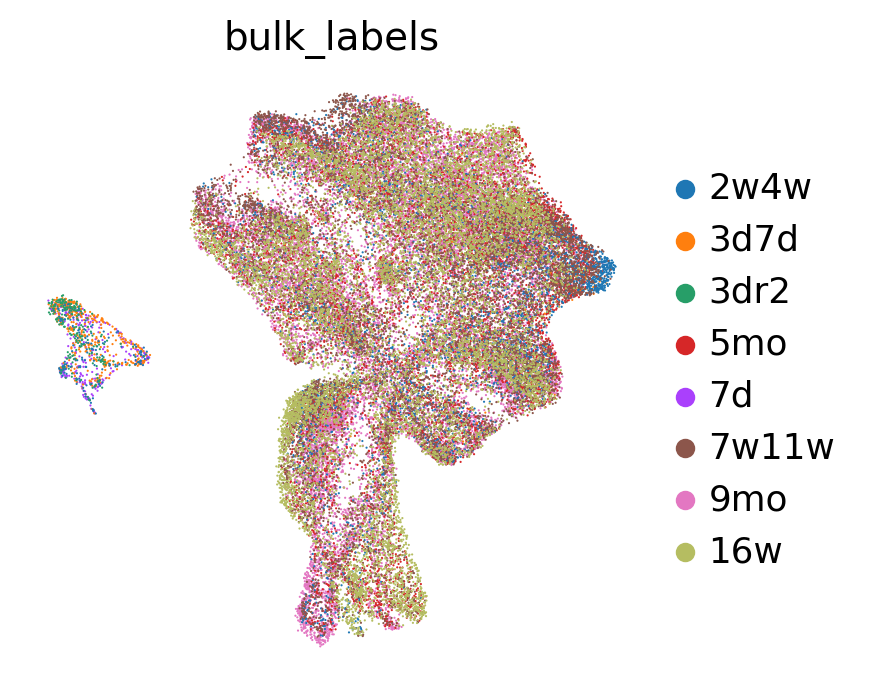

In [74]:
# Transparent background and no borders/axis labels with frameon=False
sc.pl.umap(adata, color="bulk_labels", frameon=False)

Dotplot axes: {'mainplot_ax': <Axes: >, 'size_legend_ax': <Axes: title={'center': 'Fraction of cells\nin group (%)'}>, 'color_legend_ax': <Axes: title={'center': 'Mean expression\nin group'}>}


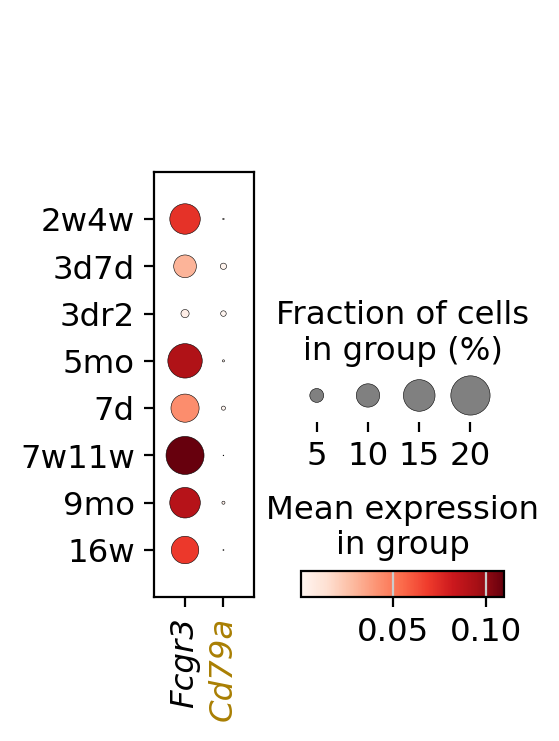

In [75]:
#We can also change apperance (ex colour) of individual axis labels. 
#This may be of special interest for plots like dotplot where we show multiple genes or cell groups and we want to highlight some of them

dp = sc.pl.dotplot(adata, ["Fcgr3", "Cd79a"], "bulk_labels", show=False)
# All Axes used in dotplot
print("Dotplot axes:", dp)
# Select the Axes object that contains the subplot of interest
ax = dp["mainplot_ax"]
# Loop through ticklabels and make them italic
for l in ax.get_xticklabels():
    l.set_style("italic")
    g = l.get_text()
    # Change settings (e.g. color) of certain ticklabels based on their text (here gene name)
    if g == "Cd79a":
        l.set_color("#A97F03")

## Labels and legends

1. Customizing legends

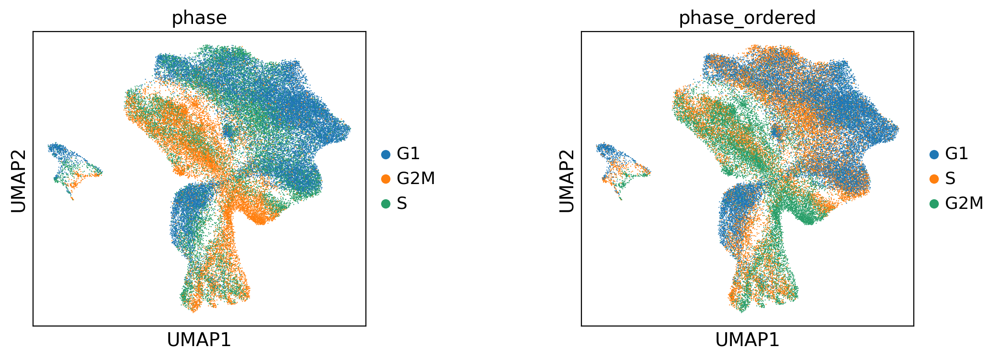

In [76]:
#We can define order of groups in scanpy legend by setting order of rgoups (categories) in the corresponding obs column in the pandas DataFrame
# The default ordering of cell cycle phases is alphabetical
# To ensure that the ordering corresponds to cell cycle define order of categories;
# this should include all categories in the corresponding pandas table column
phases = ["G1", "S", "G2M"]
adata.obs["phase_ordered"] = pd.Categorical(values=adata.obs.phase, categories=phases, ordered=True)
sc.pl.umap(adata, color=["phase", "phase_ordered"], wspace=0.5)
# This just removes the newly added ordered column from adata as we do not need it below
del adata.obs["phase_ordered"]

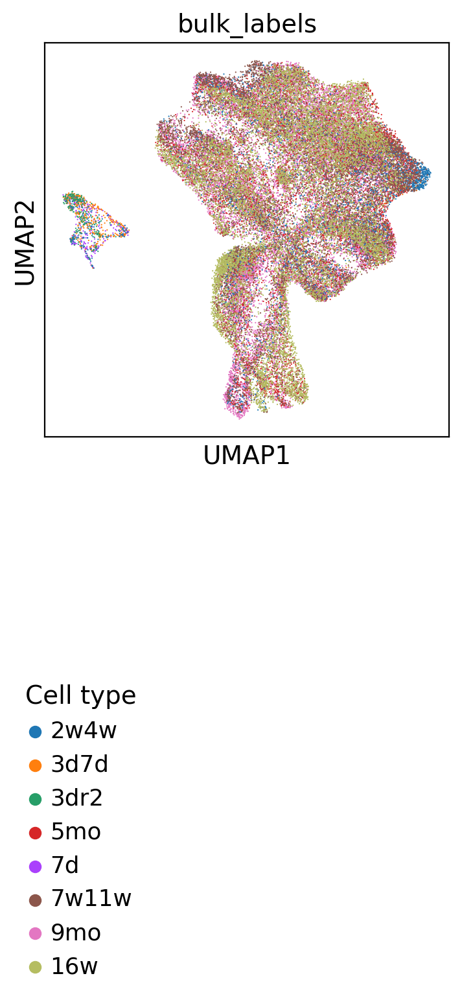

In [77]:
#Change the legend title and move the legend to a different location
fig = sc.pl.umap(adata, color=["bulk_labels"], return_fig=True)
ax = fig.axes[0]
ax.legend_.set_title("Cell type")
# Change Legend location
ax.legend_.set_bbox_to_anchor((-0.1, -1)) #these move the legend left/right and up/down

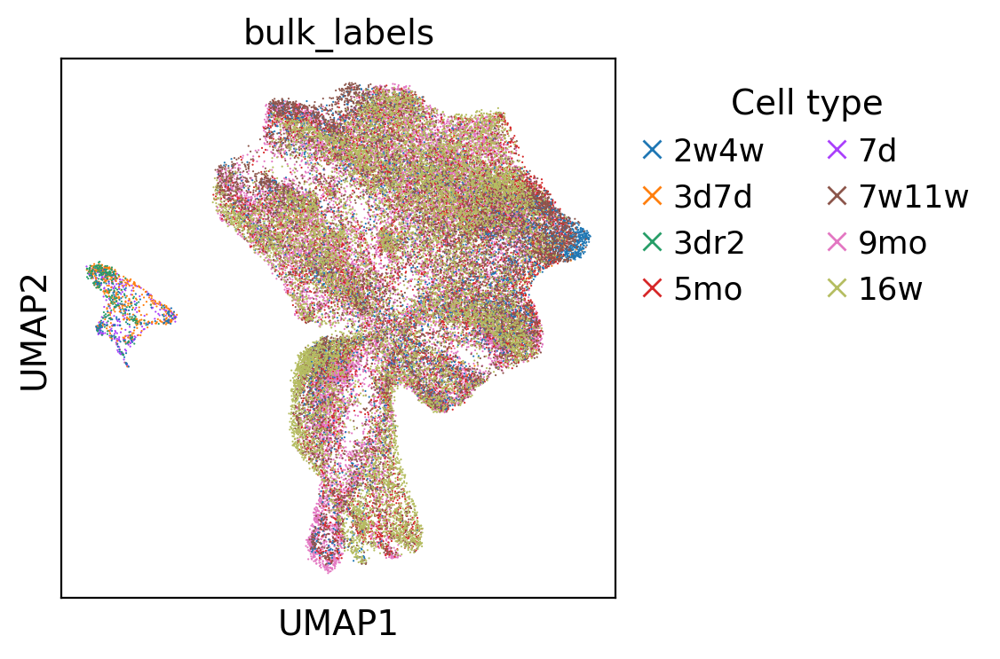

In [78]:
#Make a customized legend by replacing the legend instance in the plot
#In case we want to add multiple legends instances, we need to use plt.gca().add_artist(legend)
from matplotlib.lines import Line2D


fig = sc.pl.umap(adata, color=["bulk_labels"], return_fig=True)
ax = fig.axes[0]
# Remove original Legend
ax.legend_.remove()
# Make new Legend
l1 = ax.legend(
    # Add Legend element for each color group
    handles=[
        # Instead of Line2D we can also use other matplotlib objects, such as Patch, etc.
        Line2D(
            [0],
            [0],
            marker="x",
            color=c,
            lw=0,
            label=l,
            markerfacecolor=c,
            markersize=7,
        )
        # Color groups in adata
        for l, c in zip(list(adata.obs.bulk_labels.cat.categories), adata.uns["bulk_labels_colors"], strict=True)
    ],
    # Customize Legend outline
    # Remove background
    frameon=False,
    # Make more Legend columns
    ncols=2,
    # Change location to not overlap with the plot
    bbox_to_anchor=(1, 1),
    # Set title
    title="Cell type",
)

2. Annotating scatterplots

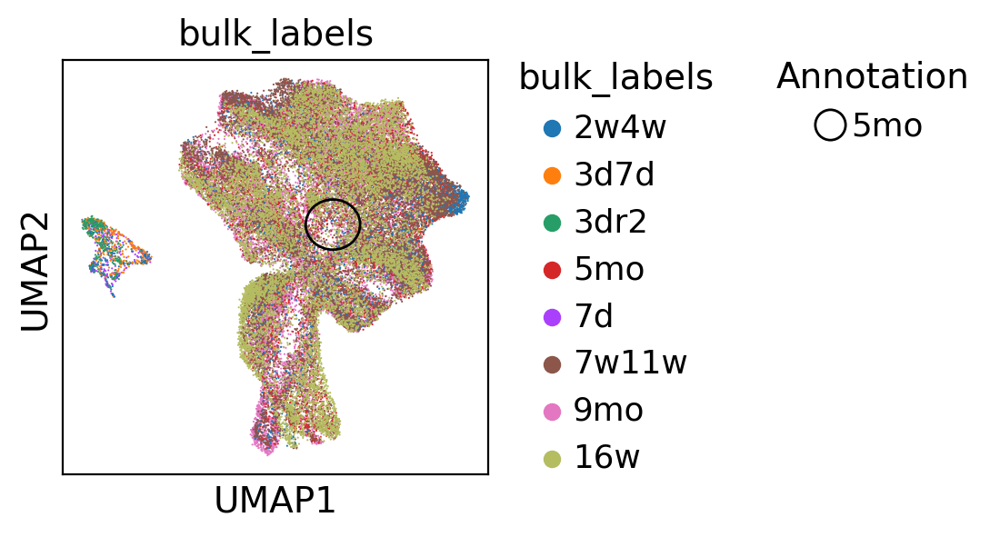

In [79]:
#We can plot on top of already existing plots to mark objects

#Here we show hot to circle a single object on the plot and then add a new Legend to explain the mark

import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

fig, ax = plt.subplots(figsize=(3, 3))
sc.pl.umap(adata, color=["bulk_labels"], ax=ax, show=False)

# Encircle 5mo cells
location_cells = adata[adata.obs["bulk_labels"] == "5mo", :].obsm["X_umap"]
x = location_cells[:, 0].mean()
y = location_cells[:, 1].mean()
size = 1.5  # adjust if needed

circle = plt.Circle((x, y), size, color="k", clip_on=False, fill=False)
ax.add_patch(circle)

# Save the original legend
l1 = ax.get_legend()
l1.set_title("bulk_labels")

# Add a new legend for the circle
l2 = ax.legend(
    handles=[
        Line2D(
            [0],
            [0],
            marker="o",
            color="k",
            markerfacecolor="none",
            markersize=12,
            markeredgecolor="k",
            lw=0,
            label="5mo",
        )
    ],
    frameon=False,
    bbox_to_anchor=(2.2, 1.07),
    title="Annotation",
)

_ = plt.gca().add_artist(l1)

Axes: Axes(0.145666,0.15;0.569556x0.76)


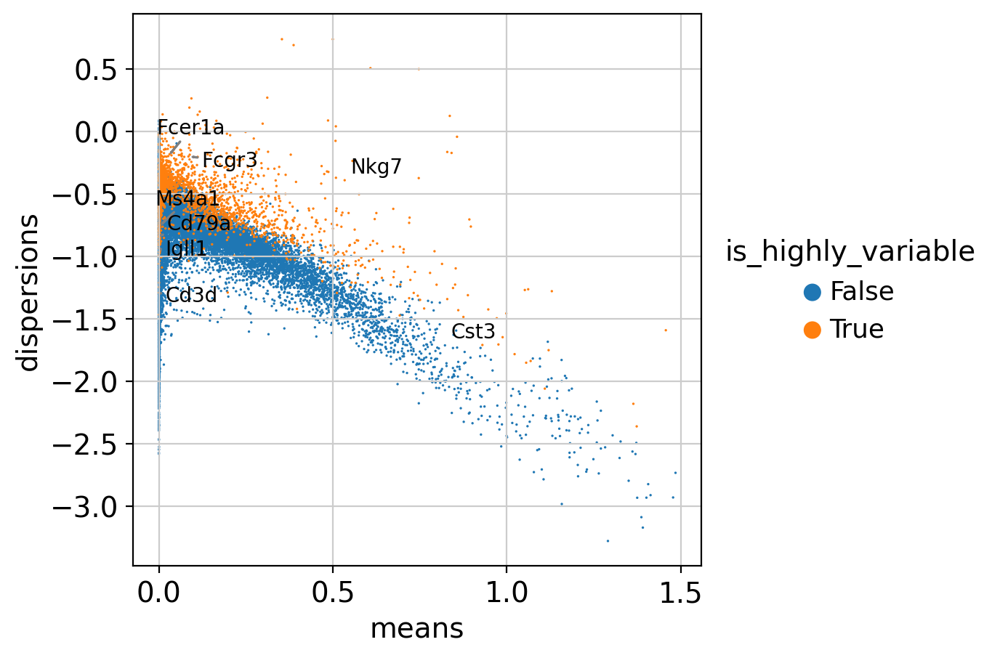

In [80]:
#We cal also use external packages to help us mark objects - ex adjustText
#adjusText enables annotation of multiple nearby plots locations while minimising text overlap
# Package used for adding well aligned labels on the plot
from adjustText import adjust_text


with plt.rc_context({"figure.figsize": (5, 5)}):
    x = "means"
    y = "dispersions"
    color = "is_highly_variable"
    adata.var["is_highly_variable"] = adata.var["highly_variable"].astype(bool).astype(str)
    ax = sc.pl.scatter(adata, x=x, y=y, color=color, show=False)
    print("Axes:", ax)
    # Move plot title from Axes to Legend
    ax.set_title("")
    ax.get_legend().set_title(color)

    # Labels

    # Select genes to be labeled (mouse genes)
    texts = []
    genes = [
        "Cd79a",
        "Ms4a1",
        "Fcer1a",
        "Cst3",
        "Fcgr3",
        "Nkg7",
        "Igll1",
        "Cd3d",
    ]
    for gene in genes:
        # Position of object to be marked
        x_loc = adata.var.loc[gene, x]
        y_loc = adata.var.loc[gene, y]
        # Text color
        color_point = "k"
        texts.append(ax.text(x_loc, y_loc, gene, color=color_point, fontsize=10))

    # Label selected genes on the plot
    _ = adjust_text(
        texts,
        expand=(1.2, 1.2),
        arrowprops=dict(color="gray", lw=1),
        ax=ax,
    )



## Colours

1. Discrete palettes

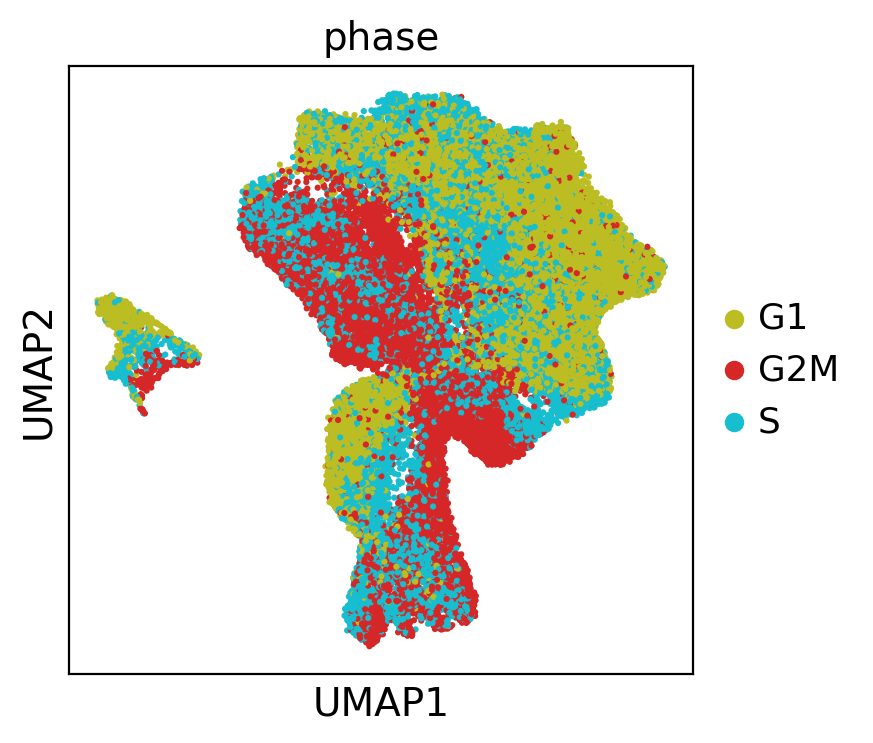

In [81]:
#We can define colours for indvidual categories in scanpy with a dictionary
sc.pl.umap(
    adata,
    color="phase",
    s=20,
    palette={"S": "tab:cyan", "G1": "tab:olive", "G2M": "tab:red"},
)


2. Continuous palettes

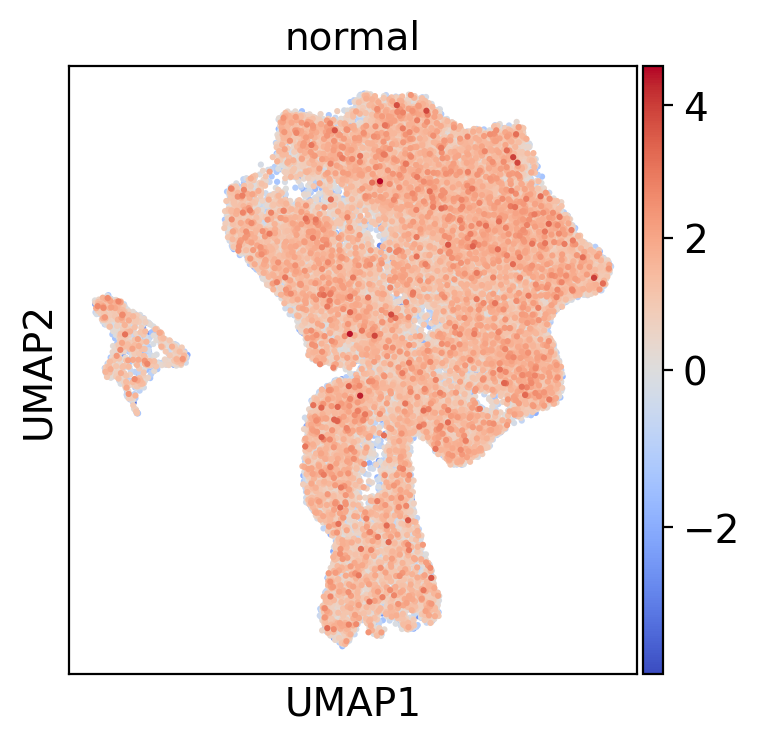

In [82]:
#For non-cenetered data we recommend virids palettes as they are perceptually uniform and colorblind friendly.
#For cenetered values we recommend diverging palettes where the center of the palette should be set to match the center value (ex 0)

#We can center diverging palette in scanpy with vcenter.
# Center palette with vcenter

import numpy as np

# Make mock column for plotting, here we use random values from normal distribution
loc = 0
rng = np.random.default_rng()

adata.obs["normal"] = rng.normal(loc=loc, size=adata.shape[0])

# Center at mean (loc) of the distribution with vcenter parameter
sc.pl.umap(adata, color="normal", cmap="coolwarm", s=20, vcenter=loc)


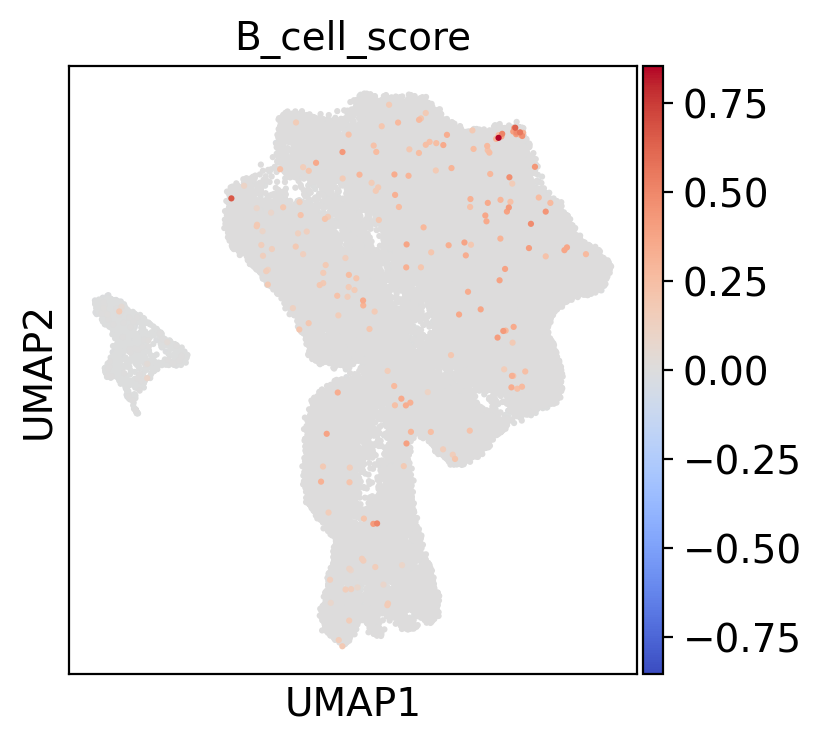

In [85]:
# Make symmetric palette with vmin and vmax

# Make mock column for plotting, here we use B cell score
sc.tl.score_genes(adata, ["Cd79a", "Ms4a1"], score_name="B_cell_score")

# To make a symmetric palette centerd around 0 we set vmax to maximal absolut value and vmin to
# the negative value of maxabs
maxabs = max(abs(adata.obs["B_cell_score"]))
sc.pl.umap(adata, color="B_cell_score", cmap="coolwarm", s=20, vmin=-maxabs, vmax=maxabs)
del adata.obs["B_cell_score"]

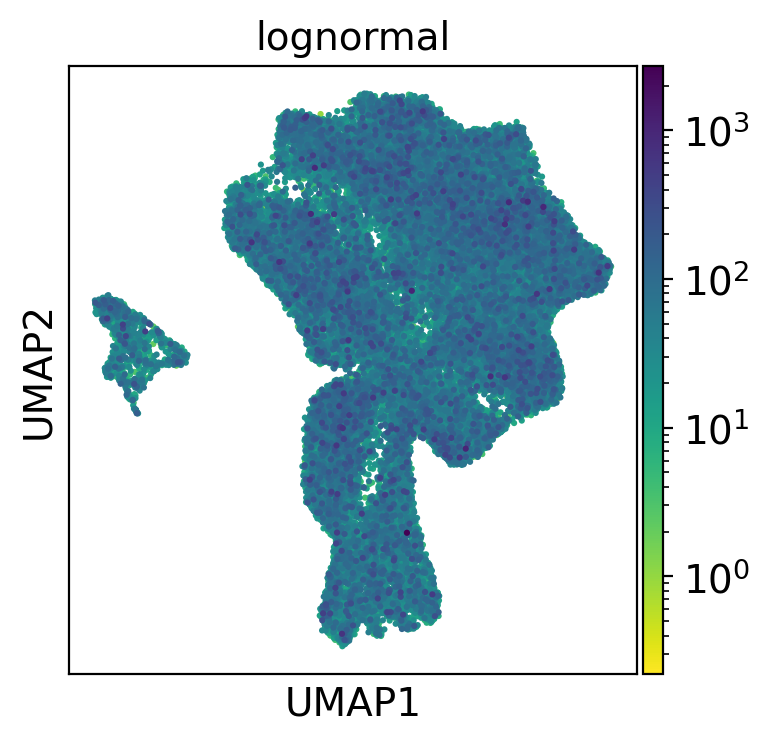

In [86]:
#Matlibplot also supports custom made palettes with scaling (ex log), value range normalisation, centering, and custom colour combinations or dynamic ranges
# Log-scaled palette

# Make mock column with log-normally distirbuited values
adata.obs["lognormal"] = rng.lognormal(3, 1, adata.shape[0])
import matplotlib.colors as mcolors

# Log scaling of the palette
norm = mcolors.LogNorm()
sc.pl.umap(adata, color="lognormal", s=20, norm=norm)

del adata.obs["lognormal"]

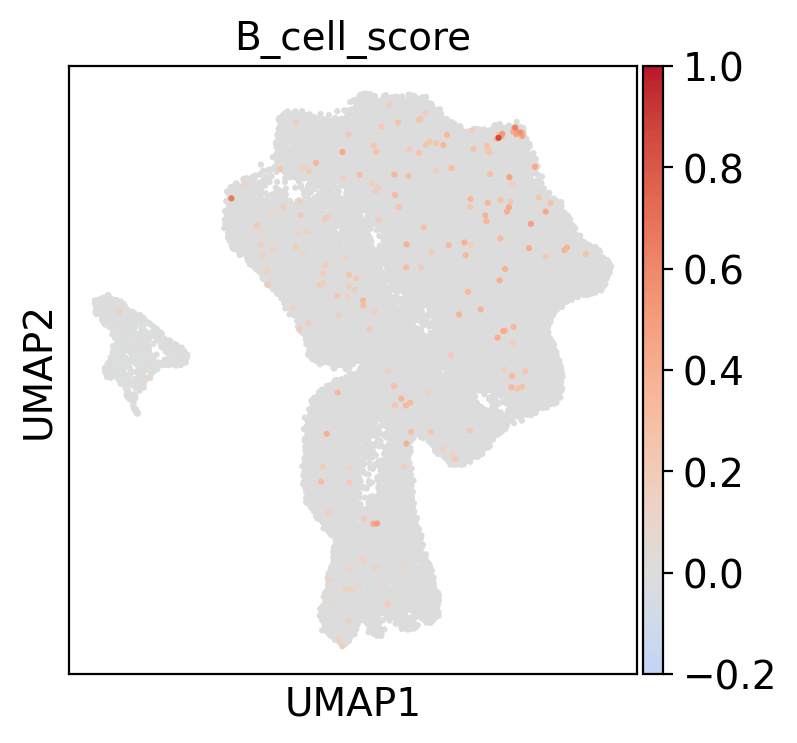

In [90]:
from typing import TYPE_CHECKING
import numpy as np
import matplotlib.colors as mcolors

if TYPE_CHECKING:
    from numpy.typing import ArrayLike
else:
    ArrayLike = object

# Centered non-symmetric palette

# Make mock column for plotting, here we use B cell score
sc.tl.score_genes(adata, ["Cd79a", "Ms4a1"], score_name="B_cell_score")


# Palette normalization with centering and adapted dynamic range to correspond to
# the distance of vmin and vmax from the cenetr
# Adapted from https://stackoverflow.com/a/50003503
class MidpointNormalize(mcolors.Normalize):
    vmin: float
    vmax: float
    midpoint: float

    def __init__(
        self, vmin: float | None = None, vmax: float | None = None, *, midpoint: float = 0, clip: bool = False
    ) -> None:
        self.midpoint = midpoint
        super().__init__(vmin, vmax, clip=clip)

    def __call__(self, value: ArrayLike, clip: object = None) -> np.ma.MaskedArray:
        del clip
        value = np.array(value).astype(float)
        normalized_min = max(
            0.0,
            0.5 * (1.0 - abs((self.midpoint - self.vmin) / (self.midpoint - self.vmax))),
        )
        normalized_max = min(
            1.0,
            0.5 * (1.0 + abs((self.vmax - self.midpoint) / (self.midpoint - self.vmin))),
        )
        normalized_mid = 0.5
        x, y = (
            [self.vmin, self.midpoint, self.vmax],
            [normalized_min, normalized_mid, normalized_max],
        )
        return np.ma.masked_array(np.interp(value, x, y))


vmin = adata.obs["B_cell_score"].min()
vmax = adata.obs["B_cell_score"].max()
vpadding = (vmax - vmin) * 0.2
norm = MidpointNormalize(vmin=vmin - vpadding, vmax=vmax + vpadding, midpoint=0)

fig = sc.pl.umap(
    adata,
    color="B_cell_score",
    cmap="coolwarm",
    s=20,
    norm=norm,
    return_fig=True,
    show=False,
)

cmap_yticklabels = np.array([t.get_position()[1] for t in fig.axes[1].get_yticklabels()])
fig.axes[1].set_ylim(
    max(cmap_yticklabels[cmap_yticklabels < vmin]),
    min(cmap_yticklabels[cmap_yticklabels > vmax]),
)

del adata.obs["B_cell_score"]


3. Colourblind friendly palettes

In [ ]:
#Look up continuous virids palettes and discrete bokeh palettes
#Tools: Coloring for Colorblindess, Color Oracle

## UMAP

1. Coloring cell subset

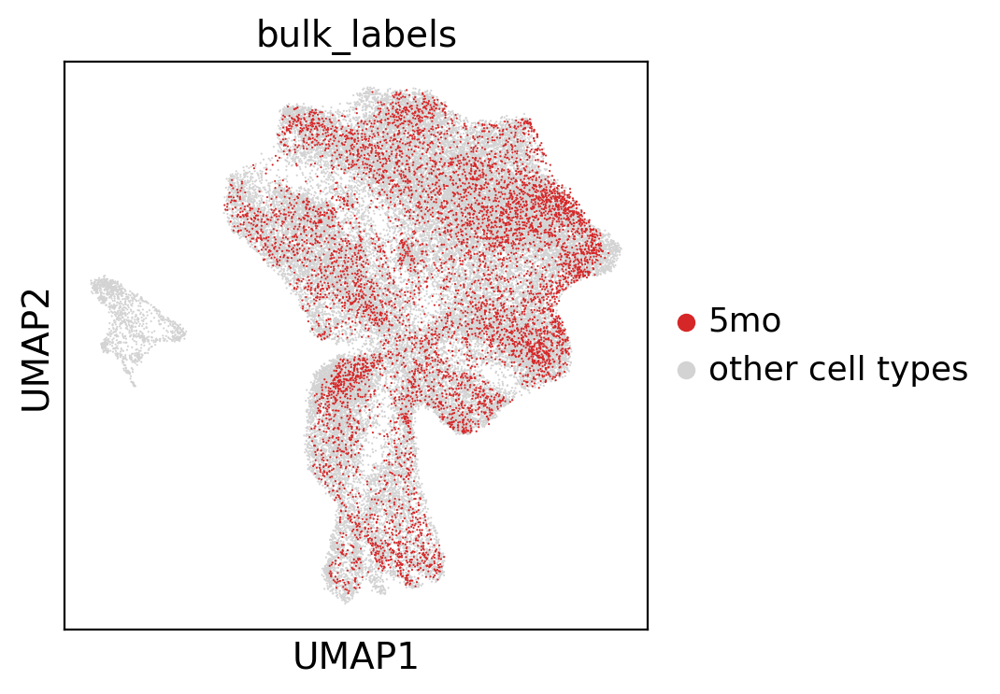

In [94]:
#Here we show how we can plot all cells as a background and then plit on top individual cell groups in colour
#We can colour-in only specific cell groups when using categorical colours with the groups parameter
ax = sc.pl.umap(adata, color=["bulk_labels"], groups=["5mo"], show=False)

# We can change the 'NA' in the legend that represents all cells outside of the
# specified groups
legend_texts = ax.get_legend().get_texts()
# Find legend object whose text is "NA" and change it
for legend_text in legend_texts:
    if legend_text.get_text() == "NA":
        legend_text.set_text("other cell types")

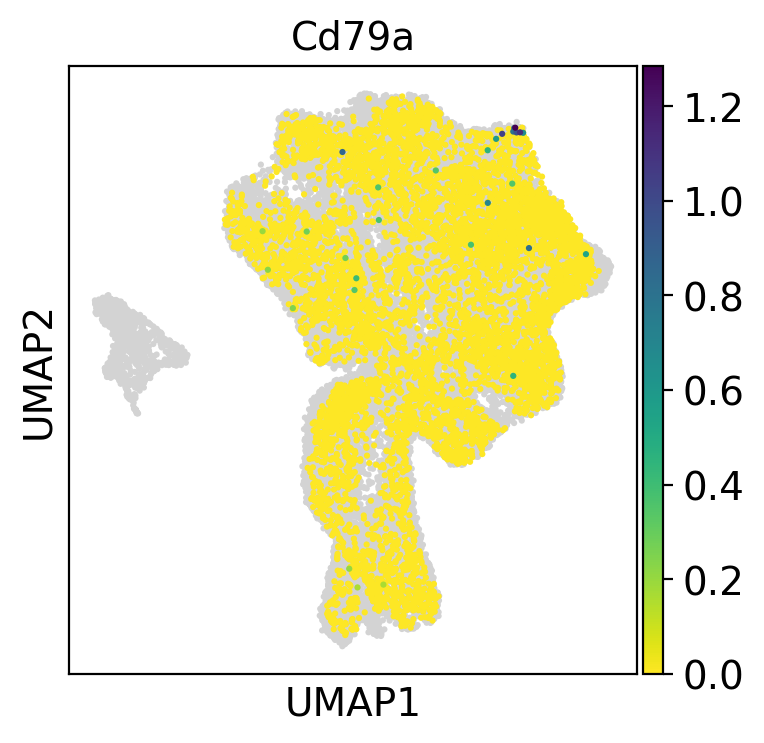

In [97]:
#We can also plot continuous values of an indvidual cell group using obs_mask key word argument
sc.pl.umap(adata, color="Cd79a", mask_obs=(adata.obs.bulk_labels == "5mo"), size=20)

2. Cell ordering

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"{value_to_plot}_colors"] = colors_list


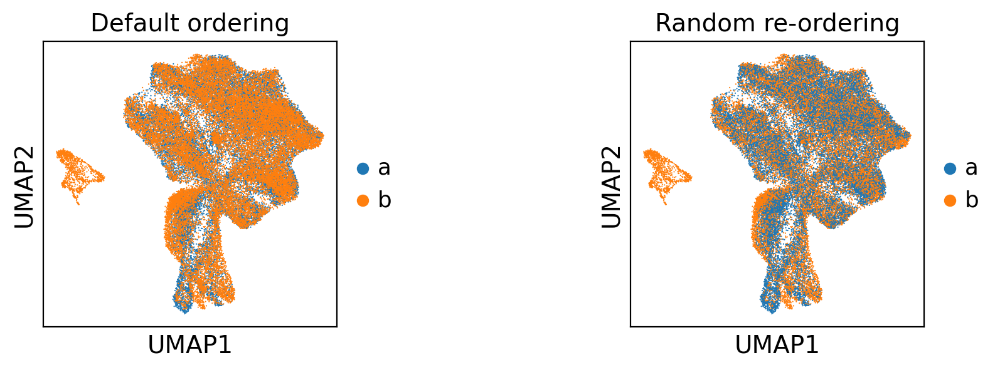

In [98]:
#embedding allows sorting based on continuous value to plot cells with the highest score on top
#However, for categorical values embedding currently does not offer special ordering parameters
#Instead - cells are plotted in same order as they are stored in AnnData
#So we can concatente two AnnData objects of two batches and we want to visualise the location of batches
#One of the batches will be plotted on top of another - so we first need to reorder cells to ensure both batches will be visible

# Make two batches in the adata object for the plot example
adata.obs["batch"] = ["a"] * int(adata.shape[0] / 2) + ["b"] * (adata.shape[0] - int(adata.shape[0] / 2))

fig, axs = plt.subplots(1, 2, figsize=(9, 3))
plt.subplots_adjust(wspace=1)
sc.pl.umap(adata, color="batch", ax=axs[0], title="Default ordering", show=False)
# Randomly order cells by making a random index and subsetting AnnData based on it
# Set a random seed to ensure that the cell ordering will be reproducible
random_indices = np.random.default_rng(0).permutation(list(range(adata.shape[0])))
sc.pl.umap(adata[random_indices, :], color="batch", ax=axs[1], title="Random re-ordering")

3. Optimising UMAP layout

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/umap/umap_.py:1401: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/umap/umap_.py:1401: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/umap/umap_.py:1407: OptimizeWarning: Covariance of the parameters could not be estimated
  params, covar = curve_fit(curve, xv, yv)
/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/umap/umap_.py:1401: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/umap/umap_.py:1401: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


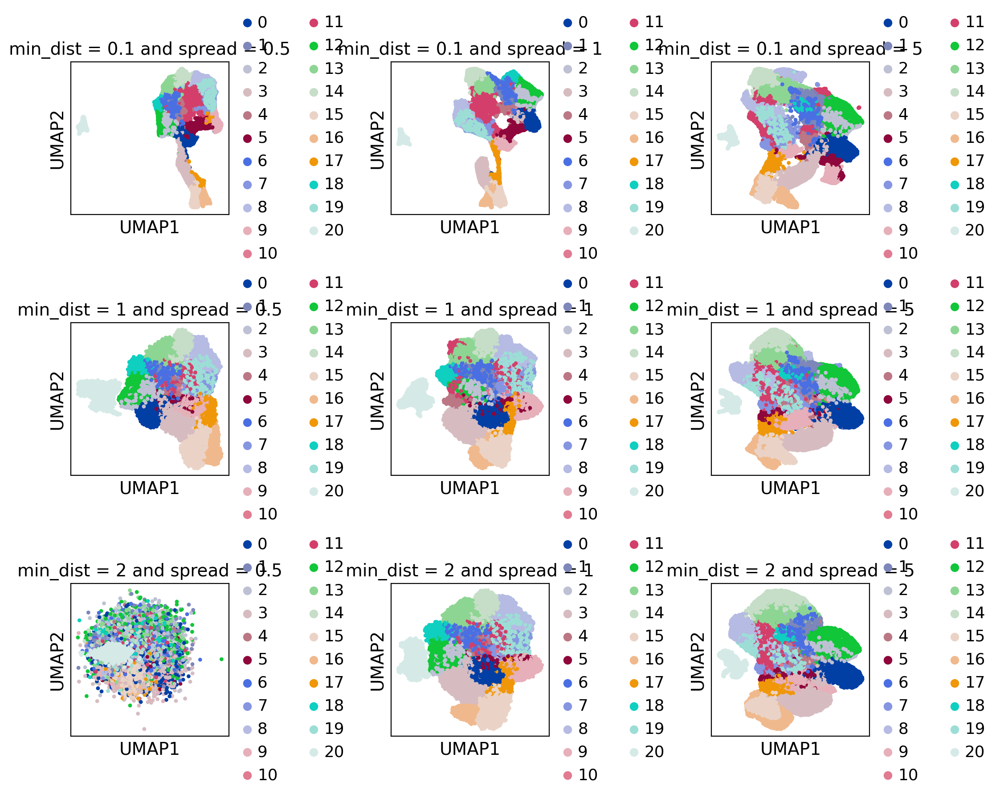

In [100]:
#UMAP layout can be modified to make cells located in more tight / disperesed structures
#This can be regulated with sc.tl.umap parameters min_dist and spread

from itertools import product


# Copy adata not to modify UMAP in the original adata object
adata_temp = adata.copy()
# Loop through different umap parameters, recomputting and replotting UMAP for each of them
MIN_DISTS = [0.1, 1, 2]
SPREADS = [0.5, 1, 5]
# Create grid of plots, with a little extra room for the legends
fig, axes = plt.subplots(len(MIN_DISTS), len(SPREADS), figsize=(len(SPREADS) * 3 + 2, len(MIN_DISTS) * 3))

for (i, min_dist), (j, spread) in product(enumerate(MIN_DISTS), enumerate(SPREADS)):
    ax = axes[i][j]
    param_str = " ".join(["min_dist =", str(min_dist), "and spread =", str(spread)])
    # Recompute UMAP with new parameters
    sc.tl.umap(adata_temp, min_dist=min_dist, spread=spread)
    # Create plot, placing it in grid
    sc.pl.umap(
        adata_temp,
        color=["leiden"],
        title=param_str,
        s=40,
        ax=ax,
        show=False,
    )
plt.tight_layout()
plt.show()
plt.close()
del adata_temp


## PAGA

1. Prune PAGA edges

In [101]:
sc.tl.paga(adata, groups="leiden")

/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/seaborn/categorical.py:3399: UserWarning: 23.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/rds/user/bb725/hpc-work/miniforge3/envs/scanpy_env/lib/python3.12/site-packages/seaborn/categorical.py:3399: UserWarning: 26.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


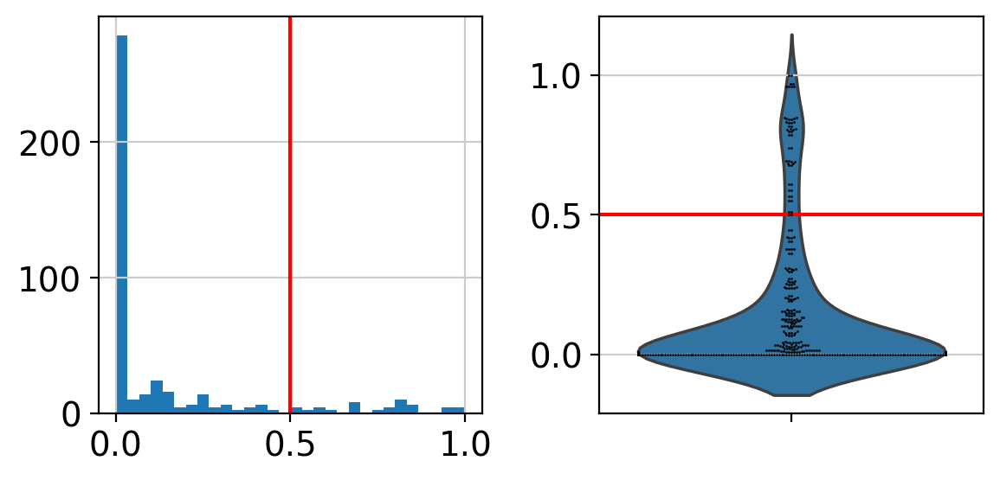

In [103]:
#Remove weak PAGA edges in the plot based on edge weight distribution
#This is based on the assumption that most edge weights will be revlatively weak and that we can tehrefore spot the few most interestign edges as the outliers of the distribution

import matplotlib.pyplot as plt
import seaborn as sns

# make sure PAGA exists (you must have run sc.tl.paga(...) beforehand)
paga_conn = adata.uns["paga"]["connectivities"].toarray().ravel()

fig, axs = plt.subplots(1, 2, figsize=(6, 3))

axs[0].hist(paga_conn, bins=30)

sns.violinplot(y=paga_conn, ax=axs[1], inner=None)
sns.swarmplot(y=paga_conn, ax=axs[1], color="k", size=1)

thr = 0.5
axs[1].axhline(thr, c="r")
axs[0].axvline(thr, c="r")
plt.tight_layout()


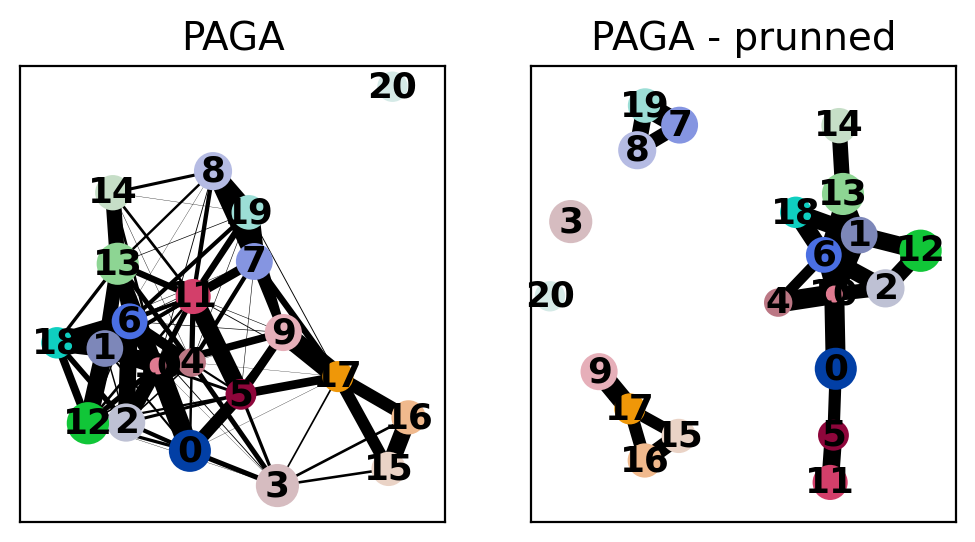

In [104]:
# Compare PAGA with and without prunning
fig, axs = plt.subplots(1, 2, figsize=(6, 3))
sc.pl.paga(adata, ax=axs[0], title="PAGA", show=False)
sc.pl.paga(adata, ax=axs[1], title="PAGA - prunned", threshold=thr)

## PAGA layout

1. PAGA layout corresponfing to UMAP

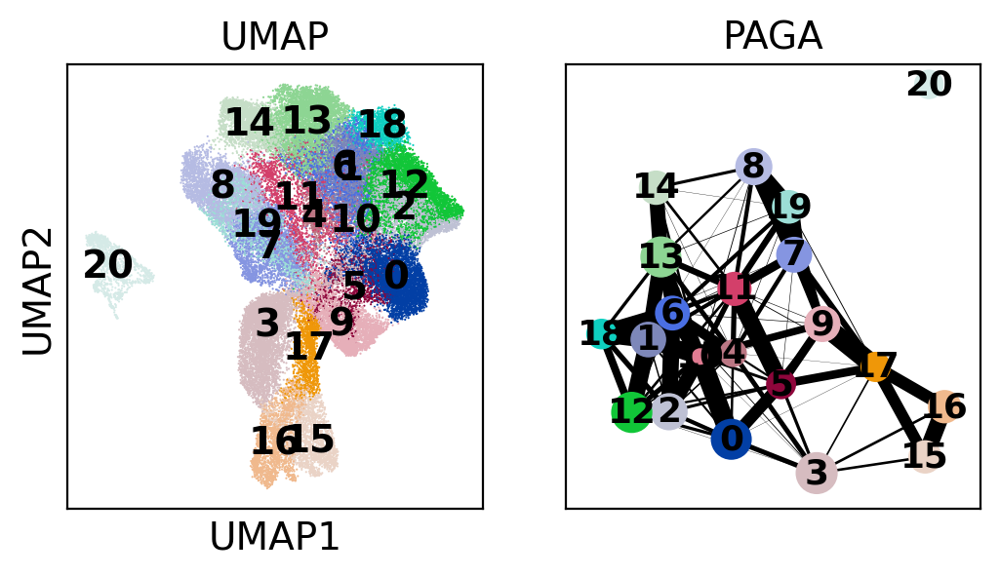

In [105]:
#The layout used in PAGA is optimised to correspond to the PAGA connectivties (edge weights).
#However, sometimes we would wish to have a different layout - use pos argument

#Set PAGA dot centers to the mean of the UMAP embedding values of cells from the corresponding groups
# Compare UMAP and PAGA layouts
fig, axs = plt.subplots(1, 2, figsize=(6, 3))
sc.pl.umap(adata, color="leiden", ax=axs[0], show=False, title="UMAP", legend_loc="on data")
sc.pl.paga(adata, ax=axs[1], title="PAGA")

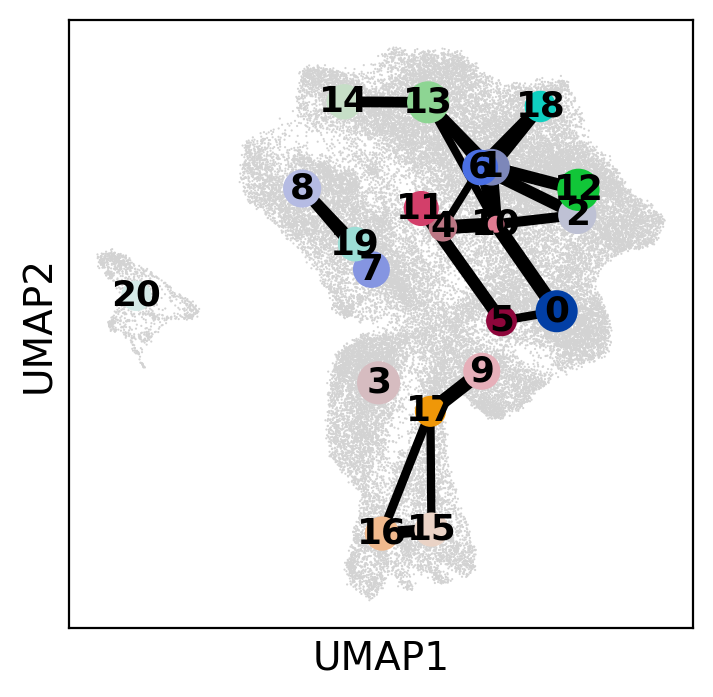

In [106]:
# Define PAGA positions based on the UMAP layout -
# for each cluster we use the mean of the UMAP positions from the cells in that cluster
pos = pd.DataFrame(adata.obsm["X_umap"], index=adata.obs_names)
pos["group"] = adata.obs[adata.uns["paga"]["groups"]]
pos = pos.groupby("group", observed=True).mean()

# Plot UMAP in the background
ax = sc.pl.umap(adata, show=False)
# Plot PAGA ontop of the UMAP
sc.pl.paga(
    adata,
    color="leiden",
    threshold=thr,
    node_size_scale=1,
    edge_width_scale=0.7,
    pos=pos.values,
    random_state=0,
    ax=ax,
)